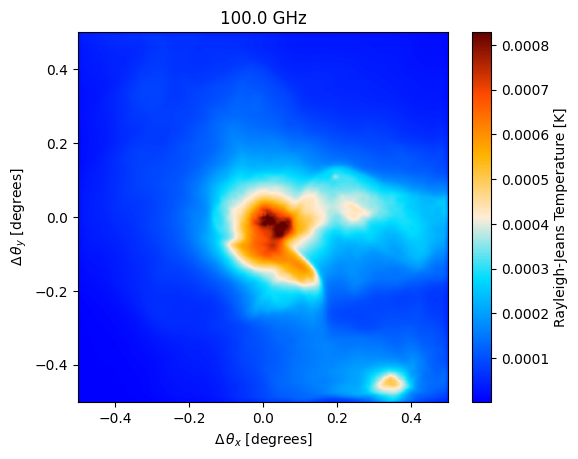

In [1]:
import scipy as sp
import numpy as np
import matplotlib.pyplot as plt
import maria

import jax.numpy as jnp

map_filename = maria.io.fetch("maps/big_cluster.fits")

# load in the map from a fits file
input_map = maria.map.read_fits(filename=map_filename,
                                width=1., #degrees
                                index=1,
                                center=(300.0, -10.0), #RA and Dec in degrees
                                units ='Jy/pixel'
                               )

input_map.to(units="K_RJ").plot()

In [2]:
import jax
jax.__version__

'0.4.30'

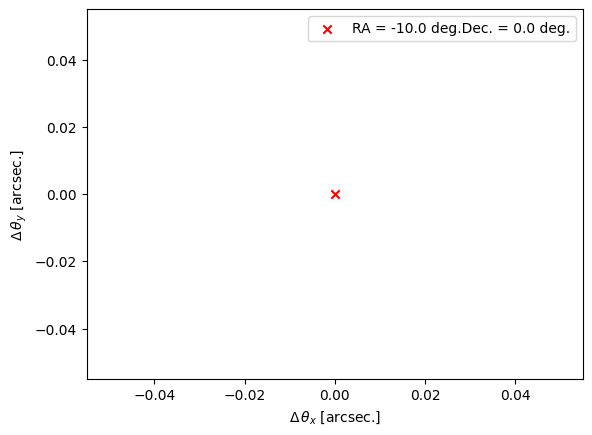

In [3]:
# MUSTANG:
# plan = maria.get_plan(scan_pattern="daisy", # scanning pattern
#                       scan_options={"radius": 0.05, "speed": 0.01}, # in degrees
#                       duration=600, # integration time in seconds
#                       sample_rate=50, # in Hz
#                       scan_center=(150, 10), # position in the sky
#                       frame="ra_dec")

# ATLAST:
plan = maria.get_plan(scan_pattern="stare",
                      scan_options={},
                    #   scan_options={"radius": 0.25, "speed": 0.5}, # in degrees
                      # scan_options={"radius": 2.0, "speed": 1.5}, # in degrees
                      duration=3, # in seconds
                      # sample_rate=225, # in Hz
                      sample_rate=100,
                      start_time = "2022-08-10T06:00:00",
                      scan_center=(-10., 0.),
                      frame="ra_dec")

plan.plot()

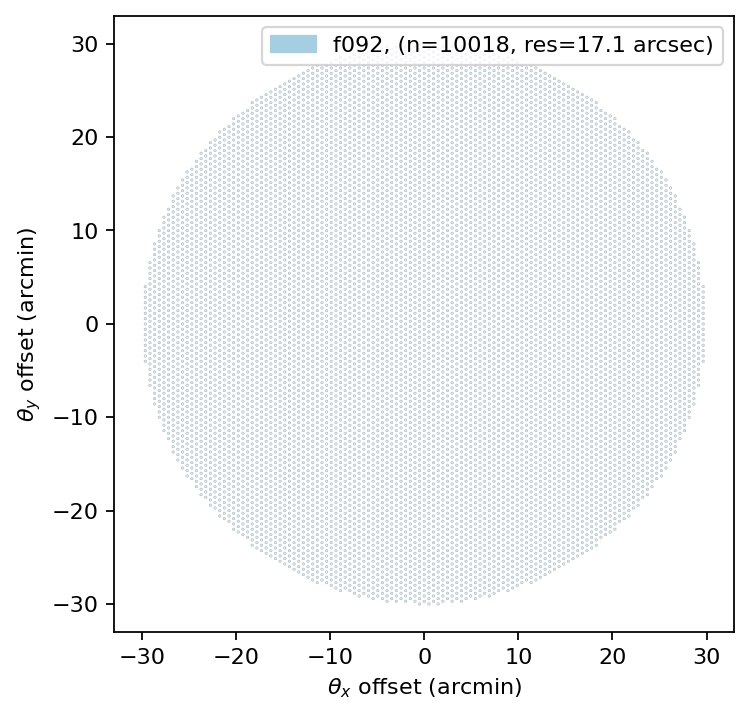

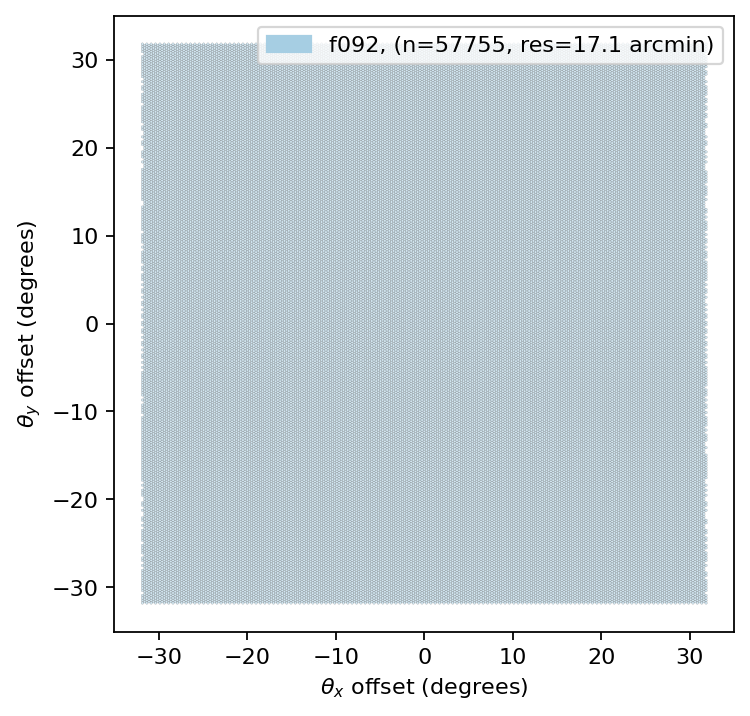

In [4]:
# # MUSTANG:
# # instrument = maria.get_instrument('MUSTANG-2')

# #ATLAST
# from maria.instrument import Band

# f090 = Band(center=92, # in GHz
#             width=40.0,
#             knee=1,
#             sensitivity=6e-5) # in K sqrt(s)

# # array = {"field_of_view": 1.0, "bands": [f090]}
# # array = {"field_of_view": 60.0, "bands": [f090], 'n': 10018}
# array = {"field_of_view": 60.0, "bands": [f090], 'n': 200**2}
# # instrument = maria.get_instrument(array=array, primary_size=50, beam_spacing = 2)
# # instrument = maria.get_instrument(array=array, primary_size=1, beam_spacing = 2)
# instrument = maria.get_instrument(array=array, primary_size=1.5, beam_spacing = 2, array_shape='square')

# instrument.plot()
# instrument.description

from maria.instrument import Band

f090 = Band(center=92, # in GHz
            width=40.0,
            knee=1,
            sensitivity=6e-5) # in K sqrt(s)

instrument = maria.get_instrument(array={"field_of_view": 1.0, "bands": [f090]}, primary_size=50, beam_spacing = 2)
instrument.plot()
# instrument = maria.get_instrument(array={"field_of_view": 1.0/2.*3., "bands": [f090]}, primary_size=50, beam_spacing = 0.5, array_shape="square")
# instrument.plot()
instrument = maria.get_instrument(array={"field_of_view": 1.0/2.*3.*60., "bands": [f090]}, primary_size=50/60., beam_spacing = 1.0, array_shape="square")
instrument.plot()

In [5]:
sim = maria.Simulation(instrument, 
                       plan=plan,
                       site="llano_de_chajnantor", 
                    #    map=input_map,
                       noise=False,
                       atmosphere="2d",
                    #    cmb="generate",
                      )

tod = sim.run()

2024-08-05 11:36:22.764 INFO: Constructed instrument.
2024-08-05 11:36:22.765 INFO: Constructed plan.
2024-08-05 11:36:22.766 INFO: Constructed site.
2024-08-05 11:36:23.280 INFO: Constructed boresight.
2024-08-05 11:36:23.618 INFO: Constructed offsets.


Initialized base in 854 ms.


Initializing atmospheric layers: 100%|██████████| 4/4 [00:02<00:00,  1.77it/s]
Generating atmosphere: 0it [00:00, ?it/s]

self.boresight.time shape: (300,)
layer.sample() shape: (57755, 60)


Generating atmosphere: 1it [00:00,  1.60it/s]

self.boresight.time shape: (300,)
layer.sample() shape: (57755, 60)


Generating atmosphere: 2it [00:01,  1.69it/s]

self.boresight.time shape: (300,)
layer.sample() shape: (57755, 60)


Generating atmosphere: 3it [00:01,  1.72it/s]

self.boresight.time shape: (300,)
layer.sample() shape: (57755, 60)


Generating atmosphere: 4it [00:02,  1.72it/s]


turbulence.shape: (4, 57755, 300)


Computing atm. emission (f092):   0%|          | 0/1 [00:00<?, ?it/s]

det_power_grid shape: (10, 3, 9)


Computing atm. emission (f092): 100%|██████████| 1/1 [00:04<00:00,  4.48s/it]


Emission data['atmosphere'] shape: (57755, 300)


Computing atm. transmission (f092): 100%|██████████| 1/1 [00:04<00:00,  4.47s/it]


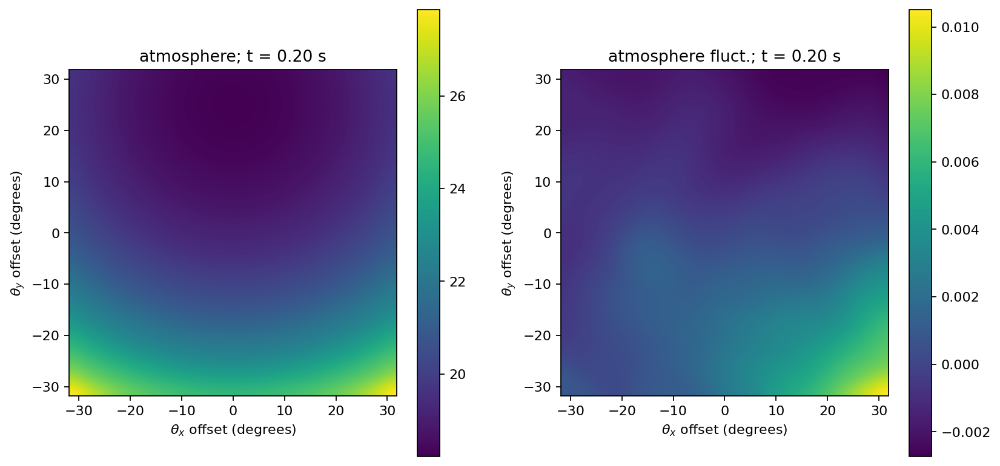

In [6]:
from matplotlib.collections import EllipseCollection
from matplotlib.patches import Patch
import matplotlib.colors as mcolors
# import matplotlib.cm as cm

from maria.tod.coords import Angle

import matplotlib as mpl
from matplotlib.colors import ListedColormap
import matplotlib.pyplot as plt
from scipy.interpolate import RegularGridInterpolator
from scipy.interpolate import LinearNDInterpolator
import scipy.ndimage as ndimage

cmb_cmap = plt.get_cmap('cmb')

fwhms = Angle(instrument.fwhm)
offsets = Angle(instrument.offsets)
atmosphere = tod.components['atmosphere']
time = tod.time.compute()

for iub, uband in enumerate(instrument.ubands):
    band_mask = instrument.dets.band_name == uband
   
    # atmosphere -= np.mean(atmosphere, axis=1).reshape(len(atmosphere), 1)
    # atmosphere -= np.mean(atmosphere, axis=0).reshape(1, atmosphere.shape[1])

    x, y = getattr(offsets, offsets.units)[band_mask].T
    # cols = atmosphere[:, timestep]

# interpol = LinearNDInterpolator( (x, y), cols, fill_value=np.mean(cols))
interpol = LinearNDInterpolator( (x, y), atmosphere, fill_value=np.mean(atmosphere))

# xpix = np.linspace(x.min(), x.max(), 1000)
# ypix = np.linspace(y.min(), y.max(), 1000)
imdims = (200, 200)
xpix = np.linspace(x.min(), x.max(), imdims[0])
ypix = np.linspace(y.min(), y.max(), imdims[1])


xv, yv = np.meshgrid(xpix, ypix)
image = interpol(xv,yv)

# Apply gaussian filter on every image:
for timestep in range(image.shape[2]):
    image[:,:,timestep] = ndimage.gaussian_filter(image[:,:,timestep], (imdims[0]//50, imdims[1]//50))

def plot_time(axes, image, addtext= "data", timestep=0):

        imvals = np.flip(image[:,:,timestep], axis=0)
    
        im0 = axes[0].imshow(imvals, extent=(x.min(), x.max(), y.min(), y.max()))
        axes[0].set_xlabel(rf"$\theta_x$ offset ({offsets.units})")
        axes[0].set_ylabel(rf"$\theta_y$ offset ({offsets.units})")
        axes[0].set_title(f"{addtext}; t = {time[timestep]:.2f} s")
      
        image_fluct = image - np.mean(image, axis=2, keepdims=True)
        imvals_fluct = np.flip(image_fluct[:,:,timestep], axis=0)
        im1 = axes[1].imshow(imvals_fluct, extent=(x.min(), x.max(), y.min(), y.max()))
        axes[1].set_xlabel(rf"$\theta_x$ offset ({offsets.units})")
        axes[1].set_ylabel(rf"$\theta_y$ offset ({offsets.units})")
        axes[1].set_title(f"{addtext} fluct.; t = {time[timestep]:.2f} s")
      
        return im0, im1
  
fig, axes = plt.subplots(1, 2, figsize=(12, 6), dpi=160)   
im0, im1 = plot_time(axes, image, addtext='atmosphere', timestep=20)
fig.colorbar(im0)
fig.colorbar(im1)

In [7]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
import io

# Generate and capture individual frames
# num_frames = data.shape[0]
# num_frames = 1000
# nskip = 10
num_frames = atmosphere.shape[1]
# nskip = num_frames//25
nskip = 1

print("num_frames", num_frames)

def makegif(image, label):
    # Create a list to hold the frames
    frames = []

    for i in range(0, num_frames, nskip):
        print(f"Making plot for timestep: {i} out of {num_frames} ({i/num_frames*100:.2f} %)")
        fig, axes = plt.subplots(1, 2, figsize=(12, 6), dpi=160) 
        im0, im1 = plot_time(axes, image, timestep=i, addtext=label)
        fig.colorbar(im0)
        fig.colorbar(im1)
        
        # Capture the plot as an image in memory
        buf = io.BytesIO()
        plt.savefig(buf, format='png')
        plt.close(fig)
        
        # Create an image from the buffer
        buf.seek(0)
        img = Image.open(buf)
        frames.append(img)

    # Save the frames as a GIF
    # frames[0].save('testgif_atmosphere.gif', save_all=True, append_images=frames[1:], duration=1, loop=0)
    frames[0].save(f'{label}_smooth.gif', save_all=True, append_images=frames[1:], duration=1, loop=0, dpi="figure")

num_frames 300


In [8]:
makegif(image, label="atmosphere")

Making plot for timestep: 0 out of 300 (0.00 %)
Making plot for timestep: 1 out of 300 (0.33 %)
Making plot for timestep: 2 out of 300 (0.67 %)
Making plot for timestep: 3 out of 300 (1.00 %)
Making plot for timestep: 4 out of 300 (1.33 %)
Making plot for timestep: 5 out of 300 (1.67 %)
Making plot for timestep: 6 out of 300 (2.00 %)
Making plot for timestep: 7 out of 300 (2.33 %)
Making plot for timestep: 8 out of 300 (2.67 %)
Making plot for timestep: 9 out of 300 (3.00 %)
Making plot for timestep: 10 out of 300 (3.33 %)
Making plot for timestep: 11 out of 300 (3.67 %)
Making plot for timestep: 12 out of 300 (4.00 %)
Making plot for timestep: 13 out of 300 (4.33 %)
Making plot for timestep: 14 out of 300 (4.67 %)
Making plot for timestep: 15 out of 300 (5.00 %)
Making plot for timestep: 16 out of 300 (5.33 %)
Making plot for timestep: 17 out of 300 (5.67 %)
Making plot for timestep: 18 out of 300 (6.00 %)
Making plot for timestep: 19 out of 300 (6.33 %)
Making plot for timestep: 20 o

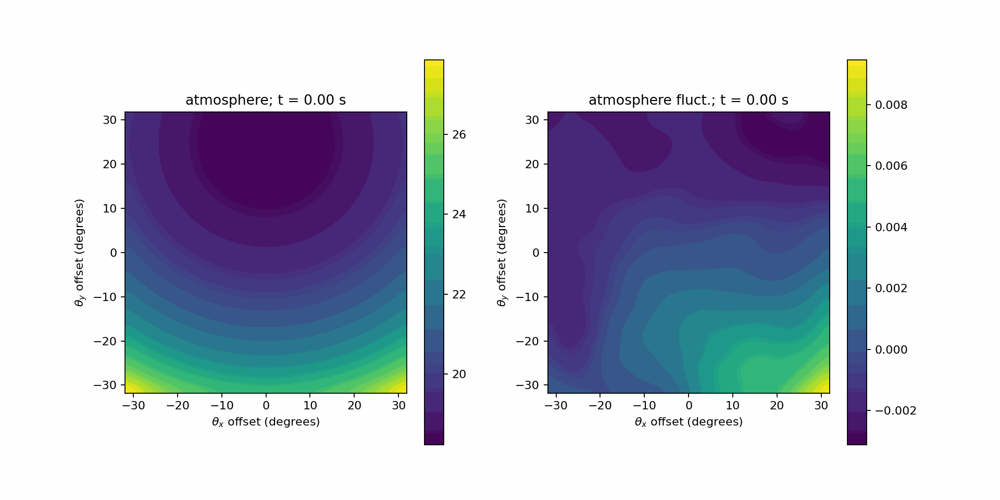

In [9]:
from IPython.display import Image as IPImage, display

display(IPImage(open('atmosphere_smooth.gif', 'rb').read()))

## Next, try to fit the atmosphere image for t=0

In [10]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '2'

import jax
import nifty8.re as jft
import matplotlib.pyplot as plt

from jax import random

seed = 42
key = random.PRNGKey(seed)

2024-08-05 11:38:37.169 INFO: Unable to initialize backend 'rocm': module 'jaxlib.xla_extension' has no attribute 'GpuAllocatorConfig'
2024-08-05 11:38:37.170 INFO: Unable to initialize backend 'tpu': INTERNAL: Failed to open libtpu.so: libtpu.so: cannot open shared object file: No such file or directory
2024-08-05 11:38:37.206004: W external/xla/xla/service/gpu/nvptx_compiler.cc:765] The NVIDIA driver's CUDA version is 12.4 which is older than the ptxas CUDA version (12.5.82). Because the driver is older than the ptxas version, XLA is disabling parallel compilation, which may slow down compilation. You should update your NVIDIA driver or use the NVIDIA-provided CUDA forward compatibility packages.


In [11]:
# numsteps = 100
numsteps = 300
indata = np.float64(image[:,:,:numsteps])
# indata = np.float64(image)
print(indata.shape)
print(indata.mean())

# dims = (1000, 1000)
# dims = indata.shape
dims = indata.shape
print(dims)

# correlated field zero mode GP offset and stddev
# cf_zm_atmos = dict(offset_mean=2.5e-3, offset_std=(5e-4, 5e-4))
cf_zm_atmos = dict(offset_mean=np.abs(indata.mean()), offset_std=(np.abs(indata.mean()/3.), np.abs(indata.mean()/3.)))
# correlated field fluctuations (mostly don't need tuning)
cf_fl_atmos = dict(
    fluctuations=(1e-3, 1e-4), # fluctuations: y-offset in power spectrum in fourier space (zero mode)
    loglogavgslope=(-3e0, 5e-1), # power-spectrum slope in log-log space in frequency domain (Fourier space) Jakob: -4 -- -2
    flexibility=None,
    asperity=None,
    # flexibility=(1.5e0, 5e-1), # deviation from simple power-law
    # asperity=(5e-1, 5e-2), # small scale features in power-law
)

# put together in correlated field model
cfm_atmos = jft.CorrelatedFieldMaker("cfatmos")
cfm_atmos.set_amplitude_total_offset(**cf_zm_atmos)
cfm_atmos.add_fluctuations(
    dims, distances=1.0 / dims[0], **cf_fl_atmos, prefix="ax1", non_parametric_kind="power"
)
gp_atmos = cfm_atmos.finalize()

(200, 200, 300)
20.487282923417744
(200, 200, 300)


In [12]:
# Define simple signal model with added map sampling
class Signal_atmos(jft.Model):
    def __init__(self, gp_atmos):
        self.gp_atmos = gp_atmos
        super().__init__(init=self.gp_atmos.init, domain=jft.Vector(gp_atmos.domain))

    def __call__(self, x):
        return self.gp_atmos(x)
  
signal_response_atmos = Signal_atmos(gp_atmos)

# Define noise covariance
noise_cov_inv_atmos = lambda x: 1e-4**-2 * x

# Combine in likelihood
lh = jft.Gaussian( indata, noise_cov_inv_atmos).amend(signal_response_atmos)

assuming a diagonal covariance matrix;
setting `std_inv` to `cov_inv(ones_like(data))**0.5`


# MAP fit

In [13]:
n_it = 1
delta = 1e-4

n_samples = 0 # no samples -> maximum aposteriory posterior

key, k_i, k_o = random.split(key, 3)

samples, state = jft.optimize_kl(
    lh, # likelihood
    jft.Vector(lh.init(k_i)), # initial position in model space (initialisation)
    n_total_iterations=n_it, # no of optimisation steps (global)
    n_samples=n_samples, # draw samples
    key=k_o, # random jax init
    draw_linear_kwargs=dict( # sampling parameters
        cg_name="SL",
        cg_kwargs=dict(absdelta=delta * jft.size(lh.domain) / 10.0, maxiter=60),
    ),
    nonlinearly_update_kwargs=dict( # map from multivariate gaussian to more compl. distribution (coordinate transformations)
        minimize_kwargs=dict(
            name="SN",
            xtol=delta,
            cg_kwargs=dict(name=None),
            maxiter=5,
        )
    ),
    kl_kwargs=dict( # shift transformed multivar gauss to best match true posterior
        minimize_kwargs=dict(
            # name="M", xtol=delta, cg_kwargs=dict(name=None), maxiter=60 # map
            name="M", xtol=delta, cg_kwargs=dict(name=None), maxiter=100 # map
        )
    ),
    sample_mode="nonlinear_resample", # how steps are combined (samples + nonlin + KL)
)

OPTIMIZE_KL: Starting 0001
M: →:1.0 ↺:False #∇²:06 |↘|:8.940383e+04 ➽:1.200000e+03
M: Iteration 1 ⛰:+2.590272e+15 Δ⛰:1.891019e+15
M: →:1.0 ↺:False #∇²:12 |↘|:9.639365e+06 ➽:1.200000e+03
M: Iteration 2 ⛰:+2.585044e+15 Δ⛰:5.228012e+12
M: →:1.0 ↺:False #∇²:18 |↘|:1.274765e+05 ➽:1.200000e+03
M: Iteration 3 ⛰:+4.718446e+14 Δ⛰:2.113199e+15
M: →:0.5 ↺:False #∇²:24 |↘|:3.851002e+03 ➽:1.200000e+03
M: Iteration 4 ⛰:+4.557477e+14 Δ⛰:1.609698e+13
M: →:0.5 ↺:False #∇²:30 |↘|:1.854429e+04 ➽:1.200000e+03
M: Iteration 5 ⛰:+4.355174e+14 Δ⛰:2.023031e+13
M: →:1.0 ↺:False #∇²:36 |↘|:1.752492e+04 ➽:1.200000e+03
M: Iteration 6 ⛰:+3.423628e+14 Δ⛰:9.315453e+13
M: →:1.0 ↺:False #∇²:42 |↘|:2.637458e+04 ➽:1.200000e+03
M: Iteration 7 ⛰:+2.462563e+14 Δ⛰:9.610654e+13
M: →:1.0 ↺:False #∇²:48 |↘|:4.244913e+04 ➽:1.200000e+03
M: Iteration 8 ⛰:+1.374794e+14 Δ⛰:1.087769e+14
M: →:1.0 ↺:False #∇²:54 |↘|:6.755580e+04 ➽:1.200000e+03
M: Iteration 9 ⛰:+3.490892e+13 Δ⛰:1.025705e+14
M: →:1.0 ↺:False #∇²:60 |↘|:4.803528e+04 ➽:1.2

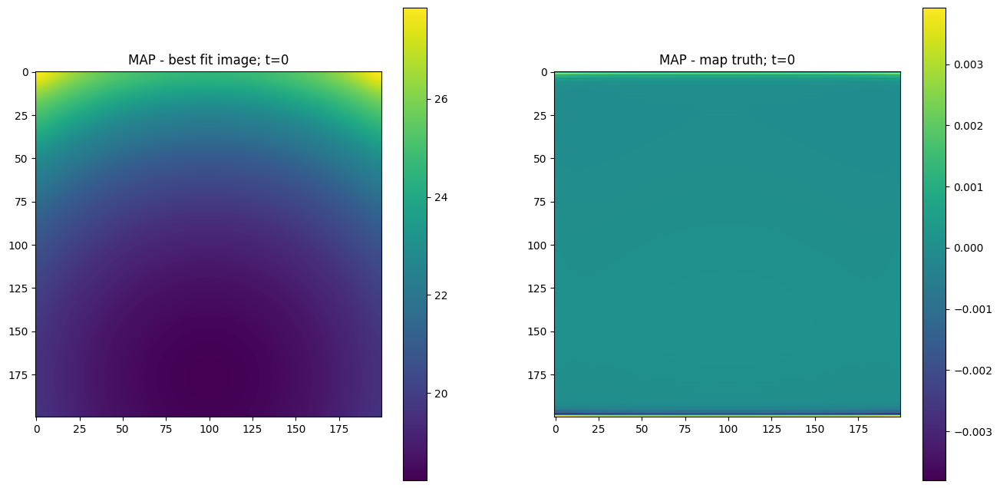

In [14]:
# plot maximum of posterior (mode)
# sig_map = signal_response(samples.pos) # gives time-series
sig_map = gp_atmos(samples.pos) # when splitting up in different field models

fig, axes = plt.subplots(1, 2, figsize=(16, 8))

im0 = axes[0].imshow(sig_map[:,:,0])
axes[0].title.set_text('MAP - best fit image; t=0')
fig.colorbar(im0)

im1 = axes[1].imshow( sig_map[:,:,0] - indata[:,:,0] )
axes[1].title.set_text('MAP - map truth; t=0')
# im1 = axes[1].imshow( (sig_map - mapdata_truth) )
# axes[1].title.set_text('diff prediction - map truth')
fig.colorbar(im1)

plt.show()

# Fill nifty fit

OPTIMIZE_KL: Starting 0001
SL: Iteration 0 ⛰:+4.3604e+16 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+5.4408e+08 Δ⛰:4.3604e+16 ➽:1.2000e+02
SL: Iteration 2 ⛰:+5.2138e+08 Δ⛰:2.2699e+07 ➽:1.2000e+02
SL: Iteration 3 ⛰:+5.2138e+08 Δ⛰:4.6660e+00 ➽:1.2000e+02
SL: Iteration 4 ⛰:+5.0751e+08 Δ⛰:1.3867e+07 ➽:1.2000e+02
SL: Iteration 5 ⛰:+5.0751e+08 Δ⛰:4.6226e+03 ➽:1.2000e+02
SL: Iteration 6 ⛰:+4.9504e+08 Δ⛰:1.2467e+07 ➽:1.2000e+02
SL: Iteration 7 ⛰:+4.8402e+08 Δ⛰:1.1020e+07 ➽:1.2000e+02
SL: Iteration 8 ⛰:+4.8402e+08 Δ⛰:1.3570e+01 ➽:1.2000e+02
SL: Iteration 0 ⛰:+4.1510e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+5.0805e+08 Δ⛰:4.1510e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+5.0475e+08 Δ⛰:3.3011e+06 ➽:1.2000e+02
SL: Iteration 3 ⛰:+5.0475e+08 Δ⛰:8.0154e+00 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.9990e+08 Δ⛰:4.8499e+06 ➽:1.2000e+02
SL: Iteration 5 ⛰:+4.9987e+08 Δ⛰:2.2264e+04 ➽:1.2000e+02
SL: Iteration 6 ⛰:+4.9142e+08 Δ⛰:8.4541e+06 ➽:1.2000e+02
SL: Iteration 7 ⛰:+4.8079e+08 Δ⛰:1.0633e+07 ➽:1.2000e+02
SL: Iteration 8 ⛰:

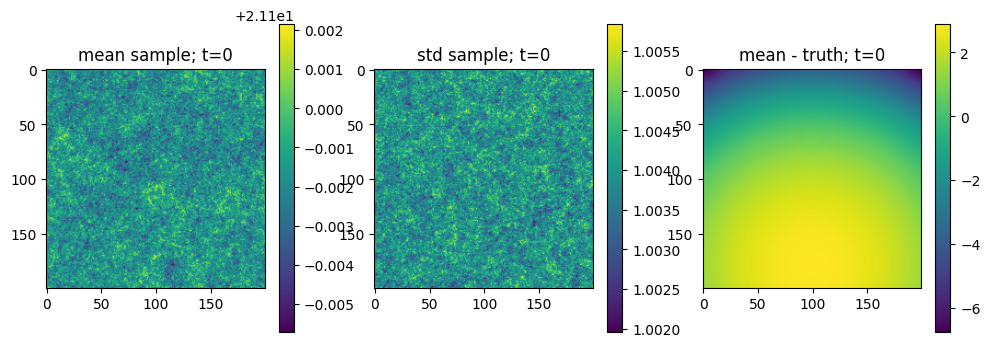

OPTIMIZE_KL: Starting 0002
SL: Iteration 0 ⛰:+1.2314e+16 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+5.5166e+08 Δ⛰:1.2314e+16 ➽:1.2000e+02
SL: Iteration 2 ⛰:+5.0894e+08 Δ⛰:4.2724e+07 ➽:1.2000e+02
SL: Iteration 3 ⛰:+5.0894e+08 Δ⛰:8.0224e-02 ➽:1.2000e+02
SL: Iteration 4 ⛰:+5.0349e+08 Δ⛰:5.4472e+06 ➽:1.2000e+02
SL: Iteration 5 ⛰:+5.0327e+08 Δ⛰:2.2216e+05 ➽:1.2000e+02
SL: Iteration 6 ⛰:+4.9416e+08 Δ⛰:9.1077e+06 ➽:1.2000e+02
SL: Iteration 7 ⛰:+4.7975e+08 Δ⛰:1.4405e+07 ➽:1.2000e+02
SL: Iteration 8 ⛰:+4.7975e+08 Δ⛰:1.1850e+00 ➽:1.2000e+02
SL: Iteration 0 ⛰:+5.4811e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+5.3969e+08 Δ⛰:5.4811e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+5.0438e+08 Δ⛰:3.5308e+07 ➽:1.2000e+02
SL: Iteration 3 ⛰:+5.0438e+08 Δ⛰:2.2843e-01 ➽:1.2000e+02
SL: Iteration 4 ⛰:+5.0115e+08 Δ⛰:3.2315e+06 ➽:1.2000e+02
SL: Iteration 5 ⛰:+5.0114e+08 Δ⛰:8.3056e+03 ➽:1.2000e+02
SL: Iteration 6 ⛰:+4.8838e+08 Δ⛰:1.2762e+07 ➽:1.2000e+02
SL: Iteration 7 ⛰:+4.8203e+08 Δ⛰:6.3493e+06 ➽:1.2000e+02
SL: Iteration 8 ⛰:

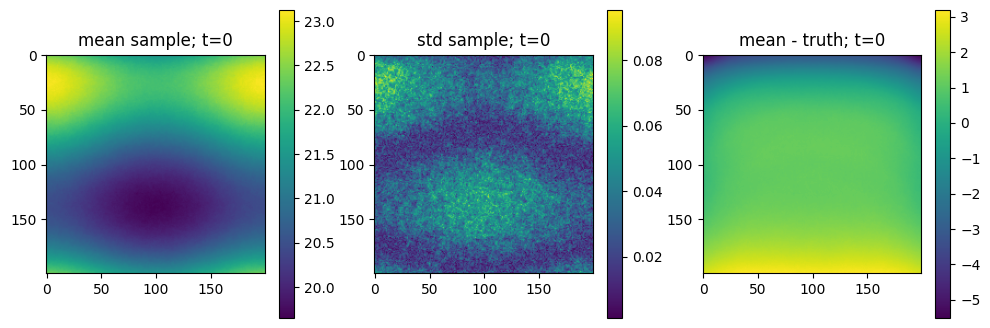

OPTIMIZE_KL: Starting 0003
SL: Iteration 0 ⛰:+1.4523e+17 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.2713e+15 Δ⛰:1.4396e+17 ➽:1.2000e+02
SL: Iteration 2 ⛰:+2.0769e+11 Δ⛰:1.2711e+15 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.9489e+11 Δ⛰:1.2792e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.9489e+11 Δ⛰:9.8085e+01 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.9015e+11 Δ⛰:4.7413e+09 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.9015e+11 Δ⛰:8.3231e+05 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.8780e+11 Δ⛰:2.3556e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.8780e+11 Δ⛰:2.5171e+04 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.8307e+11 Δ⛰:4.7275e+09 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.8307e+11 Δ⛰:4.9939e+03 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.8188e+11 Δ⛰:1.1926e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.7815e+11 Δ⛰:3.7297e+09 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.7355e+11 Δ⛰:4.5981e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.7355e+11 Δ⛰:5.0206e+04 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.7355e+11 Δ⛰:2.0762e+06 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.6993e+11 Δ⛰:3.6164e+09 ➽:1.2000e+02
SL: 

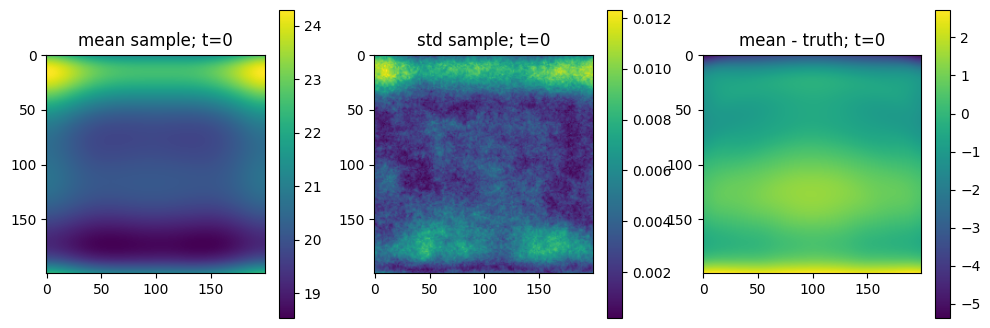

OPTIMIZE_KL: Starting 0004
SL: Iteration 0 ⛰:+7.3266e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.3684e+13 Δ⛰:4.9582e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+7.8096e+12 Δ⛰:1.5875e+13 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.3452e+10 Δ⛰:7.7862e+12 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.0056e+10 Δ⛰:1.3397e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+9.7419e+09 Δ⛰:3.1363e+08 ➽:1.2000e+02
SL: Iteration 6 ⛰:+6.7670e+09 Δ⛰:2.9749e+09 ➽:1.2000e+02
SL: Iteration 7 ⛰:+6.2488e+09 Δ⛰:5.1813e+08 ➽:1.2000e+02
SL: Iteration 8 ⛰:+6.2441e+09 Δ⛰:4.6963e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+6.2439e+09 Δ⛰:2.8782e+05 ➽:1.2000e+02
SL: Iteration 10 ⛰:+5.3740e+09 Δ⛰:8.6983e+08 ➽:1.2000e+02
SL: Iteration 11 ⛰:+4.9615e+09 Δ⛰:4.1254e+08 ➽:1.2000e+02
SL: Iteration 12 ⛰:+4.1670e+09 Δ⛰:7.9448e+08 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.6415e+09 Δ⛰:5.2546e+08 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.6307e+09 Δ⛰:1.0821e+07 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.6261e+09 Δ⛰:4.5917e+06 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.6257e+09 Δ⛰:4.3507e+05 ➽:1.2000e+02
SL: 

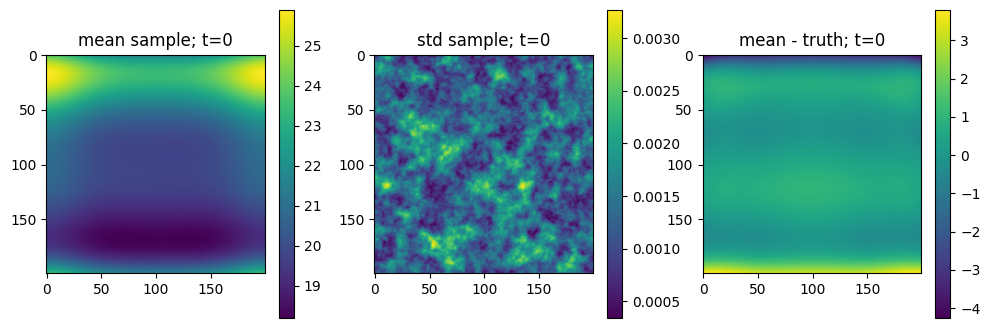

OPTIMIZE_KL: Starting 0005
SL: Iteration 0 ⛰:+2.4578e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+3.3265e+12 Δ⛰:2.1252e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+9.4551e+11 Δ⛰:2.3810e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.3064e+10 Δ⛰:9.0244e+11 ➽:1.2000e+02
SL: Iteration 4 ⛰:+8.3761e+09 Δ⛰:3.4687e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+7.6246e+09 Δ⛰:7.5149e+08 ➽:1.2000e+02
SL: Iteration 6 ⛰:+5.4880e+09 Δ⛰:2.1366e+09 ➽:1.2000e+02
SL: Iteration 7 ⛰:+5.4819e+09 Δ⛰:6.1438e+06 ➽:1.2000e+02
SL: Iteration 8 ⛰:+5.4818e+09 Δ⛰:1.0887e+05 ➽:1.2000e+02
SL: Iteration 9 ⛰:+5.3539e+09 Δ⛰:1.2786e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+4.0011e+09 Δ⛰:1.3528e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.0366e+09 Δ⛰:9.6455e+08 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.5130e+09 Δ⛰:5.2357e+08 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.4491e+09 Δ⛰:6.3874e+07 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.4488e+09 Δ⛰:2.7594e+05 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.9287e+09 Δ⛰:5.2010e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.9227e+09 Δ⛰:6.0660e+06 ➽:1.2000e+02
SL: 

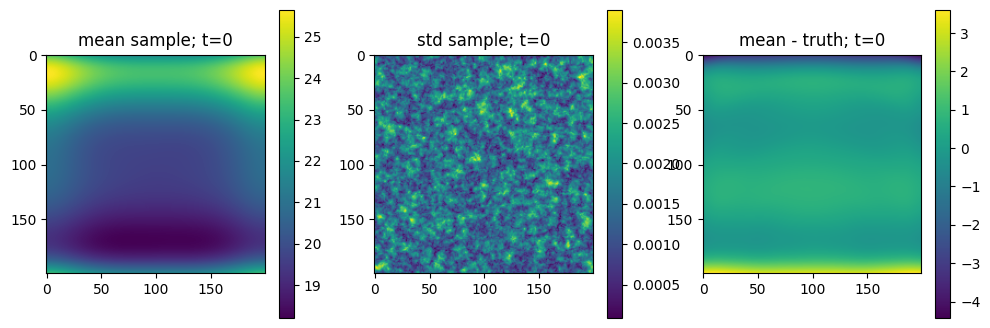

OPTIMIZE_KL: Starting 0006
SL: Iteration 0 ⛰:+7.5821e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.5454e+12 Δ⛰:7.3275e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.8620e+11 Δ⛰:2.3592e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.6947e+10 Δ⛰:1.6925e+11 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.2501e+10 Δ⛰:4.4458e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+7.3158e+09 Δ⛰:5.1855e+09 ➽:1.2000e+02
SL: Iteration 6 ⛰:+6.6287e+09 Δ⛰:6.8709e+08 ➽:1.2000e+02
SL: Iteration 7 ⛰:+6.6275e+09 Δ⛰:1.2163e+06 ➽:1.2000e+02
SL: Iteration 8 ⛰:+6.6270e+09 Δ⛰:4.4386e+05 ➽:1.2000e+02
SL: Iteration 9 ⛰:+6.6239e+09 Δ⛰:3.1557e+06 ➽:1.2000e+02
SL: Iteration 10 ⛰:+5.4410e+09 Δ⛰:1.1829e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+4.2787e+09 Δ⛰:1.1623e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.7154e+09 Δ⛰:5.6332e+08 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.7154e+09 Δ⛰:7.1341e+03 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.7133e+09 Δ⛰:2.1101e+06 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.6876e+09 Δ⛰:2.5649e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.9625e+09 Δ⛰:7.2518e+08 ➽:1.2000e+02
SL: 

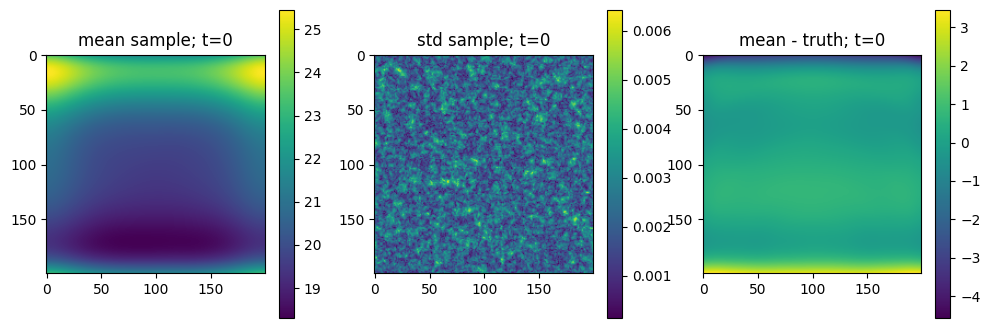

OPTIMIZE_KL: Starting 0007
SL: Iteration 0 ⛰:+1.3247e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.0178e+13 Δ⛰:1.2229e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.2229e+12 Δ⛰:6.9548e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.6418e+10 Δ⛰:3.2065e+12 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.1425e+10 Δ⛰:4.9930e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+9.1865e+09 Δ⛰:2.2384e+09 ➽:1.2000e+02
SL: Iteration 6 ⛰:+9.1864e+09 Δ⛰:7.8666e+04 ➽:1.2000e+02
SL: Iteration 7 ⛰:+8.7421e+09 Δ⛰:4.4435e+08 ➽:1.2000e+02
SL: Iteration 8 ⛰:+8.7207e+09 Δ⛰:2.1423e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+8.6944e+09 Δ⛰:2.6238e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+7.7653e+09 Δ⛰:9.2913e+08 ➽:1.2000e+02
SL: Iteration 11 ⛰:+6.5781e+09 Δ⛰:1.1873e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+6.5750e+09 Δ⛰:3.0138e+06 ➽:1.2000e+02
SL: Iteration 13 ⛰:+5.7925e+09 Δ⛰:7.8253e+08 ➽:1.2000e+02
SL: Iteration 14 ⛰:+5.7661e+09 Δ⛰:2.6460e+07 ➽:1.2000e+02
SL: Iteration 15 ⛰:+5.2622e+09 Δ⛰:5.0381e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+5.2540e+09 Δ⛰:8.2586e+06 ➽:1.2000e+02
SL: 

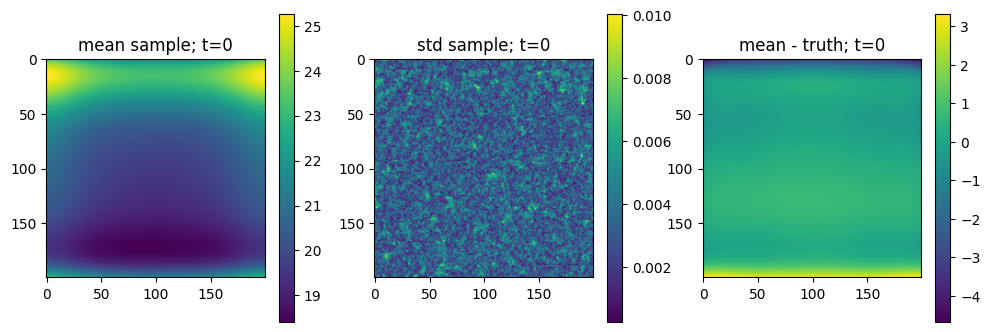

OPTIMIZE_KL: Starting 0008
SL: Iteration 0 ⛰:+6.6638e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+6.0145e+12 Δ⛰:6.0623e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+5.0108e+10 Δ⛰:5.9644e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.1211e+10 Δ⛰:2.8897e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.7755e+10 Δ⛰:3.4566e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.7679e+10 Δ⛰:7.5435e+07 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.4459e+10 Δ⛰:3.2204e+09 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.4426e+10 Δ⛰:3.2768e+07 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.2476e+10 Δ⛰:1.9500e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.2207e+10 Δ⛰:2.6909e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.2207e+10 Δ⛰:3.7566e+05 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.2201e+10 Δ⛰:5.5507e+06 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.1293e+10 Δ⛰:9.0842e+08 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.1292e+10 Δ⛰:2.7250e+05 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.0443e+10 Δ⛰:8.4919e+08 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.0442e+10 Δ⛰:1.1768e+06 ➽:1.2000e+02
SL: Iteration 16 ⛰:+9.6904e+09 Δ⛰:7.5149e+08 ➽:1.2000e+02
SL: 

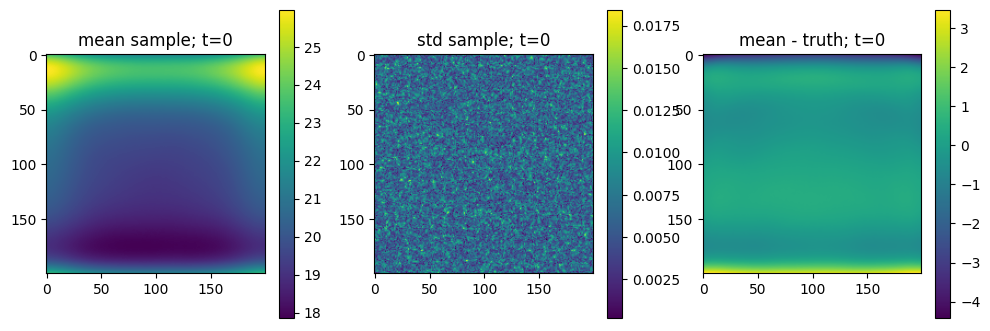

OPTIMIZE_KL: Starting 0009
SL: Iteration 0 ⛰:+1.0839e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.8125e+12 Δ⛰:1.0811e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+5.7796e+10 Δ⛰:2.7547e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+5.2224e+10 Δ⛰:5.5720e+09 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.6002e+10 Δ⛰:6.2218e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+4.6002e+10 Δ⛰:4.6607e+05 ➽:1.2000e+02
SL: Iteration 6 ⛰:+4.1812e+10 Δ⛰:4.1891e+09 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.8624e+10 Δ⛰:3.1887e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.8624e+10 Δ⛰:4.1285e+04 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.8600e+10 Δ⛰:2.3563e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.6446e+10 Δ⛰:2.1545e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.6426e+10 Δ⛰:2.0075e+07 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.5920e+10 Δ⛰:5.0544e+08 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.5920e+10 Δ⛰:3.7466e+05 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.4280e+10 Δ⛰:1.6393e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.2880e+10 Δ⛰:1.4007e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.2880e+10 Δ⛰:4.8472e+03 ➽:1.2000e+02
SL: 

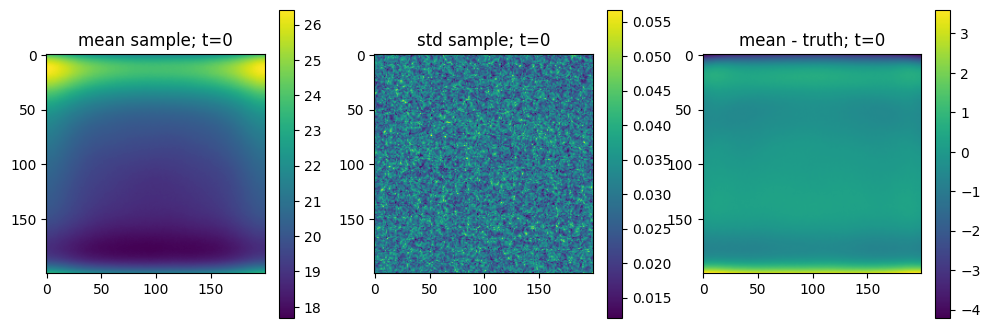

OPTIMIZE_KL: Starting 0010
SL: Iteration 0 ⛰:+1.0643e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+4.0911e+11 Δ⛰:1.0639e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.7480e+11 Δ⛰:2.3432e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.5401e+11 Δ⛰:2.0790e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.5001e+11 Δ⛰:3.9994e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.4996e+11 Δ⛰:4.5620e+07 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.4424e+11 Δ⛰:5.7231e+09 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.4424e+11 Δ⛰:4.8902e+06 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.4017e+11 Δ⛰:4.0648e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.4010e+11 Δ⛰:7.1484e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.3563e+11 Δ⛰:4.4734e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.3562e+11 Δ⛰:7.2277e+06 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.3552e+11 Δ⛰:9.3938e+07 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.3206e+11 Δ⛰:3.4651e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.3206e+11 Δ⛰:8.8293e+05 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.3117e+11 Δ⛰:8.9173e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.2766e+11 Δ⛰:3.5088e+09 ➽:1.2000e+02
SL: 

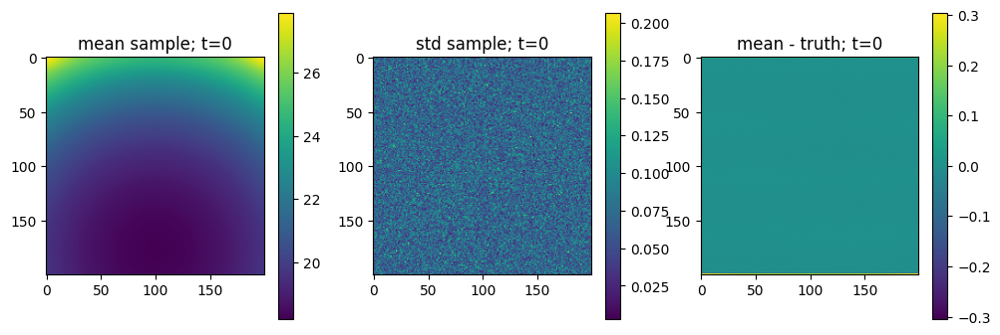

OPTIMIZE_KL: Starting 0011
SL: Iteration 0 ⛰:+1.5438e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+4.1199e+12 Δ⛰:1.1318e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.7365e+12 Δ⛰:3.8340e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.6816e+12 Δ⛰:5.4882e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.6816e+12 Δ⛰:9.4613e+05 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.6262e+12 Δ⛰:5.5399e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.5238e+12 Δ⛰:1.0245e+11 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.5071e+12 Δ⛰:1.6680e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.4198e+12 Δ⛰:8.7315e+10 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.4170e+12 Δ⛰:2.8349e+09 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.2798e+12 Δ⛰:1.3722e+11 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.2798e+12 Δ⛰:7.0444e+04 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.0750e+12 Δ⛰:2.0478e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.8919e+12 Δ⛰:1.8309e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.8919e+12 Δ⛰:3.9830e+04 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.7504e+12 Δ⛰:1.4152e+11 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.6877e+12 Δ⛰:6.2631e+10 ➽:1.2000e+02
SL: 

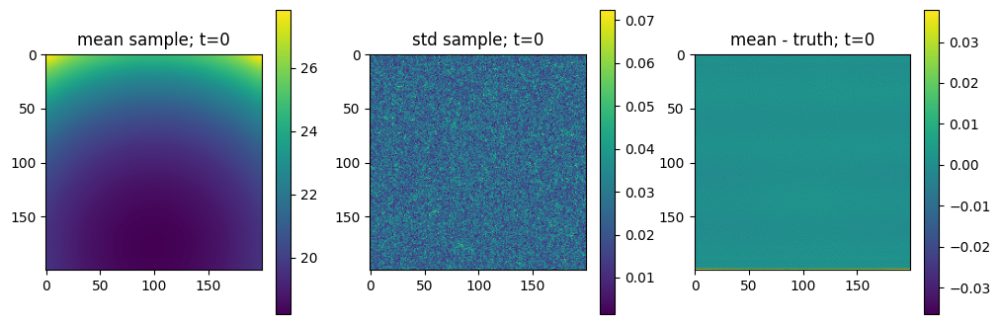

OPTIMIZE_KL: Starting 0012
SL: Iteration 0 ⛰:+9.9354e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+6.0349e+12 Δ⛰:9.8750e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.2655e+12 Δ⛰:1.7693e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.2006e+12 Δ⛰:6.4910e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.2006e+12 Δ⛰:7.2663e+04 ➽:1.2000e+02
SL: Iteration 5 ⛰:+4.0649e+12 Δ⛰:1.3572e+11 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.8844e+12 Δ⛰:1.8055e+11 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.8842e+12 Δ⛰:1.6850e+08 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.8824e+12 Δ⛰:1.7830e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.6554e+12 Δ⛰:2.2704e+11 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.4085e+12 Δ⛰:2.4686e+11 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.4085e+12 Δ⛰:2.9346e+05 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.1750e+12 Δ⛰:2.3349e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.9065e+12 Δ⛰:2.6847e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.9065e+12 Δ⛰:1.2629e+07 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.9045e+12 Δ⛰:2.0071e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.6530e+12 Δ⛰:2.5154e+11 ➽:1.2000e+02
SL: 

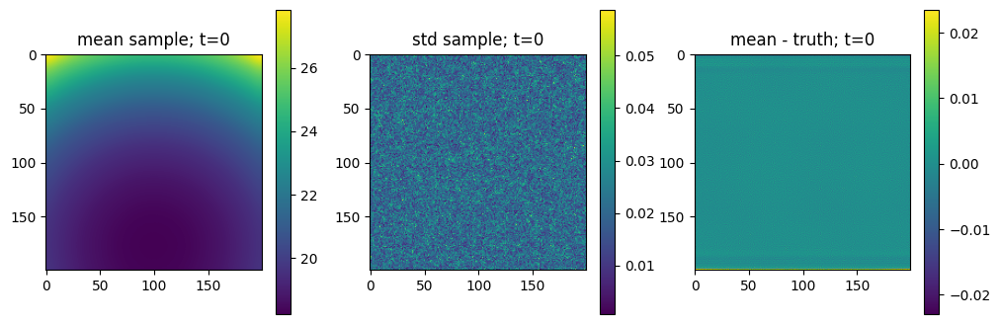

OPTIMIZE_KL: Starting 0013
SL: Iteration 0 ⛰:+3.1259e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+4.3839e+12 Δ⛰:3.0821e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.2355e+12 Δ⛰:1.4841e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.1256e+12 Δ⛰:1.0996e+11 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.1256e+12 Δ⛰:4.0609e+04 ➽:1.2000e+02
SL: Iteration 5 ⛰:+4.0230e+12 Δ⛰:1.0253e+11 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.8235e+12 Δ⛰:1.9953e+11 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.8235e+12 Δ⛰:1.5987e+07 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.6517e+12 Δ⛰:1.7175e+11 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.6069e+12 Δ⛰:4.4874e+10 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.4092e+12 Δ⛰:1.9765e+11 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.4092e+12 Δ⛰:4.3190e+05 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.1645e+12 Δ⛰:2.4474e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.8783e+12 Δ⛰:2.8613e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.8783e+12 Δ⛰:1.1755e+05 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.6639e+12 Δ⛰:2.1441e+11 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.6593e+12 Δ⛰:4.6831e+09 ➽:1.2000e+02
SL: 

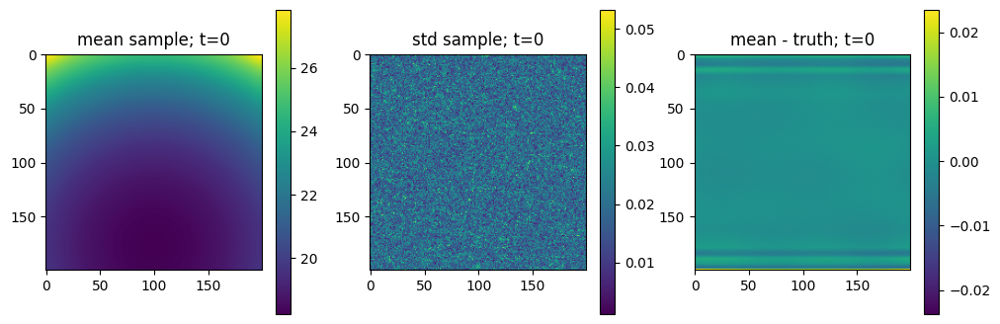

OPTIMIZE_KL: Starting 0014
SL: Iteration 0 ⛰:+2.1215e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+4.1758e+12 Δ⛰:1.7039e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.1662e+12 Δ⛰:9.5351e+09 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.1245e+12 Δ⛰:4.1745e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.1244e+12 Δ⛰:3.5217e+07 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.9809e+12 Δ⛰:1.4357e+11 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.7774e+12 Δ⛰:2.0351e+11 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.7642e+12 Δ⛰:1.3199e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.6384e+12 Δ⛰:1.2577e+11 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.5899e+12 Δ⛰:4.8487e+10 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.3714e+12 Δ⛰:2.1850e+11 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.3714e+12 Δ⛰:1.5155e+05 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.1245e+12 Δ⛰:2.4691e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.8670e+12 Δ⛰:2.5750e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.8670e+12 Δ⛰:6.9961e+05 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.8625e+12 Δ⛰:4.4947e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.6407e+12 Δ⛰:2.2178e+11 ➽:1.2000e+02
SL: 

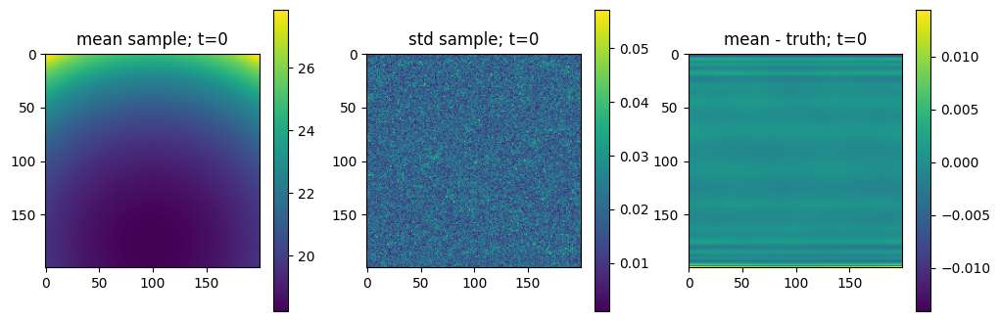

OPTIMIZE_KL: Starting 0015
SL: Iteration 0 ⛰:+5.3620e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+5.3471e+12 Δ⛰:5.3566e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.0933e+12 Δ⛰:1.2539e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.0514e+12 Δ⛰:4.1914e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.0514e+12 Δ⛰:3.5419e+04 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.9190e+12 Δ⛰:1.3240e+11 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.7474e+12 Δ⛰:1.7157e+11 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.7474e+12 Δ⛰:9.4667e+05 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.7453e+12 Δ⛰:2.1076e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.5512e+12 Δ⛰:1.9412e+11 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.3073e+12 Δ⛰:2.4387e+11 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.3073e+12 Δ⛰:5.6007e+05 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.0782e+12 Δ⛰:2.2909e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.8427e+12 Δ⛰:2.3545e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.8427e+12 Δ⛰:5.5168e+05 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.8427e+12 Δ⛰:7.2945e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.6267e+12 Δ⛰:2.1596e+11 ➽:1.2000e+02
SL: 

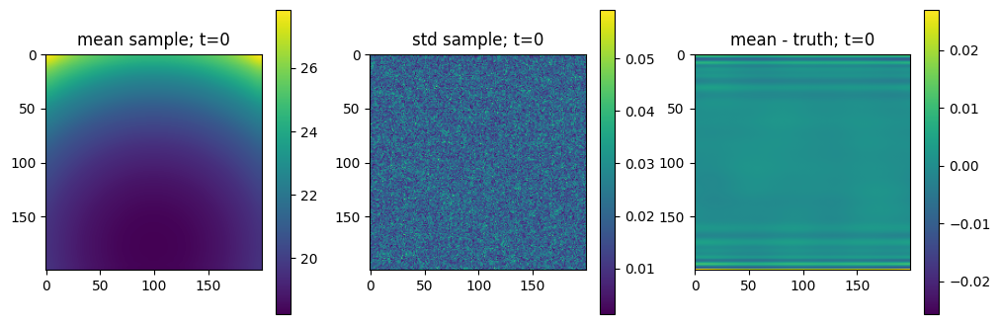

OPTIMIZE_KL: Starting 0016
SL: Iteration 0 ⛰:+5.7392e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+4.1031e+12 Δ⛰:5.3289e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.9060e+12 Δ⛰:1.9718e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.8646e+12 Δ⛰:4.1360e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.8646e+12 Δ⛰:9.6791e+06 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.7476e+12 Δ⛰:1.1701e+11 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.5822e+12 Δ⛰:1.6539e+11 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.5807e+12 Δ⛰:1.4689e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.4752e+12 Δ⛰:1.0553e+11 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.4168e+12 Δ⛰:5.8349e+10 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.2060e+12 Δ⛰:2.1087e+11 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.2060e+12 Δ⛰:3.2473e+04 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.9954e+12 Δ⛰:2.1061e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.7693e+12 Δ⛰:2.2607e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.7693e+12 Δ⛰:3.4943e+04 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.7689e+12 Δ⛰:4.4020e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.5729e+12 Δ⛰:1.9595e+11 ➽:1.2000e+02
SL: 

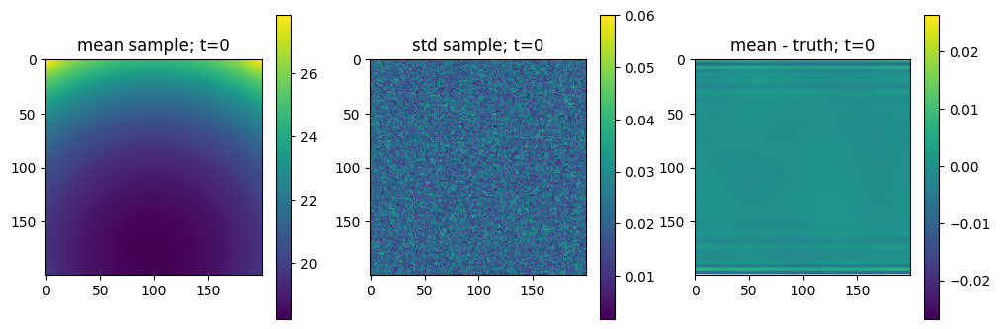

OPTIMIZE_KL: Starting 0017
SL: Iteration 0 ⛰:+4.2597e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+4.6141e+12 Δ⛰:4.2136e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.9142e+12 Δ⛰:6.9994e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.8361e+12 Δ⛰:7.8101e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.8361e+12 Δ⛰:2.4525e+04 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.7505e+12 Δ⛰:8.5613e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.6150e+12 Δ⛰:1.3544e+11 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.6150e+12 Δ⛰:4.3256e+07 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.6073e+12 Δ⛰:7.7218e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.4556e+12 Δ⛰:1.5170e+11 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.2394e+12 Δ⛰:2.1620e+11 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.2394e+12 Δ⛰:2.6247e+04 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.0139e+12 Δ⛰:2.2546e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.7771e+12 Δ⛰:2.3679e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.7771e+12 Δ⛰:1.4640e+07 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.7771e+12 Δ⛰:2.3266e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.5847e+12 Δ⛰:1.9238e+11 ➽:1.2000e+02
SL: 

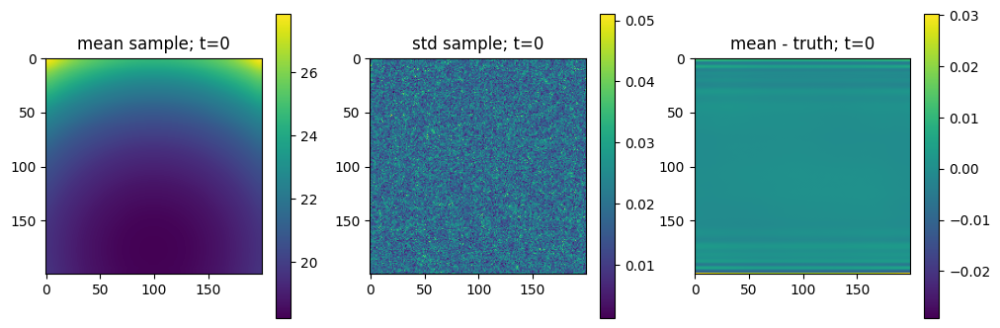

OPTIMIZE_KL: Starting 0018
SL: Iteration 0 ⛰:+8.2132e+12 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+4.5892e+12 Δ⛰:3.6240e+12 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.1744e+12 Δ⛰:1.4148e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.1372e+12 Δ⛰:3.7200e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.1372e+12 Δ⛰:2.8301e+06 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.0544e+12 Δ⛰:8.2793e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.9440e+12 Δ⛰:1.1041e+11 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.9439e+12 Δ⛰:9.5715e+07 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.9280e+12 Δ⛰:1.5949e+10 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.8226e+12 Δ⛰:1.0537e+11 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.7072e+12 Δ⛰:1.1539e+11 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.7072e+12 Δ⛰:4.3419e+04 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.5766e+12 Δ⛰:1.3067e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.4114e+12 Δ⛰:1.6514e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.4114e+12 Δ⛰:2.0348e+04 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.2774e+12 Δ⛰:1.3404e+11 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.2640e+12 Δ⛰:1.3404e+10 ➽:1.2000e+02
SL: 

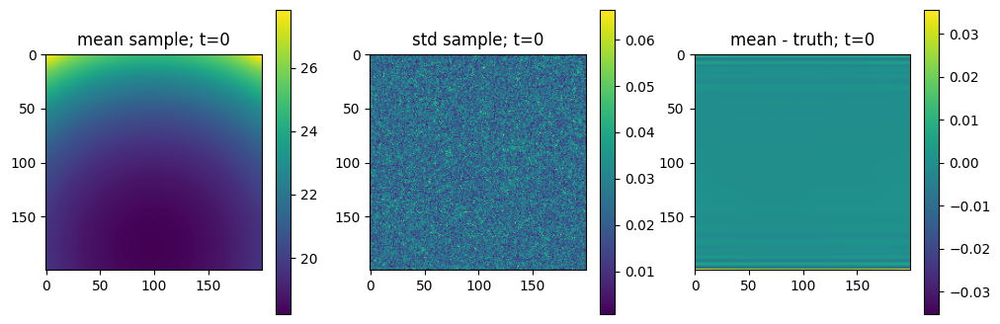

OPTIMIZE_KL: Starting 0019
SL: Iteration 0 ⛰:+7.4158e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+3.5879e+12 Δ⛰:7.4122e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.1762e+12 Δ⛰:4.1176e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.1407e+12 Δ⛰:3.5498e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.1407e+12 Δ⛰:2.8780e+05 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.0767e+12 Δ⛰:6.3982e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.9785e+12 Δ⛰:9.8165e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.9783e+12 Δ⛰:1.9798e+08 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.9603e+12 Δ⛰:1.8000e+10 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.8543e+12 Δ⛰:1.0605e+11 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.7263e+12 Δ⛰:1.2801e+11 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.7263e+12 Δ⛰:2.4610e+04 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.5692e+12 Δ⛰:1.5709e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.4049e+12 Δ⛰:1.6430e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.4049e+12 Δ⛰:1.0798e+05 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.4047e+12 Δ⛰:1.9160e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.2692e+12 Δ⛰:1.3550e+11 ➽:1.2000e+02
SL: 

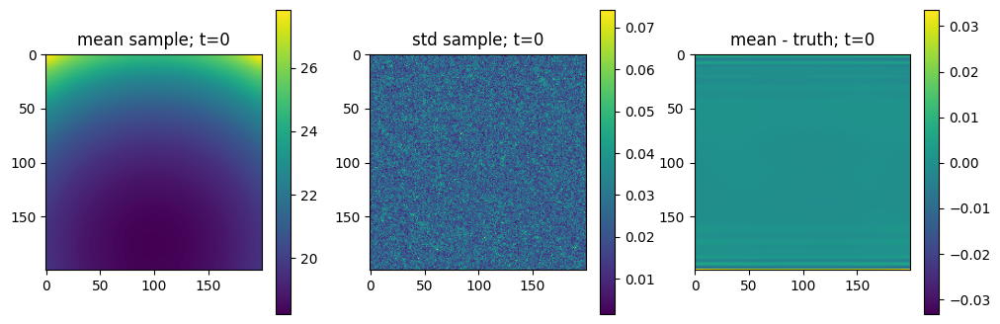

OPTIMIZE_KL: Starting 0020
SL: Iteration 0 ⛰:+2.9388e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+4.7476e+12 Δ⛰:2.9340e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.1708e+12 Δ⛰:1.5768e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.1240e+12 Δ⛰:4.6745e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.1240e+12 Δ⛰:5.9334e+04 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.0630e+12 Δ⛰:6.1084e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.9502e+12 Δ⛰:1.1277e+11 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.9497e+12 Δ⛰:4.8235e+08 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.9463e+12 Δ⛰:3.4320e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.8457e+12 Δ⛰:1.0053e+11 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.7099e+12 Δ⛰:1.3584e+11 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.7099e+12 Δ⛰:4.7461e+04 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.5744e+12 Δ⛰:1.3549e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.4100e+12 Δ⛰:1.6438e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.4100e+12 Δ⛰:3.8282e+06 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.4100e+12 Δ⛰:5.4548e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.2676e+12 Δ⛰:1.4239e+11 ➽:1.2000e+02
SL: 

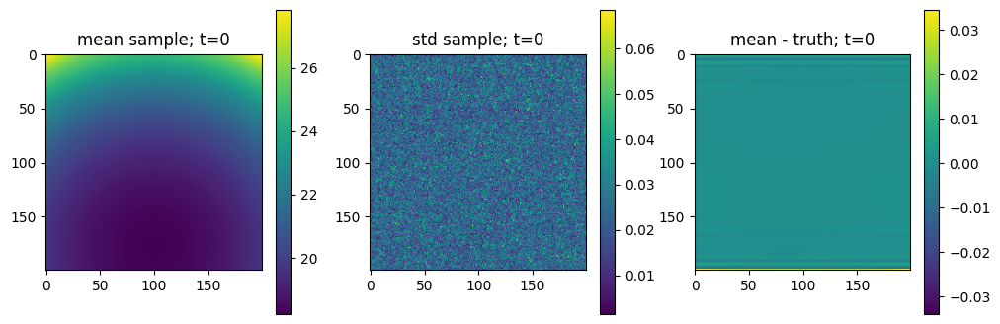

OPTIMIZE_KL: Starting 0021
SL: Iteration 0 ⛰:+1.1939e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.4856e+13 Δ⛰:1.0453e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.1625e+12 Δ⛰:1.1693e+13 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.1167e+12 Δ⛰:4.5776e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.1167e+12 Δ⛰:7.2168e+06 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.0608e+12 Δ⛰:5.5946e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.9577e+12 Δ⛰:1.0310e+11 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.9510e+12 Δ⛰:6.6825e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.9507e+12 Δ⛰:2.4233e+08 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.8452e+12 Δ⛰:1.0555e+11 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.7170e+12 Δ⛰:1.2816e+11 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.7170e+12 Δ⛰:1.4682e+07 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.5642e+12 Δ⛰:1.5277e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.4038e+12 Δ⛰:1.6044e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.4038e+12 Δ⛰:5.3677e+07 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.4038e+12 Δ⛰:3.3218e+05 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.2689e+12 Δ⛰:1.3481e+11 ➽:1.2000e+02
SL: 

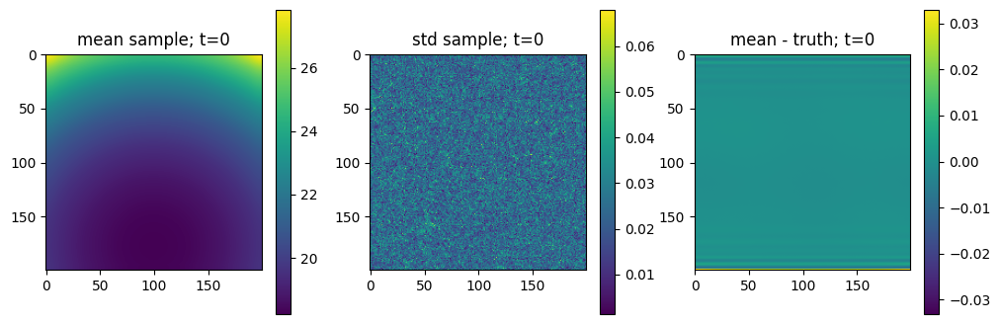

OPTIMIZE_KL: Starting 0022
SL: Iteration 0 ⛰:+5.2308e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+3.1948e+12 Δ⛰:5.1989e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.1675e+12 Δ⛰:2.7267e+10 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.1324e+12 Δ⛰:3.5116e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.1324e+12 Δ⛰:1.1972e+05 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.0729e+12 Δ⛰:5.9451e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.9589e+12 Δ⛰:1.1406e+11 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.9585e+12 Δ⛰:3.6487e+08 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.8495e+12 Δ⛰:1.0899e+11 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.8486e+12 Δ⛰:9.4186e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.7123e+12 Δ⛰:1.3633e+11 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.7123e+12 Δ⛰:2.1964e+04 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.5650e+12 Δ⛰:1.4724e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.4098e+12 Δ⛰:1.5517e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.4098e+12 Δ⛰:6.3194e+04 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.3791e+12 Δ⛰:3.0706e+10 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.2632e+12 Δ⛰:1.1594e+11 ➽:1.2000e+02
SL: 

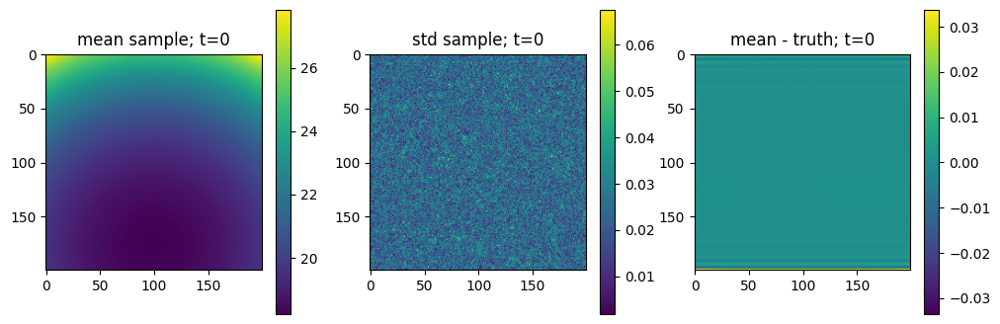

OPTIMIZE_KL: Starting 0023
SL: Iteration 0 ⛰:+6.5786e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+4.3338e+12 Δ⛰:6.1453e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.1642e+12 Δ⛰:1.1696e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.1236e+12 Δ⛰:4.0595e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.1236e+12 Δ⛰:3.2789e+05 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.0564e+12 Δ⛰:6.7173e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.9368e+12 Δ⛰:1.1960e+11 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.9367e+12 Δ⛰:8.0144e+07 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.9308e+12 Δ⛰:5.9452e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.8247e+12 Δ⛰:1.0609e+11 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.7109e+12 Δ⛰:1.1375e+11 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.7109e+12 Δ⛰:3.0003e+04 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.5665e+12 Δ⛰:1.4442e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.4113e+12 Δ⛰:1.5522e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.4113e+12 Δ⛰:1.1181e+05 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.4111e+12 Δ⛰:1.9746e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.2743e+12 Δ⛰:1.3682e+11 ➽:1.2000e+02
SL: 

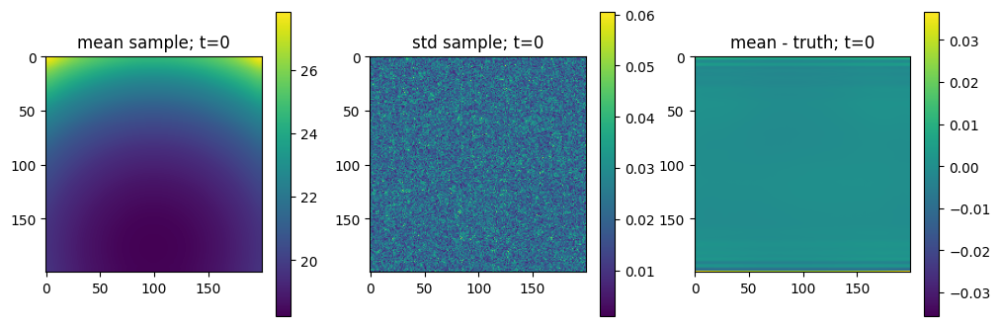

OPTIMIZE_KL: Starting 0024
SL: Iteration 0 ⛰:+3.3099e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.2712e+13 Δ⛰:2.0387e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+2.5852e+12 Δ⛰:1.0127e+13 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.5454e+12 Δ⛰:3.9877e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.5454e+12 Δ⛰:1.5775e+06 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.5009e+12 Δ⛰:4.4452e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.4304e+12 Δ⛰:7.0504e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.4298e+12 Δ⛰:5.7555e+08 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.4296e+12 Δ⛰:2.0667e+08 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.3562e+12 Δ⛰:7.3405e+10 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.2703e+12 Δ⛰:8.5892e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.2703e+12 Δ⛰:7.4681e+06 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.1674e+12 Δ⛰:1.0295e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.0650e+12 Δ⛰:1.0239e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.0648e+12 Δ⛰:2.0910e+08 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.0647e+12 Δ⛰:3.1410e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.9642e+12 Δ⛰:1.0057e+11 ➽:1.2000e+02
SL: 

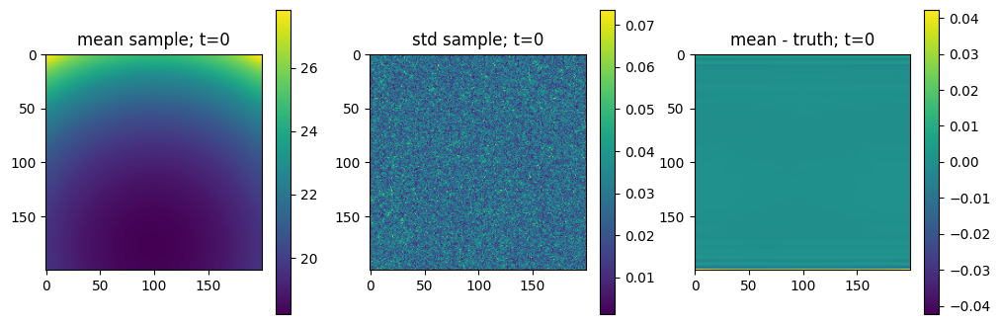

OPTIMIZE_KL: Starting 0025
SL: Iteration 0 ⛰:+4.1911e+12 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+3.5207e+12 Δ⛰:6.7044e+11 ➽:1.2000e+02
SL: Iteration 2 ⛰:+2.5871e+12 Δ⛰:9.3363e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.5409e+12 Δ⛰:4.6190e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.5408e+12 Δ⛰:6.5889e+07 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.5042e+12 Δ⛰:3.6573e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.4435e+12 Δ⛰:6.0712e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.4198e+12 Δ⛰:2.3765e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.4172e+12 Δ⛰:2.6018e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.3647e+12 Δ⛰:5.2462e+10 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.2756e+12 Δ⛰:8.9057e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.2737e+12 Δ⛰:1.9086e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.1730e+12 Δ⛰:1.0074e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.0704e+12 Δ⛰:1.0253e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.0701e+12 Δ⛰:3.2422e+08 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.0701e+12 Δ⛰:1.4764e+06 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.9648e+12 Δ⛰:1.0534e+11 ➽:1.2000e+02
SL: 

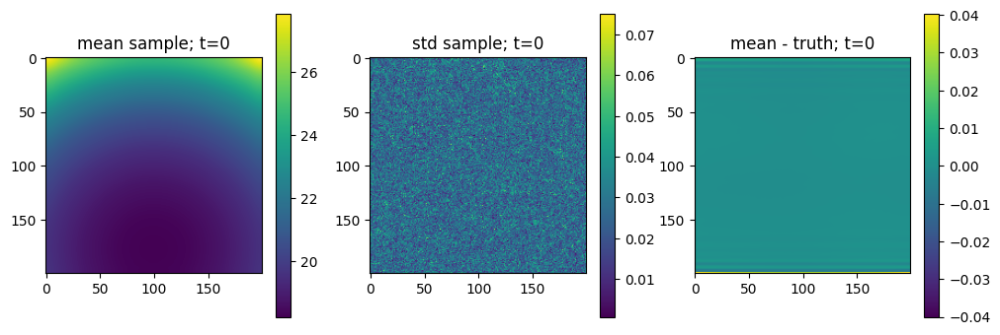

OPTIMIZE_KL: Starting 0026
SL: Iteration 0 ⛰:+4.6119e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+3.0746e+12 Δ⛰:4.6089e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+2.5880e+12 Δ⛰:4.8657e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.5372e+12 Δ⛰:5.0860e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.5372e+12 Δ⛰:4.0715e+04 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.4929e+12 Δ⛰:4.4267e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.4352e+12 Δ⛰:5.7711e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.4344e+12 Δ⛰:8.1357e+08 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.3692e+12 Δ⛰:6.5217e+10 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.3678e+12 Δ⛰:1.4216e+09 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.2720e+12 Δ⛰:9.5708e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.2720e+12 Δ⛰:1.8497e+06 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.1659e+12 Δ⛰:1.0614e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.0497e+12 Δ⛰:1.1620e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.0485e+12 Δ⛰:1.2374e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.0232e+12 Δ⛰:2.5217e+10 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.9576e+12 Δ⛰:6.5676e+10 ➽:1.2000e+02
SL: 

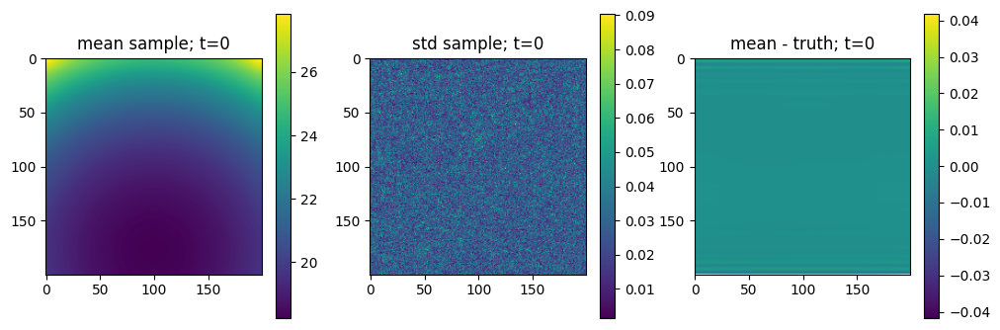

OPTIMIZE_KL: Starting 0027
SL: Iteration 0 ⛰:+5.4248e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+6.3029e+12 Δ⛰:5.3617e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+2.5871e+12 Δ⛰:3.7158e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.5611e+12 Δ⛰:2.6028e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.5611e+12 Δ⛰:5.3488e+05 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.5023e+12 Δ⛰:5.8779e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.4327e+12 Δ⛰:6.9570e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.4123e+12 Δ⛰:2.0433e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.4040e+12 Δ⛰:8.3157e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.3547e+12 Δ⛰:4.9293e+10 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.2699e+12 Δ⛰:8.4769e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.2698e+12 Δ⛰:7.3110e+07 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.1705e+12 Δ⛰:9.9357e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.0687e+12 Δ⛰:1.0178e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.0676e+12 Δ⛰:1.1423e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.0676e+12 Δ⛰:1.7495e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.9672e+12 Δ⛰:1.0031e+11 ➽:1.2000e+02
SL: 

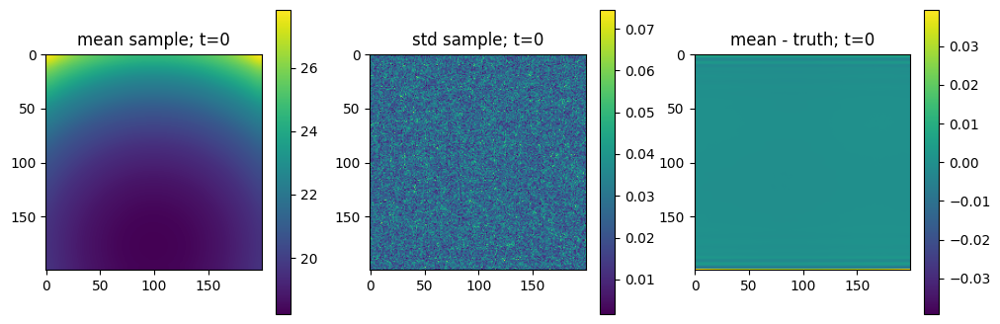

OPTIMIZE_KL: Starting 0028
SL: Iteration 0 ⛰:+8.0938e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.6410e+12 Δ⛰:8.0911e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+2.5850e+12 Δ⛰:5.6000e+10 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.5305e+12 Δ⛰:5.4558e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.5305e+12 Δ⛰:2.1446e+05 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.4650e+12 Δ⛰:6.5440e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.4227e+12 Δ⛰:4.2284e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.4227e+12 Δ⛰:2.7653e+05 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.3606e+12 Δ⛰:6.2170e+10 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.3595e+12 Δ⛰:1.0568e+09 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.2699e+12 Δ⛰:8.9620e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.2699e+12 Δ⛰:1.3743e+06 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.1723e+12 Δ⛰:9.7570e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.0693e+12 Δ⛰:1.0297e+11 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.0693e+12 Δ⛰:2.1246e+05 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.0213e+12 Δ⛰:4.8061e+10 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.9656e+12 Δ⛰:5.5676e+10 ➽:1.2000e+02
SL: 

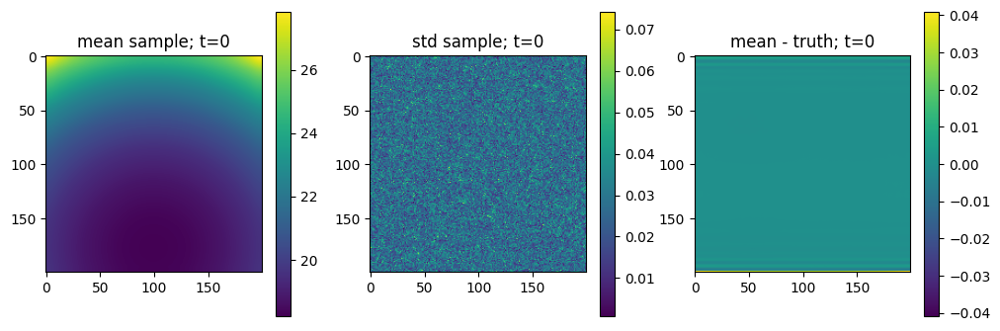

OPTIMIZE_KL: Starting 0029
SL: Iteration 0 ⛰:+2.4309e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+4.7589e+12 Δ⛰:2.4261e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+2.5879e+12 Δ⛰:2.1710e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.5564e+12 Δ⛰:3.1457e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.5564e+12 Δ⛰:3.6370e+04 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.5061e+12 Δ⛰:5.0298e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.4268e+12 Δ⛰:7.9333e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.4264e+12 Δ⛰:3.4636e+08 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.4095e+12 Δ⛰:1.6939e+10 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.3548e+12 Δ⛰:5.4746e+10 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.2723e+12 Δ⛰:8.2494e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.2723e+12 Δ⛰:6.6289e+04 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.1711e+12 Δ⛰:1.0121e+11 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.0722e+12 Δ⛰:9.8820e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.0722e+12 Δ⛰:2.1116e+06 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.0712e+12 Δ⛰:1.0754e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.9716e+12 Δ⛰:9.9539e+10 ➽:1.2000e+02
SL: 

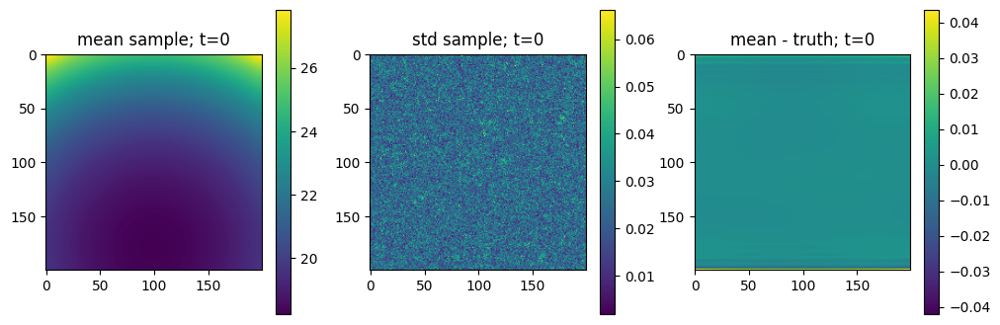

OPTIMIZE_KL: Starting 0030
SL: Iteration 0 ⛰:+2.3248e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+3.3243e+12 Δ⛰:2.2915e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+2.1256e+12 Δ⛰:1.1987e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.1004e+12 Δ⛰:2.5239e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.1004e+12 Δ⛰:5.5298e+06 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.0627e+12 Δ⛰:3.7709e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.0077e+12 Δ⛰:5.4968e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.9962e+12 Δ⛰:1.1486e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.9897e+12 Δ⛰:6.5500e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.9564e+12 Δ⛰:3.3285e+10 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.8946e+12 Δ⛰:6.1845e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.8945e+12 Δ⛰:2.8775e+06 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.8219e+12 Δ⛰:7.2643e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.7486e+12 Δ⛰:7.3345e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.7485e+12 Δ⛰:2.5661e+07 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.7482e+12 Δ⛰:3.3677e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.6758e+12 Δ⛰:7.2410e+10 ➽:1.2000e+02
SL: 

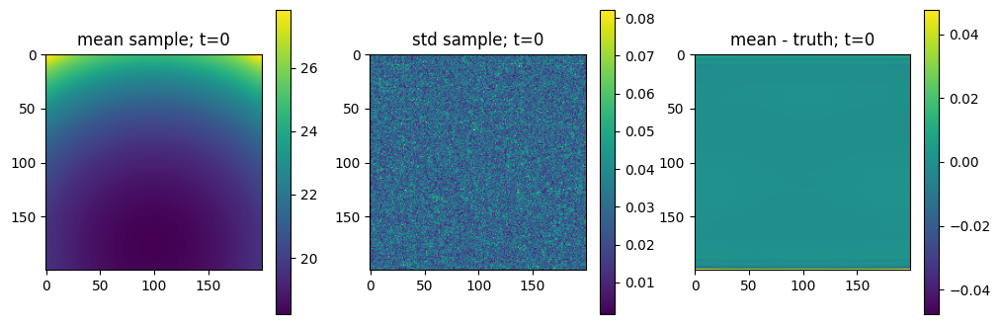

OPTIMIZE_KL: Starting 0031
SL: Iteration 0 ⛰:+2.1868e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.6567e+12 Δ⛰:2.1602e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+2.1379e+12 Δ⛰:5.1880e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.1013e+12 Δ⛰:3.6581e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.1013e+12 Δ⛰:7.6817e+05 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.0729e+12 Δ⛰:2.8457e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.0173e+12 Δ⛰:5.5594e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.0096e+12 Δ⛰:7.6514e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.9724e+12 Δ⛰:3.7174e+10 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.9699e+12 Δ⛰:2.5870e+09 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.8957e+12 Δ⛰:7.4154e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.8957e+12 Δ⛰:5.2234e+06 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.8198e+12 Δ⛰:7.5922e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.7363e+12 Δ⛰:8.3429e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.7347e+12 Δ⛰:1.6467e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.7333e+12 Δ⛰:1.3580e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.6740e+12 Δ⛰:5.9380e+10 ➽:1.2000e+02
SL: 

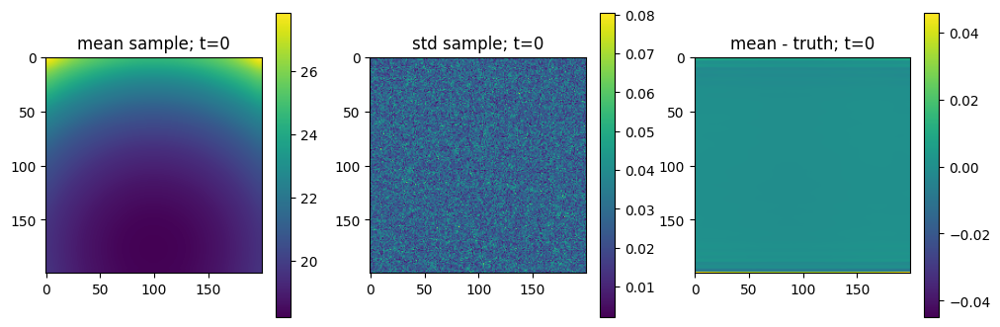

OPTIMIZE_KL: Starting 0032
SL: Iteration 0 ⛰:+3.5908e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+4.0193e+12 Δ⛰:3.5868e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.9396e+12 Δ⛰:2.0796e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.9143e+12 Δ⛰:2.5373e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.9143e+12 Δ⛰:3.7425e+05 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.8818e+12 Δ⛰:3.2485e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.8370e+12 Δ⛰:4.4811e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.8268e+12 Δ⛰:1.0146e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.7897e+12 Δ⛰:3.7090e+10 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.7880e+12 Δ⛰:1.7896e+09 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.7322e+12 Δ⛰:5.5760e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.7322e+12 Δ⛰:9.0555e+06 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.6729e+12 Δ⛰:5.9328e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.6145e+12 Δ⛰:5.8347e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.6063e+12 Δ⛰:8.2534e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.5986e+12 Δ⛰:7.6398e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.5508e+12 Δ⛰:4.7849e+10 ➽:1.2000e+02
SL: 

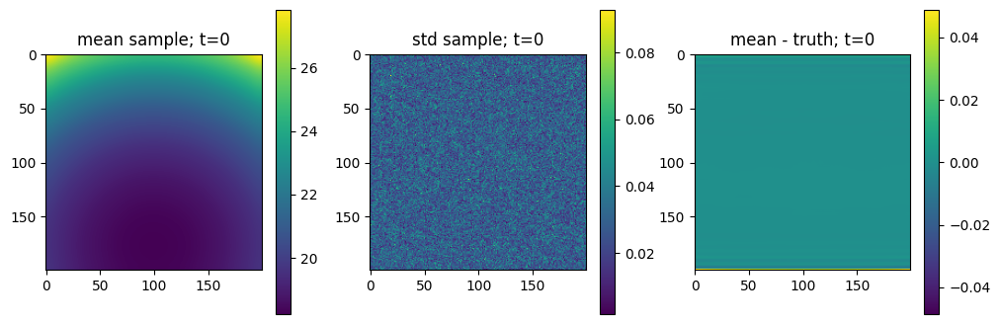

OPTIMIZE_KL: Starting 0033
SL: Iteration 0 ⛰:+4.1794e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.0819e+12 Δ⛰:4.1774e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.9436e+12 Δ⛰:1.3827e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.9115e+12 Δ⛰:3.2059e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.9115e+12 Δ⛰:7.0733e+05 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.8846e+12 Δ⛰:2.6993e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.8365e+12 Δ⛰:4.8073e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.7909e+12 Δ⛰:4.5578e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.7907e+12 Δ⛰:1.9595e+08 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.7895e+12 Δ⛰:1.1580e+09 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.7334e+12 Δ⛰:5.6183e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.7228e+12 Δ⛰:1.0543e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.6709e+12 Δ⛰:5.1970e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.6145e+12 Δ⛰:5.6314e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.5990e+12 Δ⛰:1.5545e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.5982e+12 Δ⛰:8.0353e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.5474e+12 Δ⛰:5.0780e+10 ➽:1.2000e+02
SL: 

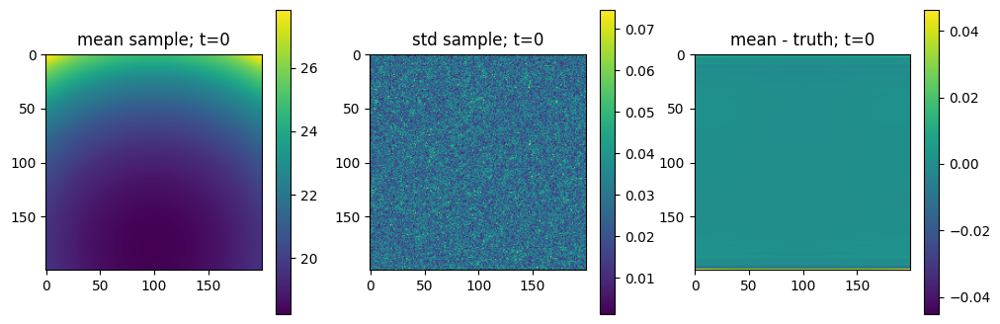

OPTIMIZE_KL: Starting 0034
SL: Iteration 0 ⛰:+8.6920e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.8077e+12 Δ⛰:8.6902e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.7698e+12 Δ⛰:3.7873e+10 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.7404e+12 Δ⛰:2.9420e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.7404e+12 Δ⛰:5.4895e+04 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.7179e+12 Δ⛰:2.2477e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.6769e+12 Δ⛰:4.1062e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.6762e+12 Δ⛰:6.3963e+08 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.6341e+12 Δ⛰:4.2105e+10 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.6336e+12 Δ⛰:5.1942e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.5854e+12 Δ⛰:4.8181e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.5854e+12 Δ⛰:1.0321e+05 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.5307e+12 Δ⛰:5.4730e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.4806e+12 Δ⛰:5.0080e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.4806e+12 Δ⛰:5.3377e+06 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.4542e+12 Δ⛰:2.6451e+10 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.4283e+12 Δ⛰:2.5856e+10 ➽:1.2000e+02
SL: 

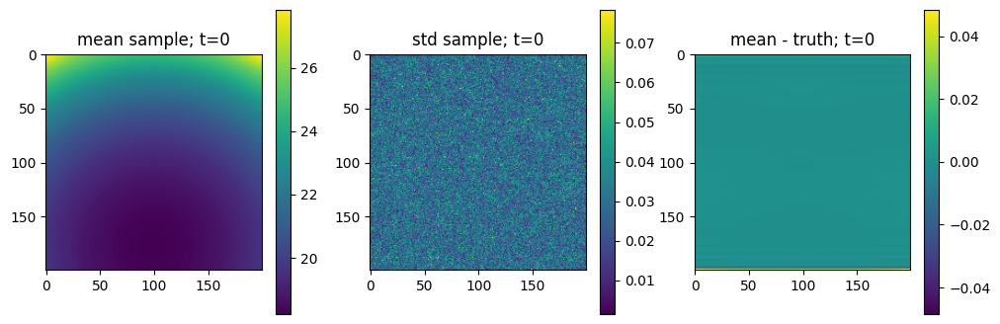

OPTIMIZE_KL: Starting 0035
SL: Iteration 0 ⛰:+1.1298e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.7959e+12 Δ⛰:1.1280e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.7682e+12 Δ⛰:2.7716e+10 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.7474e+12 Δ⛰:2.0833e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.7474e+12 Δ⛰:2.8420e+07 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.7006e+12 Δ⛰:4.6811e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.6625e+12 Δ⛰:3.8102e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.6337e+12 Δ⛰:2.8789e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.6237e+12 Δ⛰:9.9447e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.6232e+12 Δ⛰:5.6664e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.5767e+12 Δ⛰:4.6428e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.5745e+12 Δ⛰:2.1964e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.5254e+12 Δ⛰:4.9130e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.4801e+12 Δ⛰:4.5303e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.4287e+12 Δ⛰:5.1354e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.4284e+12 Δ⛰:3.4975e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.4280e+12 Δ⛰:3.6752e+08 ➽:1.2000e+02
SL: 

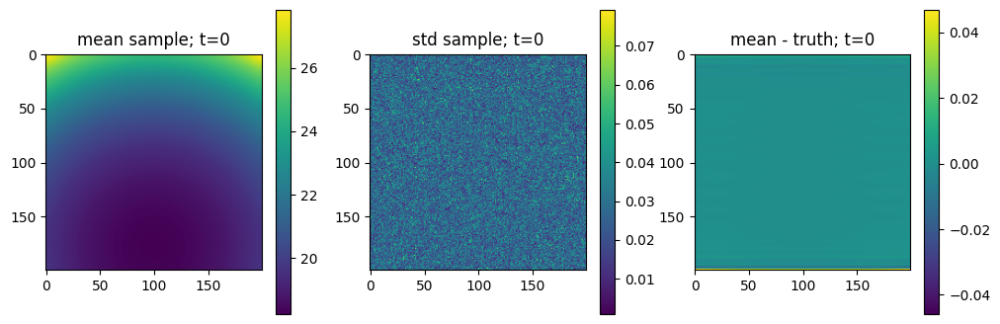

OPTIMIZE_KL: Starting 0036
SL: Iteration 0 ⛰:+1.2193e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.0714e+12 Δ⛰:1.2172e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.6215e+12 Δ⛰:4.4992e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.6005e+12 Δ⛰:2.1031e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.6005e+12 Δ⛰:3.0851e+06 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.5691e+12 Δ⛰:3.1348e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.5281e+12 Δ⛰:4.1008e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.5099e+12 Δ⛰:1.8187e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.4960e+12 Δ⛰:1.3885e+10 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.4955e+12 Δ⛰:5.7281e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.4507e+12 Δ⛰:4.4732e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.4507e+12 Δ⛰:2.4856e+07 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.4057e+12 Δ⛰:4.5016e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.3616e+12 Δ⛰:4.4120e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.3591e+12 Δ⛰:2.4231e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.3219e+12 Δ⛰:3.7266e+10 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.3217e+12 Δ⛰:2.1027e+08 ➽:1.2000e+02
SL: 

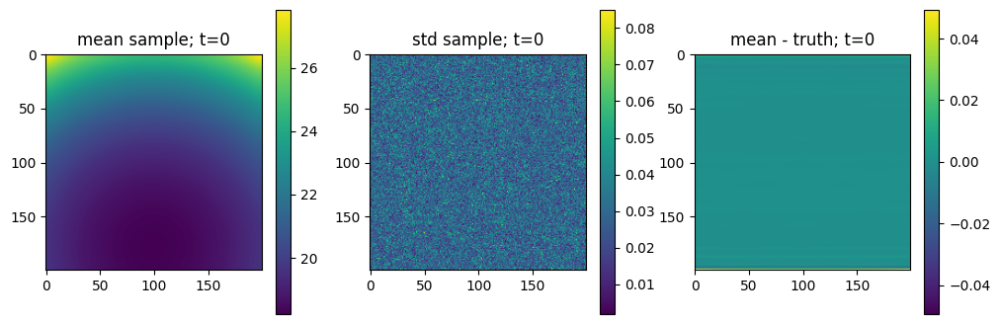

OPTIMIZE_KL: Starting 0037
SL: Iteration 0 ⛰:+2.1667e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.0404e+12 Δ⛰:1.9626e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.6276e+12 Δ⛰:4.1284e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.6024e+12 Δ⛰:2.5161e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.6017e+12 Δ⛰:7.6640e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.5712e+12 Δ⛰:3.0480e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.5246e+12 Δ⛰:4.6565e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.4962e+12 Δ⛰:2.8461e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.4958e+12 Δ⛰:3.5995e+08 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.4953e+12 Δ⛰:5.3875e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.4532e+12 Δ⛰:4.2084e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.4514e+12 Δ⛰:1.8019e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.4084e+12 Δ⛰:4.2930e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.3646e+12 Δ⛰:4.3808e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.3317e+12 Δ⛰:3.2967e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.3292e+12 Δ⛰:2.4799e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.3150e+12 Δ⛰:1.4192e+10 ➽:1.2000e+02
SL: 

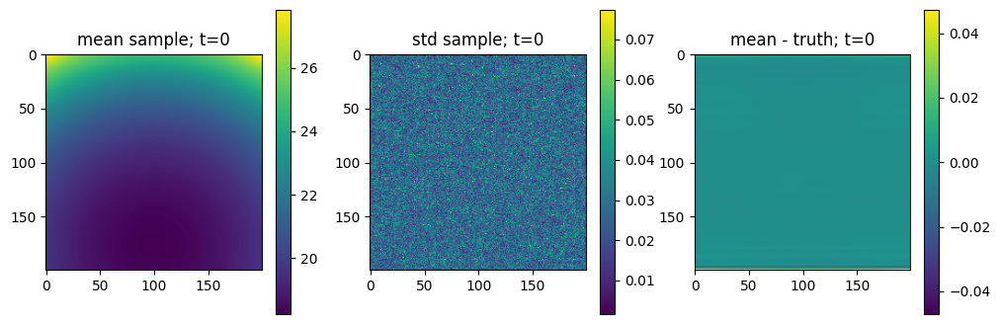

OPTIMIZE_KL: Starting 0038
SL: Iteration 0 ⛰:+5.6624e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.5583e+12 Δ⛰:5.6468e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.4950e+12 Δ⛰:6.3354e+10 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.4729e+12 Δ⛰:2.2094e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.4729e+12 Δ⛰:4.6865e+06 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.4356e+12 Δ⛰:3.7216e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.4002e+12 Δ⛰:3.5477e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.3850e+12 Δ⛰:1.5190e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.3705e+12 Δ⛰:1.4523e+10 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.3704e+12 Δ⛰:5.3193e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.3359e+12 Δ⛰:3.4526e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.3358e+12 Δ⛰:6.3695e+07 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.2916e+12 Δ⛰:4.4250e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.2575e+12 Δ⛰:3.4069e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.2497e+12 Δ⛰:7.8170e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.2155e+12 Δ⛰:3.4187e+10 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.2155e+12 Δ⛰:2.9793e+07 ➽:1.2000e+02
SL: 

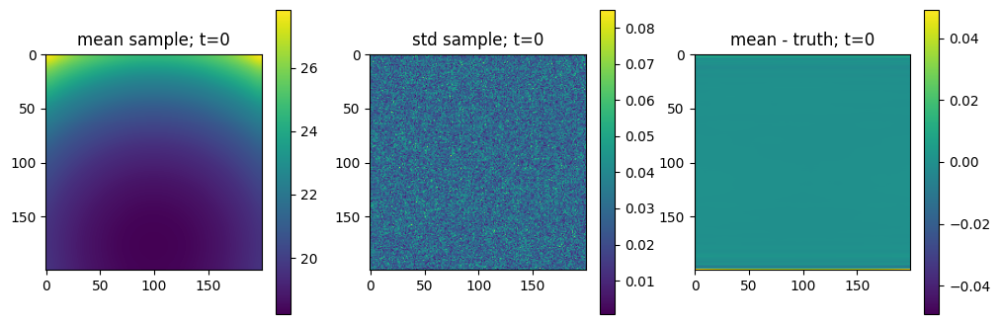

OPTIMIZE_KL: Starting 0039
SL: Iteration 0 ⛰:+2.2870e+16 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.6455e+12 Δ⛰:2.2868e+16 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.4955e+12 Δ⛰:1.5003e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.4728e+12 Δ⛰:2.2646e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.4728e+12 Δ⛰:1.5351e+05 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.4426e+12 Δ⛰:3.0236e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.4074e+12 Δ⛰:3.5244e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.4011e+12 Δ⛰:6.2704e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.3754e+12 Δ⛰:2.5700e+10 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.3753e+12 Δ⛰:1.4110e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.3366e+12 Δ⛰:3.8656e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.3297e+12 Δ⛰:6.9326e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.2977e+12 Δ⛰:3.2012e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.2610e+12 Δ⛰:3.6664e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.2184e+12 Δ⛰:4.2604e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.2182e+12 Δ⛰:1.6450e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.2178e+12 Δ⛰:3.8482e+08 ➽:1.2000e+02
SL: 

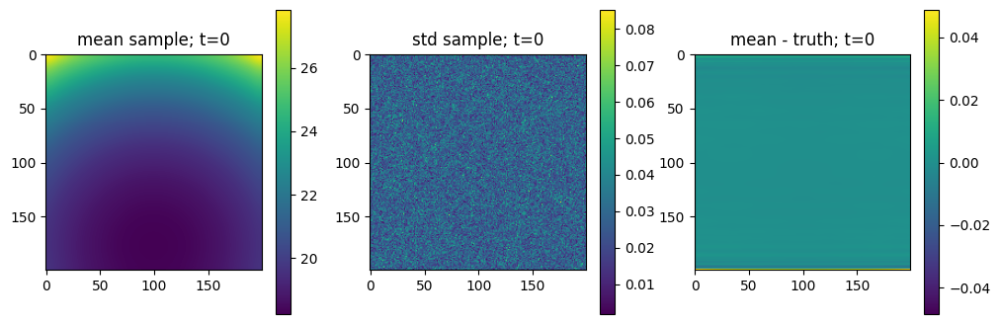

OPTIMIZE_KL: Starting 0040
SL: Iteration 0 ⛰:+7.2133e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.3787e+12 Δ⛰:7.1996e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.3764e+12 Δ⛰:2.2960e+09 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.3559e+12 Δ⛰:2.0561e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.3559e+12 Δ⛰:5.8414e+06 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.3240e+12 Δ⛰:3.1904e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.2884e+12 Δ⛰:3.5534e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.2680e+12 Δ⛰:2.0408e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.2612e+12 Δ⛰:6.8633e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.2610e+12 Δ⛰:1.4070e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.2310e+12 Δ⛰:3.0028e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.2303e+12 Δ⛰:6.5950e+08 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.1908e+12 Δ⛰:3.9525e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.1592e+12 Δ⛰:3.1611e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.1260e+12 Δ⛰:3.3177e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.1225e+12 Δ⛰:3.5385e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.1207e+12 Δ⛰:1.7593e+09 ➽:1.2000e+02
SL: 

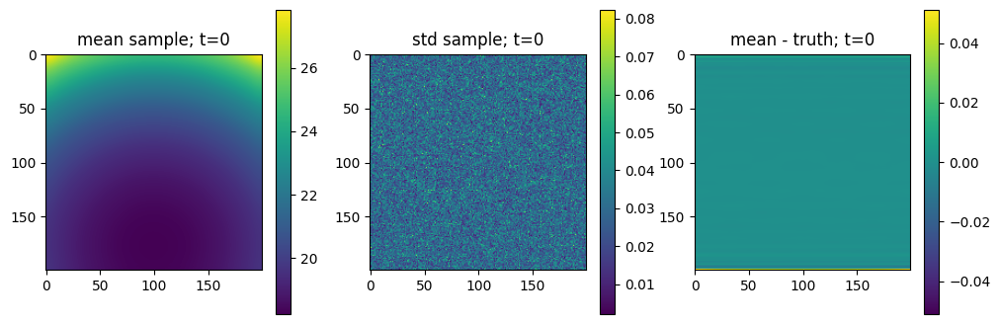

OPTIMIZE_KL: Starting 0041
SL: Iteration 0 ⛰:+5.6542e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.6170e+12 Δ⛰:5.3925e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.3810e+12 Δ⛰:1.2360e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.3535e+12 Δ⛰:2.7530e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.3534e+12 Δ⛰:7.6872e+07 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.3273e+12 Δ⛰:2.6131e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.2952e+12 Δ⛰:3.2041e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.2655e+12 Δ⛰:2.9780e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.2652e+12 Δ⛰:3.0109e+08 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.2649e+12 Δ⛰:2.1970e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.2303e+12 Δ⛰:3.4655e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.2241e+12 Δ⛰:6.2285e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.1917e+12 Δ⛰:3.2328e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.1617e+12 Δ⛰:3.0070e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.1250e+12 Δ⛰:3.6642e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.1249e+12 Δ⛰:1.6099e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.1248e+12 Δ⛰:6.2943e+07 ➽:1.2000e+02
SL: 

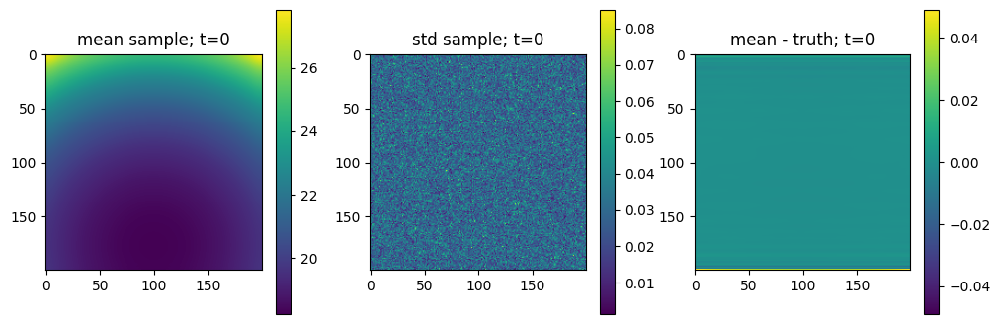

OPTIMIZE_KL: Starting 0042
SL: Iteration 0 ⛰:+9.4219e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.9487e+12 Δ⛰:9.3924e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.3893e+12 Δ⛰:1.5594e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.3622e+12 Δ⛰:2.7026e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.3622e+12 Δ⛰:1.9375e+06 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.3332e+12 Δ⛰:2.8998e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.2995e+12 Δ⛰:3.3754e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.2843e+12 Δ⛰:1.5212e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.2699e+12 Δ⛰:1.4394e+10 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.2699e+12 Δ⛰:1.7728e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.2313e+12 Δ⛰:3.8564e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.2313e+12 Δ⛰:1.2487e+07 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.1903e+12 Δ⛰:4.0939e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.1601e+12 Δ⛰:3.0285e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.1504e+12 Δ⛰:9.6254e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.1317e+12 Δ⛰:1.8720e+10 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.1316e+12 Δ⛰:1.2974e+08 ➽:1.2000e+02
SL: 

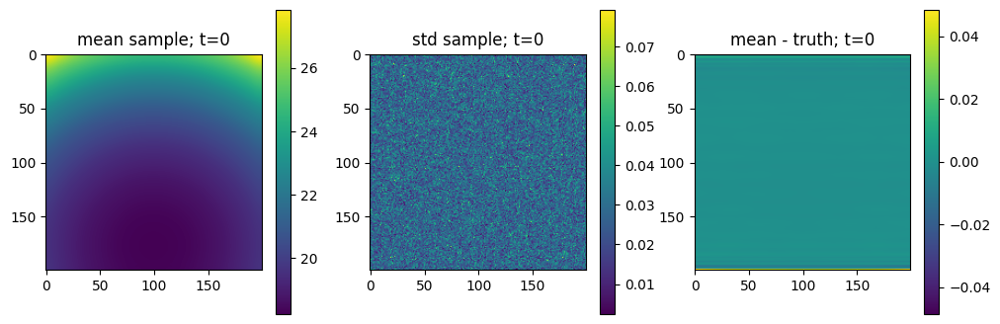

OPTIMIZE_KL: Starting 0043
SL: Iteration 0 ⛰:+8.8322e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.3734e+12 Δ⛰:8.8184e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.2805e+12 Δ⛰:9.2890e+10 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.2574e+12 Δ⛰:2.3067e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.2571e+12 Δ⛰:3.7819e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.2287e+12 Δ⛰:2.8361e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.1967e+12 Δ⛰:3.2011e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.1706e+12 Δ⛰:2.6061e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.1706e+12 Δ⛰:1.2034e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.1706e+12 Δ⛰:2.3550e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.1400e+12 Δ⛰:3.0637e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.1028e+12 Δ⛰:3.7178e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.1028e+12 Δ⛰:2.5646e+06 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.0756e+12 Δ⛰:2.7207e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.0439e+12 Δ⛰:3.1660e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.0439e+12 Δ⛰:4.5798e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.0439e+12 Δ⛰:7.9403e+06 ➽:1.2000e+02
SL: 

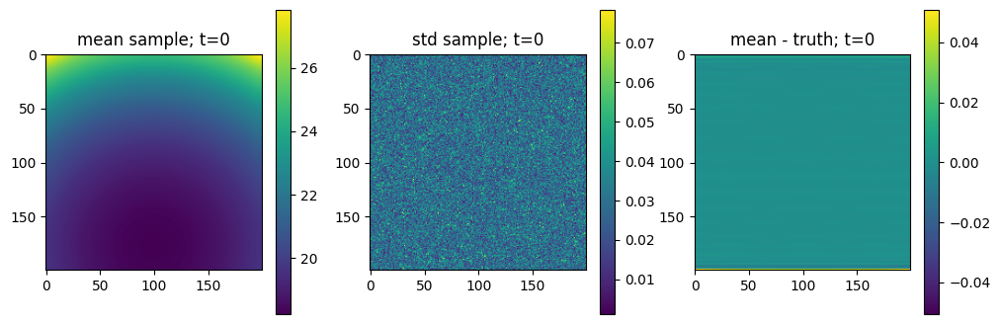

OPTIMIZE_KL: Starting 0044
SL: Iteration 0 ⛰:+2.1275e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.3271e+12 Δ⛰:1.9948e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.2916e+12 Δ⛰:3.5507e+10 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.2649e+12 Δ⛰:2.6695e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.2644e+12 Δ⛰:5.6099e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.2350e+12 Δ⛰:2.9364e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.2030e+12 Δ⛰:3.1997e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.1752e+12 Δ⛰:2.7821e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.1751e+12 Δ⛰:3.6882e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.1751e+12 Δ⛰:3.5476e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.1408e+12 Δ⛰:3.4301e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.1118e+12 Δ⛰:2.9022e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.1065e+12 Δ⛰:5.2845e+09 ➽:1.2000e+02
SL: Iteration 13 ⛰:+1.0788e+12 Δ⛰:2.7703e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+1.0478e+12 Δ⛰:3.1021e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+1.0478e+12 Δ⛰:4.1298e+05 ➽:1.2000e+02
SL: Iteration 16 ⛰:+1.0477e+12 Δ⛰:6.5519e+07 ➽:1.2000e+02
SL: 

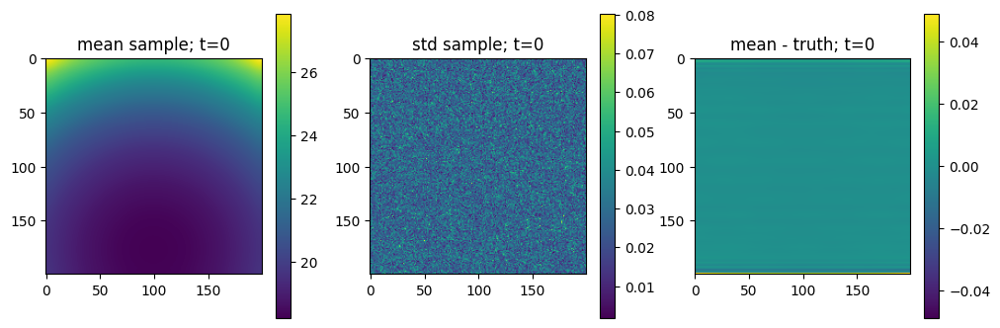

OPTIMIZE_KL: Starting 0045
SL: Iteration 0 ⛰:+1.9393e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.3700e+12 Δ⛰:1.9379e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.1964e+12 Δ⛰:1.7363e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.1740e+12 Δ⛰:2.2413e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.1739e+12 Δ⛰:6.1353e+06 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.1471e+12 Δ⛰:2.6858e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.1134e+12 Δ⛰:3.3722e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.0877e+12 Δ⛰:2.5682e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.0866e+12 Δ⛰:1.1020e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.0865e+12 Δ⛰:7.8205e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.0560e+12 Δ⛰:3.0530e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.0454e+12 Δ⛰:1.0619e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.0233e+12 Δ⛰:2.2041e+10 ➽:1.2000e+02
SL: Iteration 13 ⛰:+9.9971e+11 Δ⛰:2.3607e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+9.7769e+11 Δ⛰:2.2022e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+9.7767e+11 Δ⛰:1.8869e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+9.7296e+11 Δ⛰:4.7090e+09 ➽:1.2000e+02
SL: 

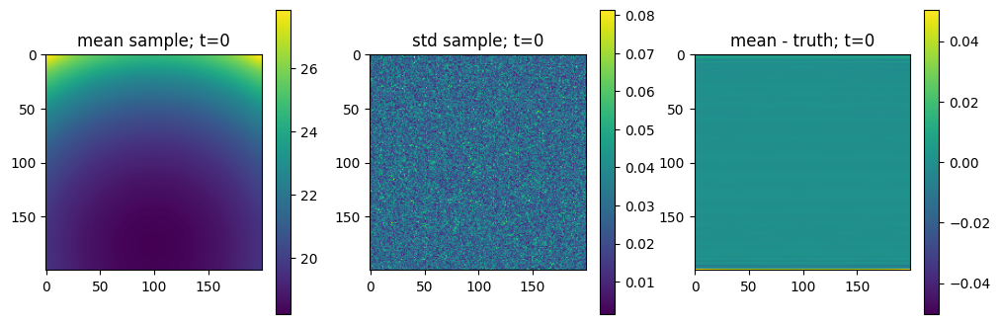

OPTIMIZE_KL: Starting 0046
SL: Iteration 0 ⛰:+6.7949e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+6.9920e+12 Δ⛰:6.7250e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.2068e+12 Δ⛰:5.7851e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.1804e+12 Δ⛰:2.6422e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.1804e+12 Δ⛰:2.9269e+07 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.1504e+12 Δ⛰:2.9958e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.1172e+12 Δ⛰:3.3214e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.0886e+12 Δ⛰:2.8596e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.0886e+12 Δ⛰:2.8188e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.0884e+12 Δ⛰:2.0941e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+1.0548e+12 Δ⛰:3.3562e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+1.0278e+12 Δ⛰:2.7041e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+1.0241e+12 Δ⛰:3.7192e+09 ➽:1.2000e+02
SL: Iteration 13 ⛰:+9.9657e+11 Δ⛰:2.7498e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+9.7276e+11 Δ⛰:2.3803e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+9.7275e+11 Δ⛰:1.0255e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+9.7111e+11 Δ⛰:1.6490e+09 ➽:1.2000e+02
SL: 

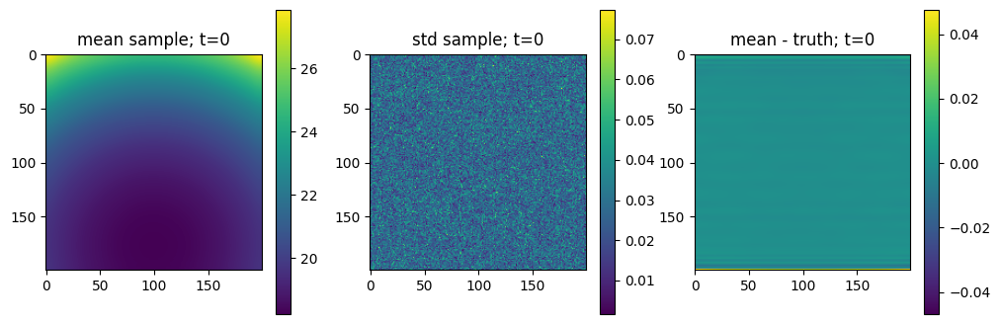

OPTIMIZE_KL: Starting 0047
SL: Iteration 0 ⛰:+2.9531e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.4376e+12 Δ⛰:2.9387e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.1267e+12 Δ⛰:3.1089e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.0996e+12 Δ⛰:2.7061e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.0988e+12 Δ⛰:7.8485e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.0631e+12 Δ⛰:3.5753e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.0318e+12 Δ⛰:3.1311e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.0098e+12 Δ⛰:2.1919e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.0098e+12 Δ⛰:1.0619e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.0098e+12 Δ⛰:5.3347e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+9.8112e+11 Δ⛰:2.8659e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+9.5012e+11 Δ⛰:3.1005e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+9.5010e+11 Δ⛰:2.0812e+07 ➽:1.2000e+02
SL: Iteration 13 ⛰:+9.2879e+11 Δ⛰:2.1309e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+9.1642e+11 Δ⛰:1.2366e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+9.1642e+11 Δ⛰:1.4745e+06 ➽:1.2000e+02
SL: Iteration 16 ⛰:+9.1255e+11 Δ⛰:3.8688e+09 ➽:1.2000e+02
SL: 

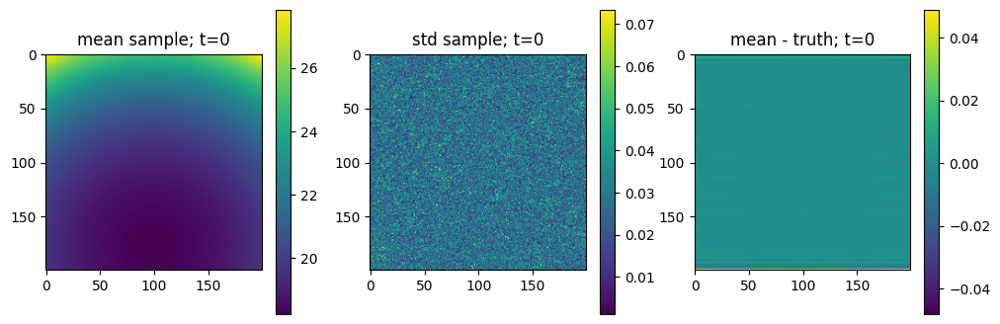

OPTIMIZE_KL: Starting 0048
SL: Iteration 0 ⛰:+7.5271e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.6092e+13 Δ⛰:7.5110e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.1162e+12 Δ⛰:1.4976e+13 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.0922e+12 Δ⛰:2.4006e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.0922e+12 Δ⛰:8.0680e+06 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.0641e+12 Δ⛰:2.8079e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+1.0352e+12 Δ⛰:2.8844e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+1.0074e+12 Δ⛰:2.7839e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+1.0072e+12 Δ⛰:2.1914e+08 ➽:1.2000e+02
SL: Iteration 9 ⛰:+1.0063e+12 Δ⛰:8.8703e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+9.7917e+11 Δ⛰:2.7110e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+9.5082e+11 Δ⛰:2.8349e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+9.4928e+11 Δ⛰:1.5488e+09 ➽:1.2000e+02
SL: Iteration 13 ⛰:+9.2488e+11 Δ⛰:2.4393e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+9.0722e+11 Δ⛰:1.7666e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+9.0383e+11 Δ⛰:3.3859e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+9.0382e+11 Δ⛰:5.1507e+06 ➽:1.2000e+02
SL: 

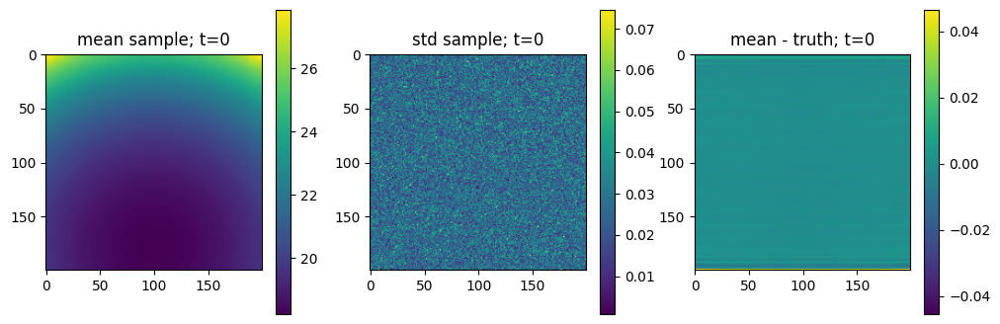

OPTIMIZE_KL: Starting 0049
SL: Iteration 0 ⛰:+1.8730e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.4784e+12 Δ⛰:1.8705e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.0461e+12 Δ⛰:1.4323e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.0208e+12 Δ⛰:2.5332e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.0207e+12 Δ⛰:5.0340e+07 ➽:1.2000e+02
SL: Iteration 5 ⛰:+9.9475e+11 Δ⛰:2.5978e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+9.6647e+11 Δ⛰:2.8280e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+9.3841e+11 Δ⛰:2.8060e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+9.3832e+11 Δ⛰:8.9455e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+9.3818e+11 Δ⛰:1.3869e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+9.1371e+11 Δ⛰:2.4467e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+8.8551e+11 Δ⛰:2.8203e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+8.8361e+11 Δ⛰:1.8948e+09 ➽:1.2000e+02
SL: Iteration 13 ⛰:+8.5946e+11 Δ⛰:2.4159e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+8.5173e+11 Δ⛰:7.7260e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+8.5173e+11 Δ⛰:7.5372e+04 ➽:1.2000e+02
SL: Iteration 16 ⛰:+8.3207e+11 Δ⛰:1.9660e+10 ➽:1.2000e+02
SL: 

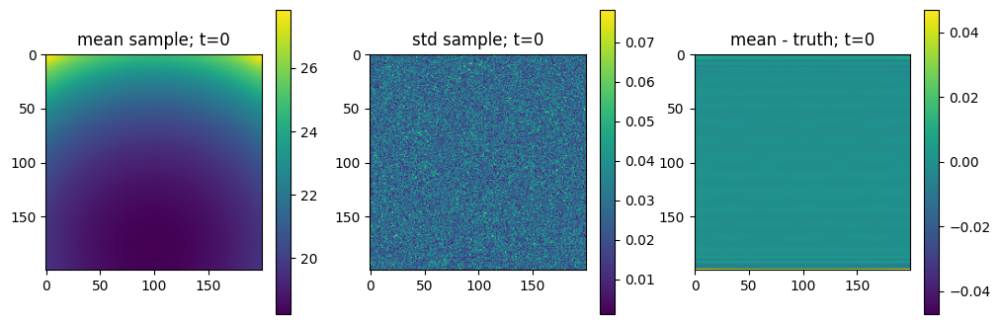

OPTIMIZE_KL: Starting 0050
SL: Iteration 0 ⛰:+7.6573e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.3199e+12 Δ⛰:7.5253e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+1.0643e+12 Δ⛰:2.5559e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+1.0233e+12 Δ⛰:4.0923e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+1.0230e+12 Δ⛰:3.1791e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+1.0024e+12 Δ⛰:2.0627e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+9.7183e+11 Δ⛰:3.0560e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+9.4554e+11 Δ⛰:2.6289e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+9.4554e+11 Δ⛰:3.8607e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+9.4503e+11 Δ⛰:5.0719e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+9.1922e+11 Δ⛰:2.5812e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+8.8822e+11 Δ⛰:3.1004e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+8.8813e+11 Δ⛰:8.9550e+07 ➽:1.2000e+02
SL: Iteration 13 ⛰:+8.6252e+11 Δ⛰:2.5606e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+8.3972e+11 Δ⛰:2.2804e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+8.3972e+11 Δ⛰:2.4364e+04 ➽:1.2000e+02
SL: Iteration 16 ⛰:+8.3816e+11 Δ⛰:1.5551e+09 ➽:1.2000e+02
SL: 

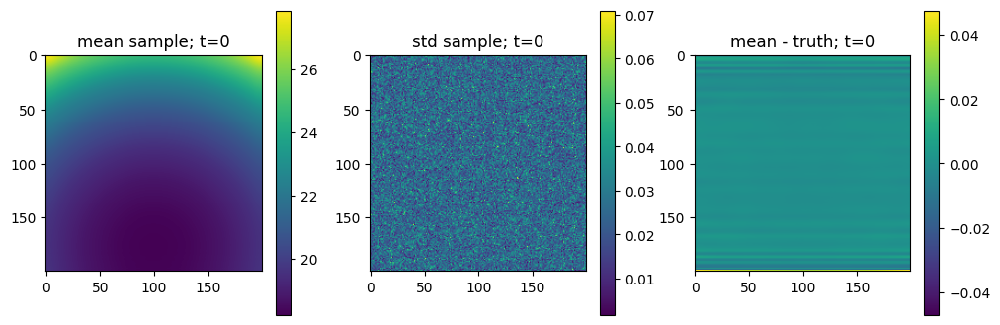

OPTIMIZE_KL: Starting 0051
SL: Iteration 0 ⛰:+3.5019e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+9.8779e+11 Δ⛰:3.4031e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+9.5925e+11 Δ⛰:2.8542e+10 ➽:1.2000e+02
SL: Iteration 3 ⛰:+9.2174e+11 Δ⛰:3.7506e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+9.1633e+11 Δ⛰:5.4087e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+8.8983e+11 Δ⛰:2.6507e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+8.6114e+11 Δ⛰:2.8681e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+8.3114e+11 Δ⛰:3.0001e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+8.3114e+11 Δ⛰:4.3616e+05 ➽:1.2000e+02
SL: Iteration 9 ⛰:+8.3062e+11 Δ⛰:5.2651e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+8.0479e+11 Δ⛰:2.5829e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+7.7809e+11 Δ⛰:2.6696e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+7.7808e+11 Δ⛰:1.0855e+07 ➽:1.2000e+02
SL: Iteration 13 ⛰:+7.5462e+11 Δ⛰:2.3464e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+7.3642e+11 Δ⛰:1.8193e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+7.3642e+11 Δ⛰:2.0944e+04 ➽:1.2000e+02
SL: Iteration 16 ⛰:+7.3558e+11 Δ⛰:8.4556e+08 ➽:1.2000e+02
SL: 

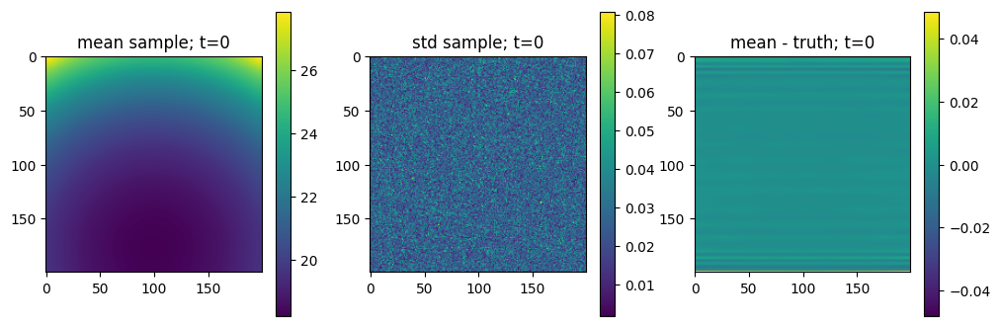

OPTIMIZE_KL: Starting 0052
SL: Iteration 0 ⛰:+5.2452e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+5.5518e+12 Δ⛰:5.1897e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+9.0991e+11 Δ⛰:4.6419e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+8.9158e+11 Δ⛰:1.8331e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+8.9141e+11 Δ⛰:1.6855e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+8.6951e+11 Δ⛰:2.1902e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+8.4288e+11 Δ⛰:2.6634e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+8.1883e+11 Δ⛰:2.4048e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+8.1881e+11 Δ⛰:1.2505e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+8.1873e+11 Δ⛰:8.2304e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+7.9667e+11 Δ⛰:2.2059e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+7.7161e+11 Δ⛰:2.5065e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+7.7145e+11 Δ⛰:1.5335e+08 ➽:1.2000e+02
SL: Iteration 13 ⛰:+7.5285e+11 Δ⛰:1.8600e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+7.2972e+11 Δ⛰:2.3133e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+7.2972e+11 Δ⛰:1.1459e+06 ➽:1.2000e+02
SL: Iteration 16 ⛰:+7.2964e+11 Δ⛰:8.4019e+07 ➽:1.2000e+02
SL: 

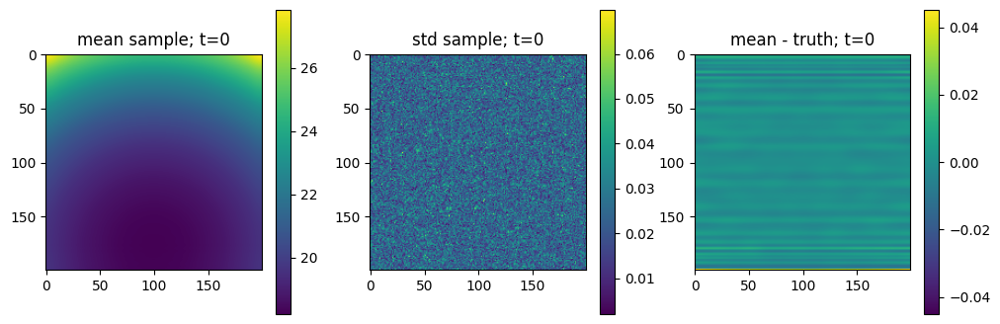

OPTIMIZE_KL: Starting 0053
SL: Iteration 0 ⛰:+1.3387e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.2291e+12 Δ⛰:1.3164e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+8.4507e+11 Δ⛰:1.3840e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+8.0230e+11 Δ⛰:4.2776e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+7.8477e+11 Δ⛰:1.7530e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+7.6637e+11 Δ⛰:1.8396e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+7.3984e+11 Δ⛰:2.6538e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+7.1783e+11 Δ⛰:2.2003e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+7.1783e+11 Δ⛰:8.4925e+04 ➽:1.2000e+02
SL: Iteration 9 ⛰:+7.1757e+11 Δ⛰:2.5930e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+6.9268e+11 Δ⛰:2.4887e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+6.6947e+11 Δ⛰:2.3211e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+6.6947e+11 Δ⛰:1.6915e+06 ➽:1.2000e+02
SL: Iteration 13 ⛰:+6.5213e+11 Δ⛰:1.7346e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+6.4889e+11 Δ⛰:3.2330e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+6.4887e+11 Δ⛰:1.9387e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+6.4013e+11 Δ⛰:8.7401e+09 ➽:1.2000e+02
SL: 

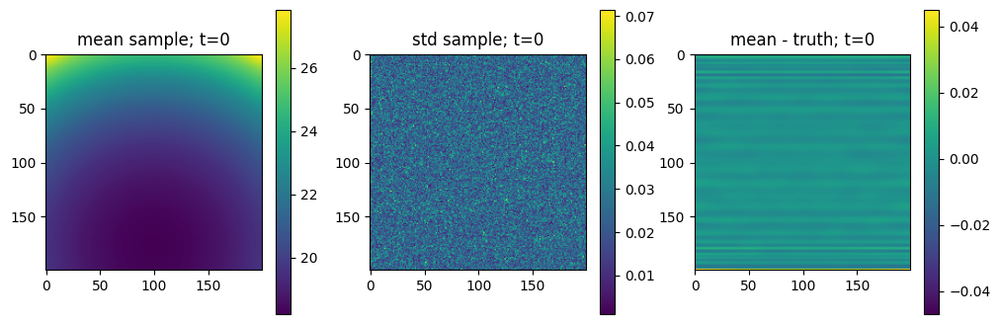

OPTIMIZE_KL: Starting 0054
SL: Iteration 0 ⛰:+8.7429e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.4282e+12 Δ⛰:8.6001e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+8.7618e+11 Δ⛰:5.5199e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+8.0969e+11 Δ⛰:6.6496e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+7.7562e+11 Δ⛰:3.4062e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+7.7027e+11 Δ⛰:5.3573e+09 ➽:1.2000e+02
SL: Iteration 6 ⛰:+7.4715e+11 Δ⛰:2.3120e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+7.1842e+11 Δ⛰:2.8731e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+7.1842e+11 Δ⛰:5.6479e+04 ➽:1.2000e+02
SL: Iteration 9 ⛰:+7.1840e+11 Δ⛰:1.8592e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+6.9649e+11 Δ⛰:2.1912e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+6.7537e+11 Δ⛰:2.1113e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+6.7537e+11 Δ⛰:1.9651e+04 ➽:1.2000e+02
SL: Iteration 13 ⛰:+6.5414e+11 Δ⛰:2.1234e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+6.4170e+11 Δ⛰:1.2443e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+6.4127e+11 Δ⛰:4.3019e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+6.4115e+11 Δ⛰:1.1622e+08 ➽:1.2000e+02
SL: 

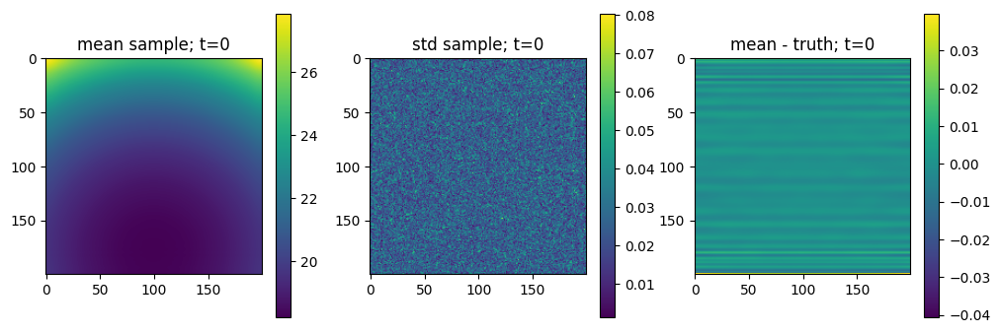

OPTIMIZE_KL: Starting 0055
SL: Iteration 0 ⛰:+3.9998e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.6989e+12 Δ⛰:3.8299e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+8.1845e+11 Δ⛰:8.8041e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+7.9704e+11 Δ⛰:2.1406e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+7.7090e+11 Δ⛰:2.6145e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+7.7089e+11 Δ⛰:7.7512e+06 ➽:1.2000e+02
SL: Iteration 6 ⛰:+7.4295e+11 Δ⛰:2.7941e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+7.2032e+11 Δ⛰:2.2628e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+7.2028e+11 Δ⛰:4.5414e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+7.2027e+11 Δ⛰:3.8755e+05 ➽:1.2000e+02
SL: Iteration 10 ⛰:+6.9646e+11 Δ⛰:2.3811e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+6.7542e+11 Δ⛰:2.1041e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+6.7087e+11 Δ⛰:4.5494e+09 ➽:1.2000e+02
SL: Iteration 13 ⛰:+6.5663e+11 Δ⛰:1.4241e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+6.5194e+11 Δ⛰:4.6938e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+6.4904e+11 Δ⛰:2.8984e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+6.3806e+11 Δ⛰:1.0984e+10 ➽:1.2000e+02
SL: 

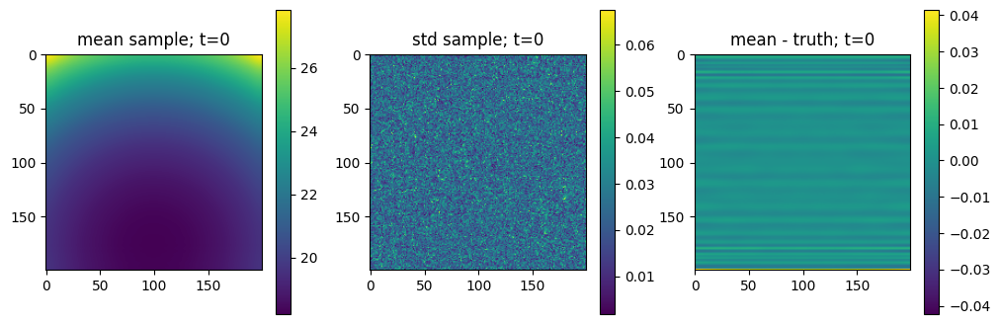

OPTIMIZE_KL: Starting 0056
SL: Iteration 0 ⛰:+1.6677e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+9.4243e+11 Δ⛰:1.6668e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+8.3744e+11 Δ⛰:1.0499e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+8.0273e+11 Δ⛰:3.4715e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+8.0222e+11 Δ⛰:5.0965e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+7.7376e+11 Δ⛰:2.8458e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+7.4947e+11 Δ⛰:2.4289e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+7.2424e+11 Δ⛰:2.5232e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+7.2424e+11 Δ⛰:5.5926e+05 ➽:1.2000e+02
SL: Iteration 9 ⛰:+7.2421e+11 Δ⛰:3.0375e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+7.0176e+11 Δ⛰:2.2452e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+6.8008e+11 Δ⛰:2.1676e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+6.8008e+11 Δ⛰:2.5377e+05 ➽:1.2000e+02
SL: Iteration 13 ⛰:+6.5788e+11 Δ⛰:2.2197e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+6.5141e+11 Δ⛰:6.4766e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+6.5103e+11 Δ⛰:3.7751e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+6.5074e+11 Δ⛰:2.9338e+08 ➽:1.2000e+02
SL: 

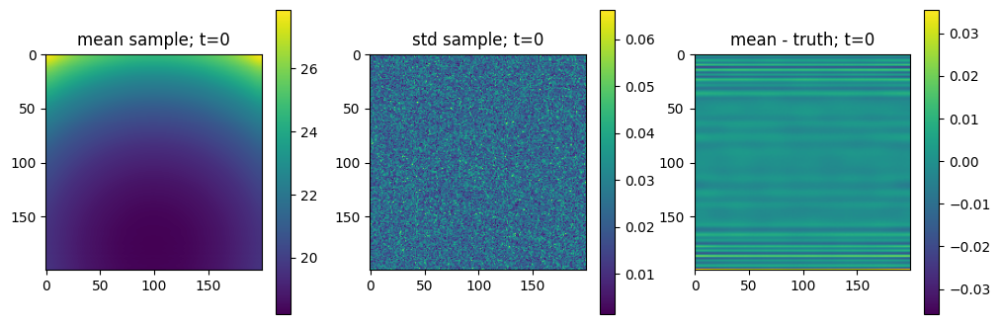

OPTIMIZE_KL: Starting 0057
SL: Iteration 0 ⛰:+1.9080e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.3062e+12 Δ⛰:1.9067e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+7.8718e+11 Δ⛰:5.1898e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+7.5206e+11 Δ⛰:3.5125e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+7.4137e+11 Δ⛰:1.0688e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+7.2205e+11 Δ⛰:1.9319e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+6.9668e+11 Δ⛰:2.5374e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+6.7167e+11 Δ⛰:2.5005e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+6.7167e+11 Δ⛰:2.9659e+04 ➽:1.2000e+02
SL: Iteration 9 ⛰:+6.7118e+11 Δ⛰:4.9013e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+6.4986e+11 Δ⛰:2.1323e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+6.2352e+11 Δ⛰:2.6339e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+6.2352e+11 Δ⛰:2.0301e+04 ➽:1.2000e+02
SL: Iteration 13 ⛰:+6.0856e+11 Δ⛰:1.4955e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+6.0505e+11 Δ⛰:3.5121e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+5.8993e+11 Δ⛰:1.5121e+10 ➽:1.2000e+02
SL: Iteration 16 ⛰:+5.8945e+11 Δ⛰:4.8007e+08 ➽:1.2000e+02
SL: 

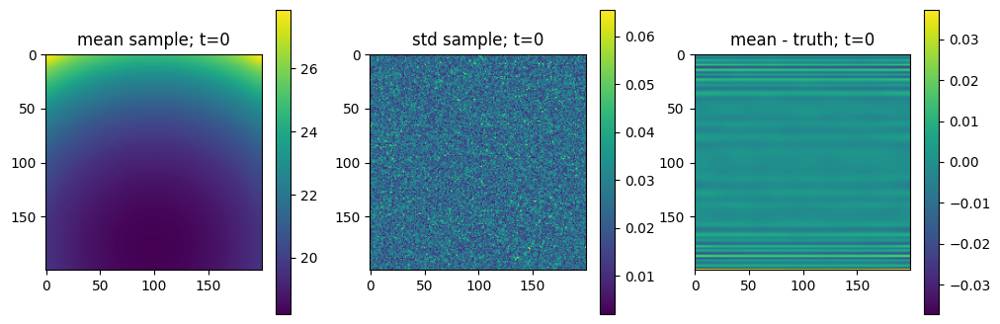

OPTIMIZE_KL: Starting 0058
SL: Iteration 0 ⛰:+5.6432e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.8021e+12 Δ⛰:5.6404e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+7.8195e+11 Δ⛰:2.0202e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+7.4832e+11 Δ⛰:3.3629e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+7.4099e+11 Δ⛰:7.3348e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+7.1664e+11 Δ⛰:2.4344e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+6.8908e+11 Δ⛰:2.7568e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+6.6700e+11 Δ⛰:2.2074e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+6.6700e+11 Δ⛰:4.4366e+05 ➽:1.2000e+02
SL: Iteration 9 ⛰:+6.6694e+11 Δ⛰:5.8438e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+6.4684e+11 Δ⛰:2.0104e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+6.2418e+11 Δ⛰:2.2657e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+6.2418e+11 Δ⛰:2.5350e+05 ➽:1.2000e+02
SL: Iteration 13 ⛰:+6.0826e+11 Δ⛰:1.5924e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+6.0565e+11 Δ⛰:2.6060e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+6.0562e+11 Δ⛰:3.0918e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+6.0562e+11 Δ⛰:9.2344e+05 ➽:1.2000e+02
SL: 

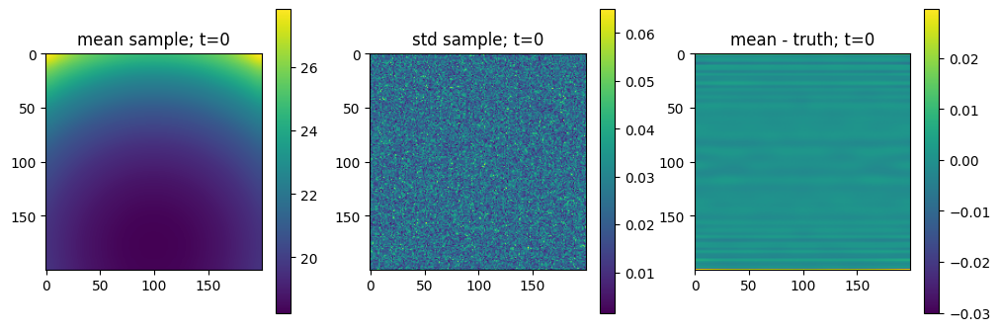

OPTIMIZE_KL: Starting 0059
SL: Iteration 0 ⛰:+1.6898e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+7.7983e+11 Δ⛰:1.6890e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+7.7931e+11 Δ⛰:5.2839e+08 ➽:1.2000e+02
SL: Iteration 3 ⛰:+7.4889e+11 Δ⛰:3.0418e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+7.4868e+11 Δ⛰:2.1174e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+7.2000e+11 Δ⛰:2.8680e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+6.9305e+11 Δ⛰:2.6947e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+6.6850e+11 Δ⛰:2.4553e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+6.6849e+11 Δ⛰:2.3716e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+6.4700e+11 Δ⛰:2.1493e+10 ➽:1.2000e+02
SL: Iteration 10 ⛰:+6.4676e+11 Δ⛰:2.3878e+08 ➽:1.2000e+02
SL: Iteration 11 ⛰:+6.2544e+11 Δ⛰:2.1321e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+6.2544e+11 Δ⛰:4.4172e+06 ➽:1.2000e+02
SL: Iteration 13 ⛰:+6.0770e+11 Δ⛰:1.7738e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+6.0291e+11 Δ⛰:4.7915e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+5.9975e+11 Δ⛰:3.1567e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+5.8989e+11 Δ⛰:9.8577e+09 ➽:1.2000e+02
SL: 

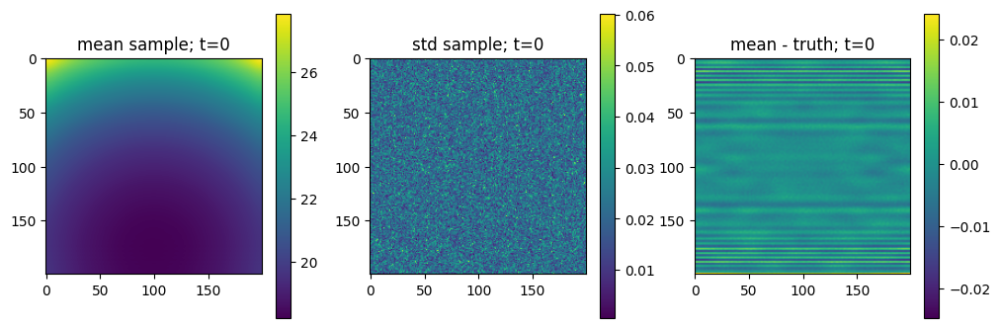

OPTIMIZE_KL: Starting 0060
SL: Iteration 0 ⛰:+2.1216e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+7.8704e+12 Δ⛰:2.0429e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+6.5799e+11 Δ⛰:7.2124e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+6.2871e+11 Δ⛰:2.9280e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+6.2391e+11 Δ⛰:4.8008e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+5.9983e+11 Δ⛰:2.4075e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+5.8174e+11 Δ⛰:1.8085e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+5.5974e+11 Δ⛰:2.2006e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+5.5974e+11 Δ⛰:1.0758e+05 ➽:1.2000e+02
SL: Iteration 9 ⛰:+5.5972e+11 Δ⛰:1.5788e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+5.4178e+11 Δ⛰:1.7945e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+5.2351e+11 Δ⛰:1.8272e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+5.2350e+11 Δ⛰:1.1275e+06 ➽:1.2000e+02
SL: Iteration 13 ⛰:+5.0680e+11 Δ⛰:1.6701e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+5.0434e+11 Δ⛰:2.4667e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+5.0430e+11 Δ⛰:3.4608e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+5.0428e+11 Δ⛰:2.2190e+07 ➽:1.2000e+02
SL: 

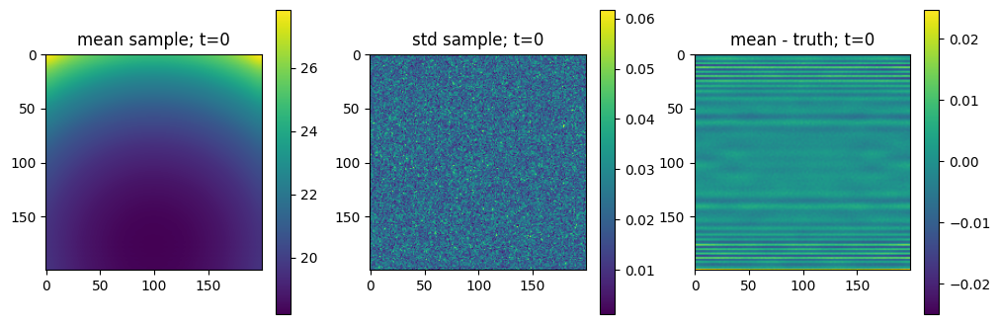

OPTIMIZE_KL: Starting 0061
SL: Iteration 0 ⛰:+4.9183e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+6.6227e+11 Δ⛰:4.9117e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+6.5898e+11 Δ⛰:3.2887e+09 ➽:1.2000e+02
SL: Iteration 3 ⛰:+6.3147e+11 Δ⛰:2.7513e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+6.2478e+11 Δ⛰:6.6871e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+6.0251e+11 Δ⛰:2.2270e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+5.8024e+11 Δ⛰:2.2275e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+5.5965e+11 Δ⛰:2.0593e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+5.5965e+11 Δ⛰:1.0830e+05 ➽:1.2000e+02
SL: Iteration 9 ⛰:+5.5906e+11 Δ⛰:5.8492e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+5.4251e+11 Δ⛰:1.6552e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+5.2364e+11 Δ⛰:1.8867e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+5.2364e+11 Δ⛰:3.8245e+05 ➽:1.2000e+02
SL: Iteration 13 ⛰:+5.0670e+11 Δ⛰:1.6944e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+5.0415e+11 Δ⛰:2.5481e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+5.0404e+11 Δ⛰:1.0500e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+4.9687e+11 Δ⛰:7.1783e+09 ➽:1.2000e+02
SL: 

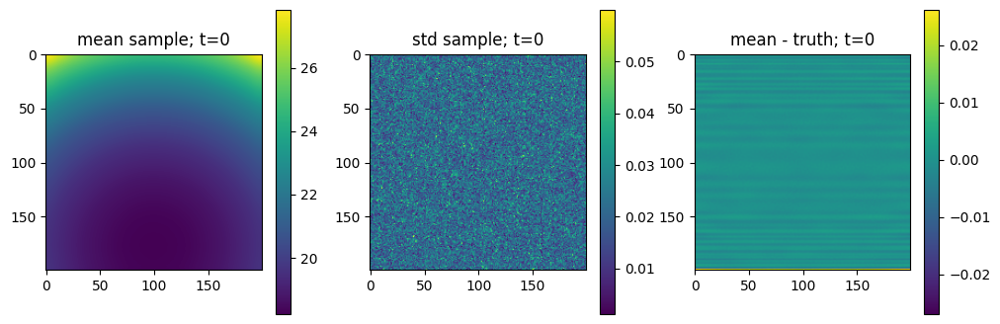

OPTIMIZE_KL: Starting 0062
SL: Iteration 0 ⛰:+8.2607e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.5932e+12 Δ⛰:8.2448e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+6.3677e+11 Δ⛰:9.5640e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+6.1470e+11 Δ⛰:2.2078e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+6.1232e+11 Δ⛰:2.3726e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+5.9925e+11 Δ⛰:1.3078e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+5.7290e+11 Δ⛰:2.6344e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+5.5240e+11 Δ⛰:2.0506e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+5.5239e+11 Δ⛰:1.1020e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+5.5235e+11 Δ⛰:4.1143e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+5.3509e+11 Δ⛰:1.7261e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+5.1717e+11 Δ⛰:1.7918e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+5.1717e+11 Δ⛰:5.2391e+04 ➽:1.2000e+02
SL: Iteration 13 ⛰:+5.0074e+11 Δ⛰:1.6436e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+4.9754e+11 Δ⛰:3.1976e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+4.9752e+11 Δ⛰:2.2778e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+4.9752e+11 Δ⛰:1.3376e+05 ➽:1.2000e+02
SL: 

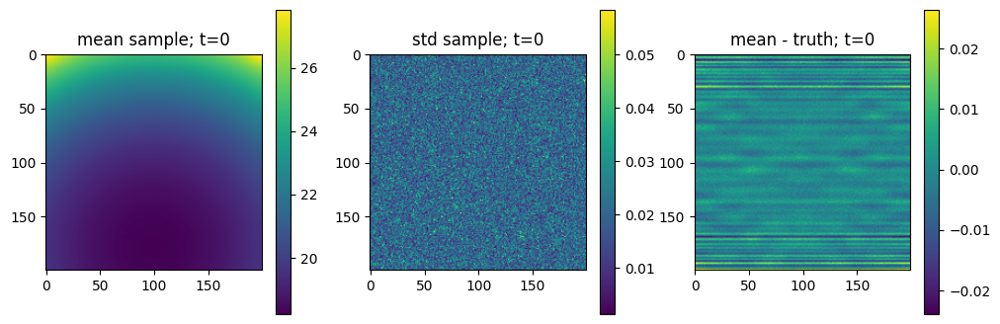

OPTIMIZE_KL: Starting 0063
SL: Iteration 0 ⛰:+5.3889e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+3.8561e+12 Δ⛰:5.3503e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+5.6962e+11 Δ⛰:3.2865e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+5.4657e+11 Δ⛰:2.3051e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+5.4551e+11 Δ⛰:1.0582e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+5.2440e+11 Δ⛰:2.1113e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+5.0550e+11 Δ⛰:1.8892e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+4.8700e+11 Δ⛰:1.8501e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+4.8700e+11 Δ⛰:6.6023e+05 ➽:1.2000e+02
SL: Iteration 9 ⛰:+4.8699e+11 Δ⛰:8.5563e+06 ➽:1.2000e+02
SL: Iteration 10 ⛰:+4.7039e+11 Δ⛰:1.6603e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+4.5520e+11 Δ⛰:1.5192e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+4.5519e+11 Δ⛰:4.5395e+06 ➽:1.2000e+02
SL: Iteration 13 ⛰:+4.4025e+11 Δ⛰:1.4948e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+4.2805e+11 Δ⛰:1.2196e+10 ➽:1.2000e+02
SL: Iteration 15 ⛰:+4.2805e+11 Δ⛰:9.2726e+04 ➽:1.2000e+02
SL: Iteration 16 ⛰:+4.2804e+11 Δ⛰:5.1165e+06 ➽:1.2000e+02
SL: 

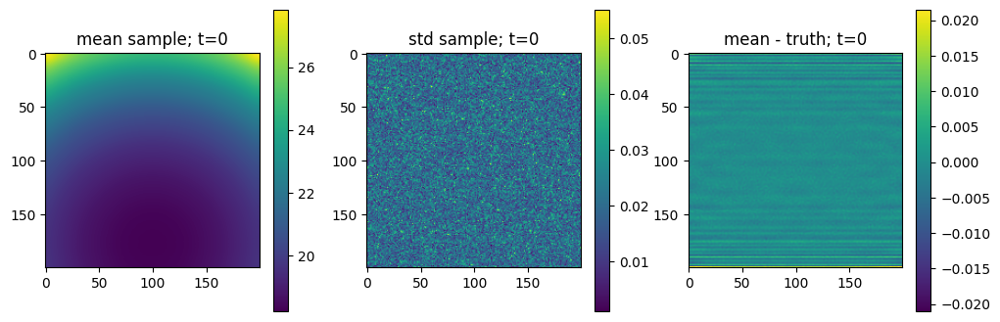

OPTIMIZE_KL: Starting 0064
SL: Iteration 0 ⛰:+1.8529e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.3019e+12 Δ⛰:1.8398e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+5.5709e+11 Δ⛰:7.4484e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+5.3635e+11 Δ⛰:2.0746e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+5.2659e+11 Δ⛰:9.7580e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+5.1928e+11 Δ⛰:7.3049e+09 ➽:1.2000e+02
SL: Iteration 6 ⛰:+5.0156e+11 Δ⛰:1.7723e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+4.8434e+11 Δ⛰:1.7216e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+4.8434e+11 Δ⛰:2.6749e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+4.8429e+11 Δ⛰:5.0291e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+4.6602e+11 Δ⛰:1.8275e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+4.5183e+11 Δ⛰:1.4183e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+4.5183e+11 Δ⛰:1.1487e+05 ➽:1.2000e+02
SL: Iteration 13 ⛰:+4.3806e+11 Δ⛰:1.3776e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+4.3534e+11 Δ⛰:2.7145e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+4.3481e+11 Δ⛰:5.2946e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+4.3481e+11 Δ⛰:5.1477e+05 ➽:1.2000e+02
SL: 

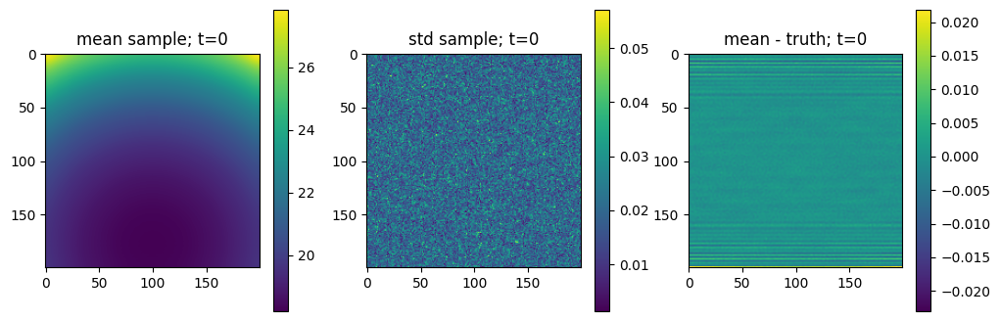

OPTIMIZE_KL: Starting 0065
SL: Iteration 0 ⛰:+7.6817e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+3.2283e+12 Δ⛰:7.6494e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+5.4871e+11 Δ⛰:2.6796e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+5.2787e+11 Δ⛰:2.0837e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+5.1157e+11 Δ⛰:1.6303e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+5.0250e+11 Δ⛰:9.0751e+09 ➽:1.2000e+02
SL: Iteration 6 ⛰:+4.8382e+11 Δ⛰:1.8676e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+4.7022e+11 Δ⛰:1.3595e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+4.7012e+11 Δ⛰:1.0686e+08 ➽:1.2000e+02
SL: Iteration 9 ⛰:+4.6979e+11 Δ⛰:3.3188e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+4.5193e+11 Δ⛰:1.7859e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+4.3736e+11 Δ⛰:1.4570e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+4.3736e+11 Δ⛰:2.0172e+04 ➽:1.2000e+02
SL: Iteration 13 ⛰:+4.2462e+11 Δ⛰:1.2733e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+4.2275e+11 Δ⛰:1.8750e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+4.2273e+11 Δ⛰:1.3853e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+4.2273e+11 Δ⛰:1.5241e+04 ➽:1.2000e+02
SL: 

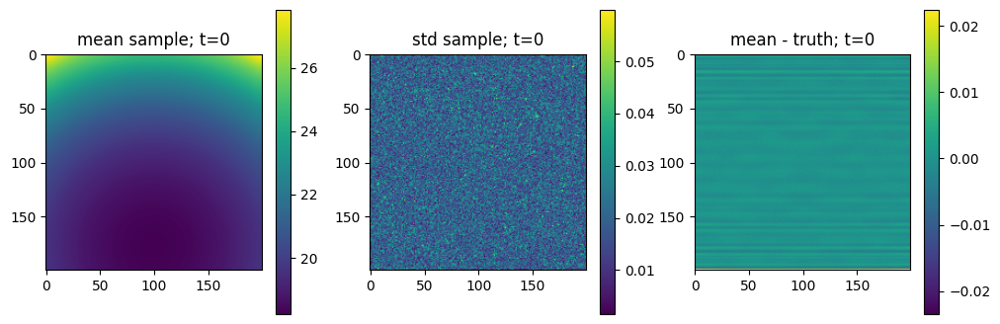

OPTIMIZE_KL: Starting 0066
SL: Iteration 0 ⛰:+7.2267e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.0422e+12 Δ⛰:7.2063e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+5.3442e+11 Δ⛰:1.5078e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+5.1458e+11 Δ⛰:1.9837e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+5.0163e+11 Δ⛰:1.2954e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+5.0041e+11 Δ⛰:1.2208e+09 ➽:1.2000e+02
SL: Iteration 6 ⛰:+4.8304e+11 Δ⛰:1.7367e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+4.6736e+11 Δ⛰:1.5679e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+4.6723e+11 Δ⛰:1.3484e+08 ➽:1.2000e+02
SL: Iteration 9 ⛰:+4.6721e+11 Δ⛰:2.2422e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+4.5125e+11 Δ⛰:1.5959e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+4.3775e+11 Δ⛰:1.3496e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+4.3775e+11 Δ⛰:1.3410e+04 ➽:1.2000e+02
SL: Iteration 13 ⛰:+4.2385e+11 Δ⛰:1.3905e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+4.1888e+11 Δ⛰:4.9666e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+4.1884e+11 Δ⛰:4.3510e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+4.1884e+11 Δ⛰:8.3643e+05 ➽:1.2000e+02
SL: 

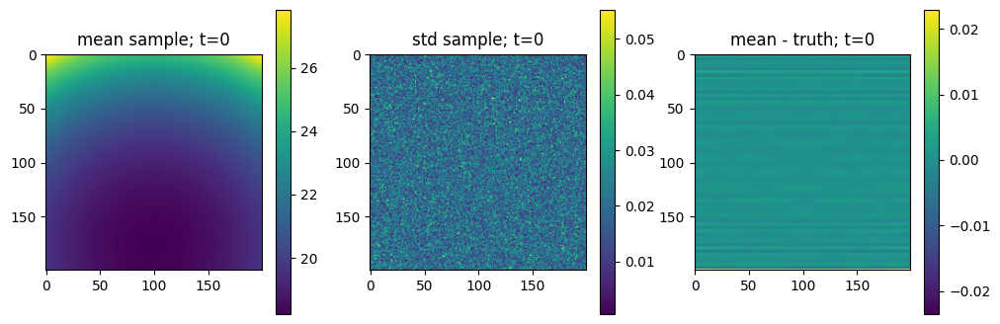

OPTIMIZE_KL: Starting 0067
SL: Iteration 0 ⛰:+6.1366e+12 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+5.8503e+11 Δ⛰:5.5516e+12 ➽:1.2000e+02
SL: Iteration 2 ⛰:+5.5831e+11 Δ⛰:2.6726e+10 ➽:1.2000e+02
SL: Iteration 3 ⛰:+5.2896e+11 Δ⛰:2.9352e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+5.0360e+11 Δ⛰:2.5356e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+5.0084e+11 Δ⛰:2.7578e+09 ➽:1.2000e+02
SL: Iteration 6 ⛰:+4.8382e+11 Δ⛰:1.7023e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+4.6756e+11 Δ⛰:1.6262e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+4.6756e+11 Δ⛰:1.9815e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+4.6754e+11 Δ⛰:1.0594e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+4.4838e+11 Δ⛰:1.9160e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+4.3452e+11 Δ⛰:1.3863e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+4.3452e+11 Δ⛰:6.0455e+05 ➽:1.2000e+02
SL: Iteration 13 ⛰:+4.2215e+11 Δ⛰:1.2370e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+4.1955e+11 Δ⛰:2.5998e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+4.1697e+11 Δ⛰:2.5835e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+4.1689e+11 Δ⛰:7.3061e+07 ➽:1.2000e+02
SL: 

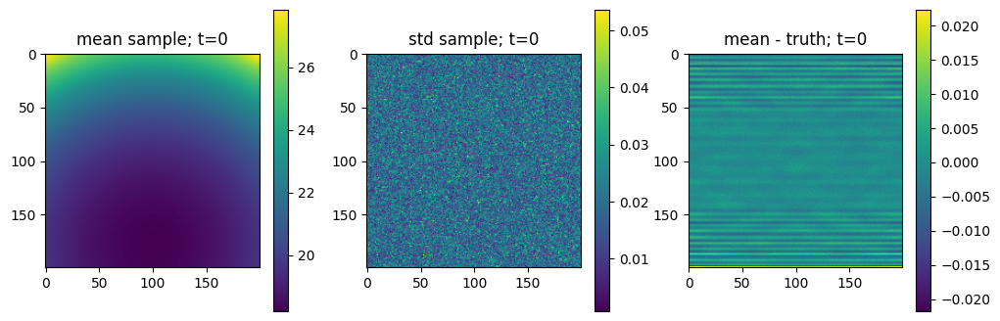

OPTIMIZE_KL: Starting 0068
SL: Iteration 0 ⛰:+1.6244e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.0297e+13 Δ⛰:1.5214e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+5.3574e+11 Δ⛰:9.7616e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+5.0437e+11 Δ⛰:3.1369e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.8037e+11 Δ⛰:2.3993e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+4.8037e+11 Δ⛰:2.9068e+06 ➽:1.2000e+02
SL: Iteration 6 ⛰:+4.6073e+11 Δ⛰:1.9647e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+4.4193e+11 Δ⛰:1.8796e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+4.4165e+11 Δ⛰:2.7763e+08 ➽:1.2000e+02
SL: Iteration 9 ⛰:+4.4165e+11 Δ⛰:3.9990e+04 ➽:1.2000e+02
SL: Iteration 10 ⛰:+4.2899e+11 Δ⛰:1.2661e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+4.1277e+11 Δ⛰:1.6223e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+4.1160e+11 Δ⛰:1.1645e+09 ➽:1.2000e+02
SL: Iteration 13 ⛰:+4.0036e+11 Δ⛰:1.1242e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.9558e+11 Δ⛰:4.7829e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.9551e+11 Δ⛰:6.8180e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.9230e+11 Δ⛰:3.2134e+09 ➽:1.2000e+02
SL: 

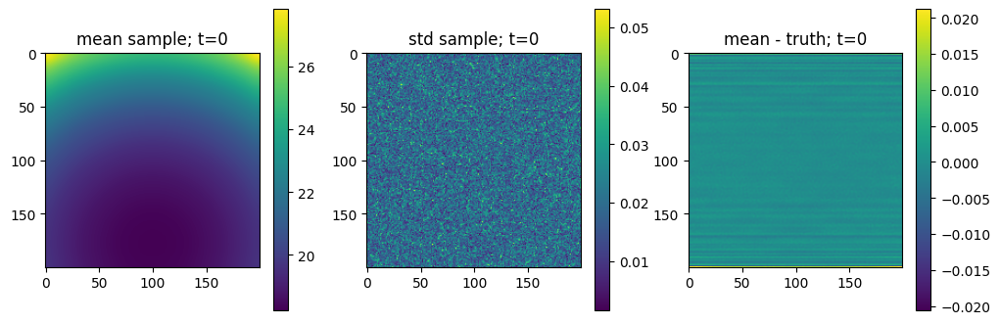

OPTIMIZE_KL: Starting 0069
SL: Iteration 0 ⛰:+6.3658e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+4.3683e+12 Δ⛰:6.3221e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+5.1300e+11 Δ⛰:3.8552e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.9217e+11 Δ⛰:2.0832e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.8970e+11 Δ⛰:2.4745e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+4.7215e+11 Δ⛰:1.7548e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+4.5576e+11 Δ⛰:1.6389e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+4.4185e+11 Δ⛰:1.3914e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+4.4179e+11 Δ⛰:5.2191e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+4.4158e+11 Δ⛰:2.1443e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+4.2314e+11 Δ⛰:1.8439e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+4.0930e+11 Δ⛰:1.3835e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+4.0930e+11 Δ⛰:1.1854e+05 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.9684e+11 Δ⛰:1.2469e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.9436e+11 Δ⛰:2.4754e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.9293e+11 Δ⛰:1.4298e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.9293e+11 Δ⛰:2.6043e+05 ➽:1.2000e+02
SL: 

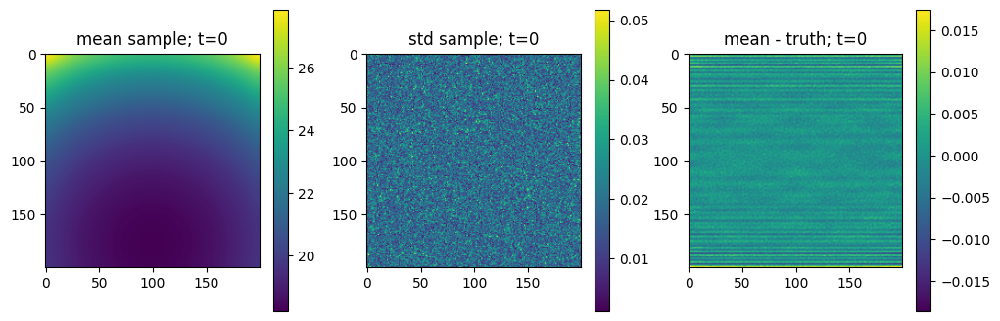

OPTIMIZE_KL: Starting 0070
SL: Iteration 0 ⛰:+3.0873e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.2288e+12 Δ⛰:3.0750e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+5.2418e+11 Δ⛰:7.0458e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.7853e+11 Δ⛰:4.5653e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.7016e+11 Δ⛰:8.3724e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+4.5420e+11 Δ⛰:1.5960e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+4.3712e+11 Δ⛰:1.7076e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+4.2010e+11 Δ⛰:1.7027e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+4.2010e+11 Δ⛰:6.5593e+04 ➽:1.2000e+02
SL: Iteration 9 ⛰:+4.2005e+11 Δ⛰:4.8387e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+4.0470e+11 Δ⛰:1.5351e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.9153e+11 Δ⛰:1.3168e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.9153e+11 Δ⛰:2.3865e+04 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.8072e+11 Δ⛰:1.0814e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.7836e+11 Δ⛰:2.3579e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.7671e+11 Δ⛰:1.6470e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.7335e+11 Δ⛰:3.3579e+09 ➽:1.2000e+02
SL: 

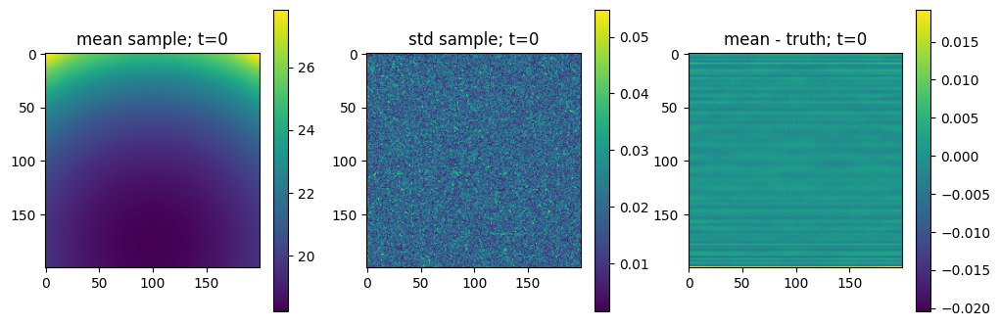

OPTIMIZE_KL: Starting 0071
SL: Iteration 0 ⛰:+1.6267e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.5289e+12 Δ⛰:1.6242e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.7839e+11 Δ⛰:2.0506e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.6032e+11 Δ⛰:1.8069e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.6004e+11 Δ⛰:2.7738e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+4.4272e+11 Δ⛰:1.7325e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+4.2835e+11 Δ⛰:1.4367e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+4.1499e+11 Δ⛰:1.3362e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+4.1499e+11 Δ⛰:2.7608e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+4.1480e+11 Δ⛰:1.8336e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+4.0027e+11 Δ⛰:1.4530e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.8809e+11 Δ⛰:1.2187e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.8807e+11 Δ⛰:1.5086e+07 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.7511e+11 Δ⛰:1.2964e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.7297e+11 Δ⛰:2.1329e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.7297e+11 Δ⛰:2.7808e+06 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.7296e+11 Δ⛰:9.2414e+06 ➽:1.2000e+02
SL: 

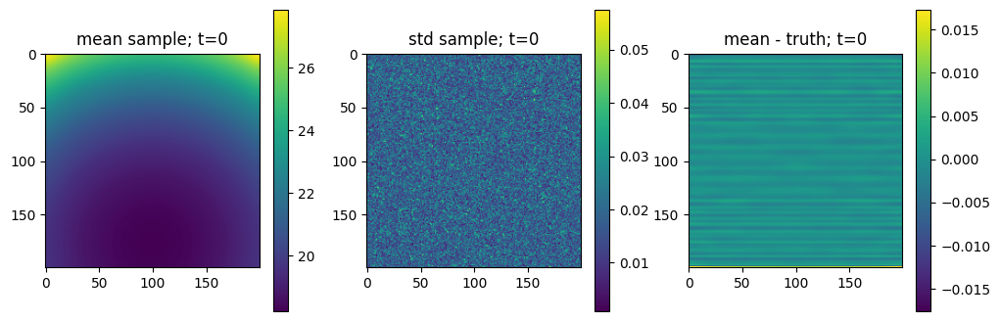

OPTIMIZE_KL: Starting 0072
SL: Iteration 0 ⛰:+5.3349e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.3284e+12 Δ⛰:5.3216e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.9096e+11 Δ⛰:8.3746e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.7056e+11 Δ⛰:2.0405e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.6705e+11 Δ⛰:3.5033e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+4.4675e+11 Δ⛰:2.0298e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+4.2587e+11 Δ⛰:2.0887e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+4.0845e+11 Δ⛰:1.7423e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+4.0844e+11 Δ⛰:7.2382e+05 ➽:1.2000e+02
SL: Iteration 9 ⛰:+4.0836e+11 Δ⛰:7.9895e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.9684e+11 Δ⛰:1.1527e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.8278e+11 Δ⛰:1.4053e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.8278e+11 Δ⛰:9.7771e+04 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.7217e+11 Δ⛰:1.0611e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.7051e+11 Δ⛰:1.6656e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.7050e+11 Δ⛰:5.1629e+06 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.7050e+11 Δ⛰:4.0417e+04 ➽:1.2000e+02
SL: 

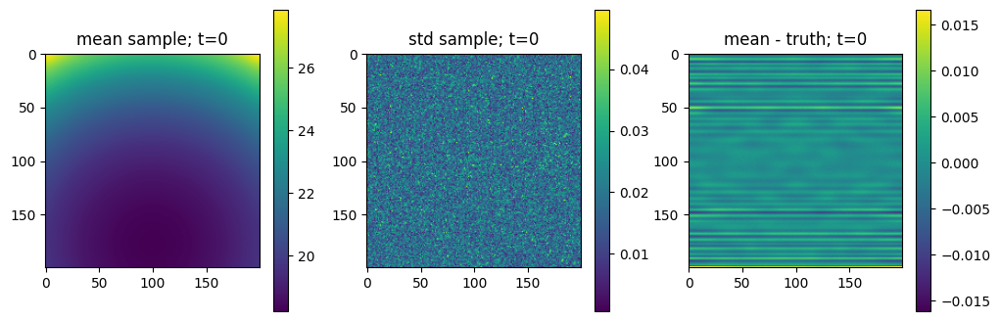

OPTIMIZE_KL: Starting 0073
SL: Iteration 0 ⛰:+1.5622e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+7.8700e+11 Δ⛰:1.5543e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.7245e+11 Δ⛰:3.1455e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.4724e+11 Δ⛰:2.5211e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.4176e+11 Δ⛰:5.4802e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+4.2430e+11 Δ⛰:1.7459e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+4.0803e+11 Δ⛰:1.6272e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.9309e+11 Δ⛰:1.4942e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.9309e+11 Δ⛰:2.6713e+05 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.9306e+11 Δ⛰:3.0075e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.7902e+11 Δ⛰:1.4034e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.6710e+11 Δ⛰:1.1922e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.6710e+11 Δ⛰:4.6414e+05 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.5368e+11 Δ⛰:1.3420e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.5192e+11 Δ⛰:1.7605e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.5191e+11 Δ⛰:4.9630e+06 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.5191e+11 Δ⛰:5.3232e+06 ➽:1.2000e+02
SL: 

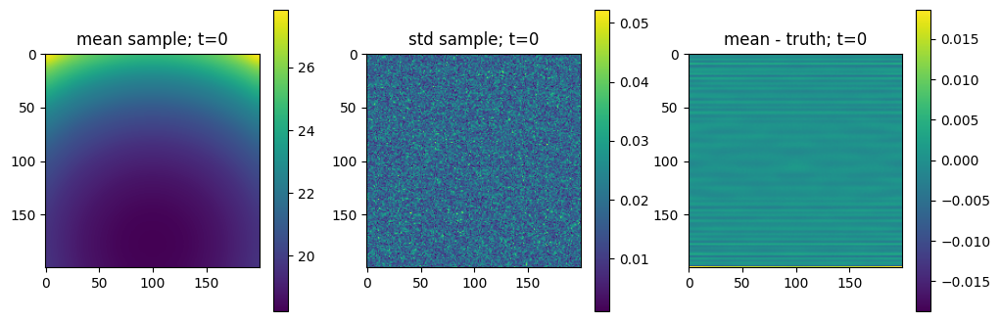

OPTIMIZE_KL: Starting 0074
SL: Iteration 0 ⛰:+8.9670e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.5506e+12 Δ⛰:8.9515e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.9128e+11 Δ⛰:1.0593e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.4654e+11 Δ⛰:4.4741e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.3978e+11 Δ⛰:6.7643e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+4.2387e+11 Δ⛰:1.5903e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+4.0670e+11 Δ⛰:1.7177e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.9215e+11 Δ⛰:1.4546e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.9215e+11 Δ⛰:2.9352e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.9203e+11 Δ⛰:1.2224e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.7755e+11 Δ⛰:1.4476e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.6504e+11 Δ⛰:1.2510e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.6504e+11 Δ⛰:6.0943e+05 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.5302e+11 Δ⛰:1.2021e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.5156e+11 Δ⛰:1.4614e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.5137e+11 Δ⛰:1.8359e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.5137e+11 Δ⛰:8.4769e+04 ➽:1.2000e+02
SL: 

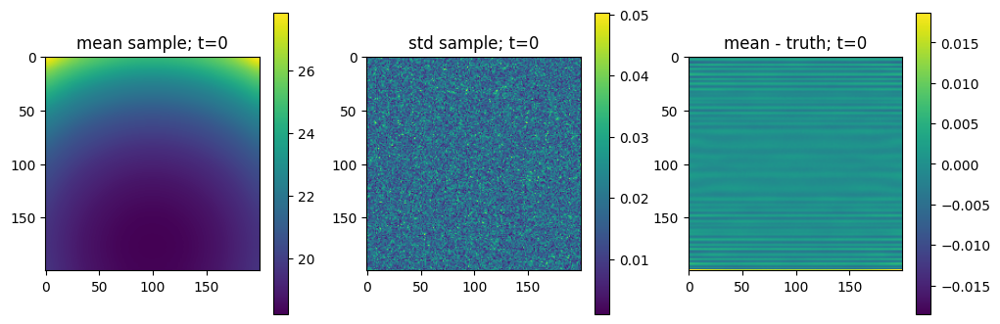

OPTIMIZE_KL: Starting 0075
SL: Iteration 0 ⛰:+1.5338e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.1071e+12 Δ⛰:1.5228e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.7047e+11 Δ⛰:6.3660e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.4029e+11 Δ⛰:3.0179e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.3973e+11 Δ⛰:5.5697e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+4.1549e+11 Δ⛰:2.4243e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.9944e+11 Δ⛰:1.6055e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.8352e+11 Δ⛰:1.5912e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.8351e+11 Δ⛰:1.1600e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.8340e+11 Δ⛰:1.0826e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.6999e+11 Δ⛰:1.3414e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.5888e+11 Δ⛰:1.1107e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.5876e+11 Δ⛰:1.2784e+08 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.4749e+11 Δ⛰:1.1266e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.4573e+11 Δ⛰:1.7622e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.4573e+11 Δ⛰:3.3600e+04 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.4564e+11 Δ⛰:8.3952e+07 ➽:1.2000e+02
SL: 

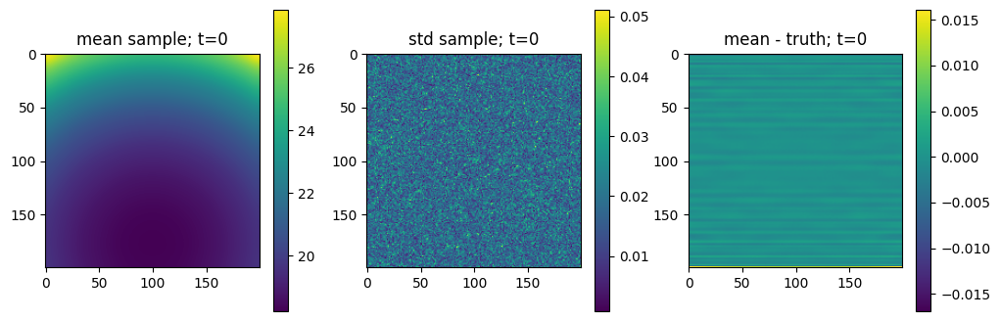

OPTIMIZE_KL: Starting 0076
SL: Iteration 0 ⛰:+2.8542e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+5.3439e+11 Δ⛰:2.8489e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.5834e+11 Δ⛰:7.6046e+10 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.2620e+11 Δ⛰:3.2139e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.1517e+11 Δ⛰:1.1031e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+4.1161e+11 Δ⛰:3.5616e+09 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.9653e+11 Δ⛰:1.5077e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.8219e+11 Δ⛰:1.4348e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.8219e+11 Δ⛰:1.5202e+05 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.8218e+11 Δ⛰:6.6772e+06 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.6863e+11 Δ⛰:1.3547e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.5717e+11 Δ⛰:1.1465e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.5717e+11 Δ⛰:9.5136e+03 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.4448e+11 Δ⛰:1.2687e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.3967e+11 Δ⛰:4.8146e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.3960e+11 Δ⛰:6.2115e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.3960e+11 Δ⛰:4.1300e+04 ➽:1.2000e+02
SL: 

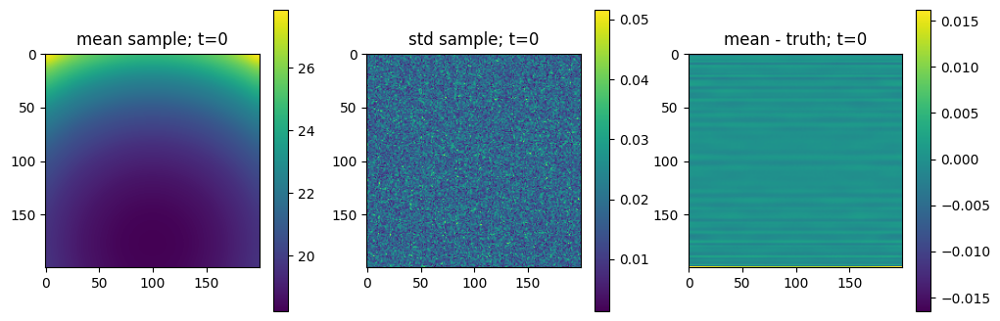

OPTIMIZE_KL: Starting 0077
SL: Iteration 0 ⛰:+4.2424e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.7510e+12 Δ⛰:4.2397e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.4480e+11 Δ⛰:2.3062e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.2996e+11 Δ⛰:1.4838e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.2995e+11 Δ⛰:1.6499e+07 ➽:1.2000e+02
SL: Iteration 5 ⛰:+4.0923e+11 Δ⛰:2.0713e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.9255e+11 Δ⛰:1.6679e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.7974e+11 Δ⛰:1.2818e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.7970e+11 Δ⛰:3.4370e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.7969e+11 Δ⛰:1.3116e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.6698e+11 Δ⛰:1.2709e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.5369e+11 Δ⛰:1.3288e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.5323e+11 Δ⛰:4.6459e+08 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.4323e+11 Δ⛰:1.0001e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.4177e+11 Δ⛰:1.4514e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.4177e+11 Δ⛰:5.6977e+04 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.4177e+11 Δ⛰:7.3953e+06 ➽:1.2000e+02
SL: 

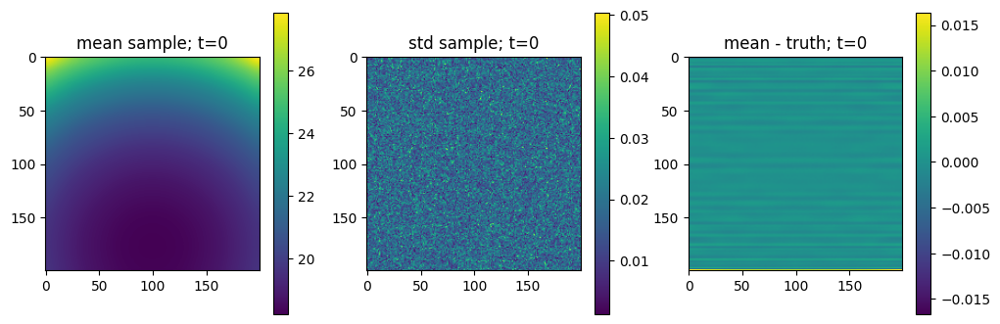

OPTIMIZE_KL: Starting 0078
SL: Iteration 0 ⛰:+2.5901e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.8095e+12 Δ⛰:2.5720e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.4358e+11 Δ⛰:1.3660e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.1586e+11 Δ⛰:2.7725e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+4.0826e+11 Δ⛰:7.5978e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+4.0797e+11 Δ⛰:2.8644e+08 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.9461e+11 Δ⛰:1.3368e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.8085e+11 Δ⛰:1.3754e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.8085e+11 Δ⛰:1.4341e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.8084e+11 Δ⛰:4.9543e+06 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.6828e+11 Δ⛰:1.2565e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.5597e+11 Δ⛰:1.2307e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.5597e+11 Δ⛰:4.2801e+04 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.4439e+11 Δ⛰:1.1586e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.3665e+11 Δ⛰:7.7319e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.3656e+11 Δ⛰:9.1642e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.3656e+11 Δ⛰:9.8406e+04 ➽:1.2000e+02
SL: 

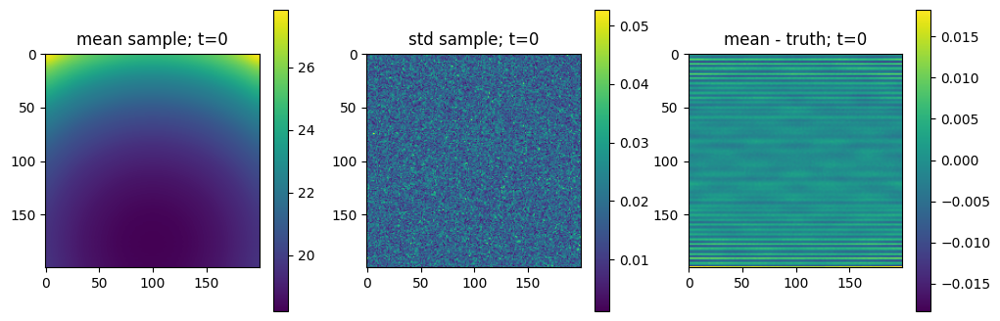

OPTIMIZE_KL: Starting 0079
SL: Iteration 0 ⛰:+1.9047e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+5.8414e+12 Δ⛰:1.8463e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.1755e+11 Δ⛰:5.4239e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.9798e+11 Δ⛰:1.9564e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.9647e+11 Δ⛰:1.5157e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.8261e+11 Δ⛰:1.3856e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.6810e+11 Δ⛰:1.4507e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.5708e+11 Δ⛰:1.1028e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.5708e+11 Δ⛰:1.1318e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.5696e+11 Δ⛰:1.1481e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.4480e+11 Δ⛰:1.2163e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.3306e+11 Δ⛰:1.1741e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.3305e+11 Δ⛰:5.5576e+06 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.2153e+11 Δ⛰:1.1522e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.1982e+11 Δ⛰:1.7144e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.1979e+11 Δ⛰:2.1759e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.1979e+11 Δ⛰:1.2244e+05 ➽:1.2000e+02
SL: 

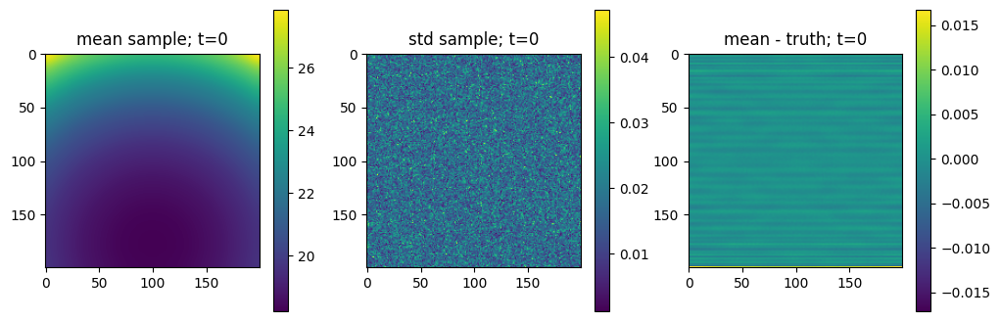

OPTIMIZE_KL: Starting 0080
SL: Iteration 0 ⛰:+9.0285e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.4010e+13 Δ⛰:8.8883e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.2743e+11 Δ⛰:1.3583e+13 ➽:1.2000e+02
SL: Iteration 3 ⛰:+4.0427e+11 Δ⛰:2.3163e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.8656e+11 Δ⛰:1.7702e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.8542e+11 Δ⛰:1.1427e+09 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.6982e+11 Δ⛰:1.5604e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.5915e+11 Δ⛰:1.0673e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.5610e+11 Δ⛰:3.0412e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.5604e+11 Δ⛰:6.5606e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.4297e+11 Δ⛰:1.3073e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.3024e+11 Δ⛰:1.2724e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.3024e+11 Δ⛰:7.4070e+03 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.2036e+11 Δ⛰:9.8818e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.2014e+11 Δ⛰:2.2428e+08 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.1900e+11 Δ⛰:1.1350e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.1900e+11 Δ⛰:1.9550e+04 ➽:1.2000e+02
SL: 

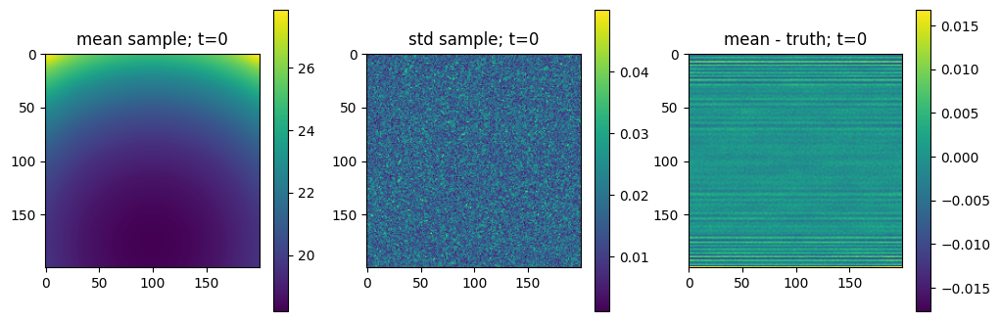

OPTIMIZE_KL: Starting 0081
SL: Iteration 0 ⛰:+4.1945e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.0138e+12 Δ⛰:4.1844e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.2267e+11 Δ⛰:5.9112e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.8475e+11 Δ⛰:3.7921e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.7382e+11 Δ⛰:1.0927e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.6147e+11 Δ⛰:1.2347e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.4783e+11 Δ⛰:1.3640e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.3618e+11 Δ⛰:1.1657e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.3618e+11 Δ⛰:1.6971e+05 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.3617e+11 Δ⛰:1.0562e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.2353e+11 Δ⛰:1.2631e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.1393e+11 Δ⛰:9.6010e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.1393e+11 Δ⛰:2.9332e+06 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.0431e+11 Δ⛰:9.6207e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.0226e+11 Δ⛰:2.0445e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.0226e+11 Δ⛰:2.9579e+05 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.0197e+11 Δ⛰:2.9041e+08 ➽:1.2000e+02
SL: 

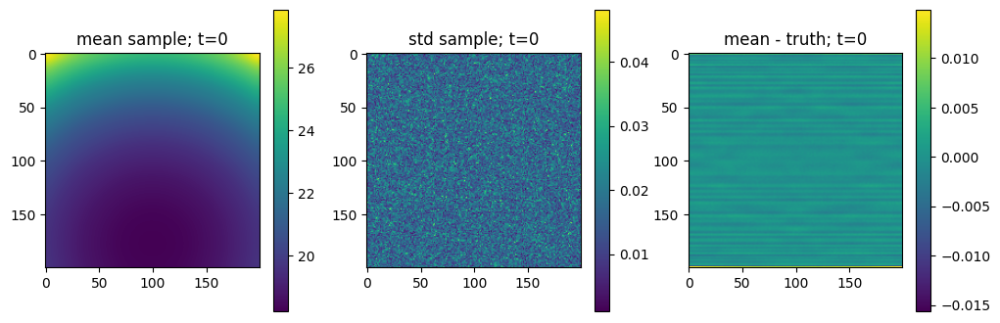

OPTIMIZE_KL: Starting 0082
SL: Iteration 0 ⛰:+4.2005e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+9.7749e+12 Δ⛰:4.1027e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+4.2096e+11 Δ⛰:9.3540e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.9039e+11 Δ⛰:3.0566e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.7835e+11 Δ⛰:1.2047e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.6816e+11 Δ⛰:1.0185e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.4978e+11 Δ⛰:1.8383e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.3645e+11 Δ⛰:1.3330e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.3627e+11 Δ⛰:1.8225e+08 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.3618e+11 Δ⛰:9.0589e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.2365e+11 Δ⛰:1.2527e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.1223e+11 Δ⛰:1.1414e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.1223e+11 Δ⛰:9.0948e+03 ➽:1.2000e+02
SL: Iteration 13 ⛰:+3.0382e+11 Δ⛰:8.4161e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+3.0145e+11 Δ⛰:2.3703e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+3.0141e+11 Δ⛰:4.3192e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+3.0141e+11 Δ⛰:6.5187e+03 ➽:1.2000e+02
SL: 

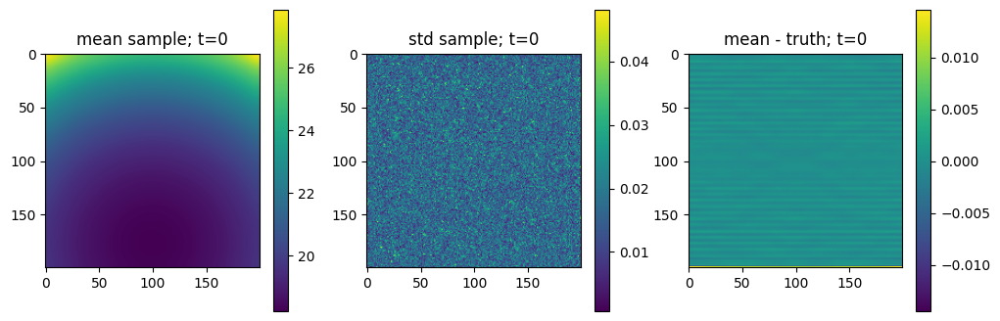

OPTIMIZE_KL: Starting 0083
SL: Iteration 0 ⛰:+5.2809e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+3.6146e+12 Δ⛰:5.2447e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.8496e+11 Δ⛰:3.2296e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.7046e+11 Δ⛰:1.4499e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.6667e+11 Δ⛰:3.7959e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.5554e+11 Δ⛰:1.1124e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.3919e+11 Δ⛰:1.6348e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+3.3252e+11 Δ⛰:6.6735e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+3.3219e+11 Δ⛰:3.2623e+08 ➽:1.2000e+02
SL: Iteration 9 ⛰:+3.3049e+11 Δ⛰:1.7027e+09 ➽:1.2000e+02
SL: Iteration 10 ⛰:+3.1927e+11 Δ⛰:1.1223e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+3.0880e+11 Δ⛰:1.0467e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+3.0880e+11 Δ⛰:1.2083e+06 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.9877e+11 Δ⛰:1.0035e+10 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.9831e+11 Δ⛰:4.5523e+08 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.9725e+11 Δ⛰:1.0645e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.9724e+11 Δ⛰:1.1378e+06 ➽:1.2000e+02
SL: 

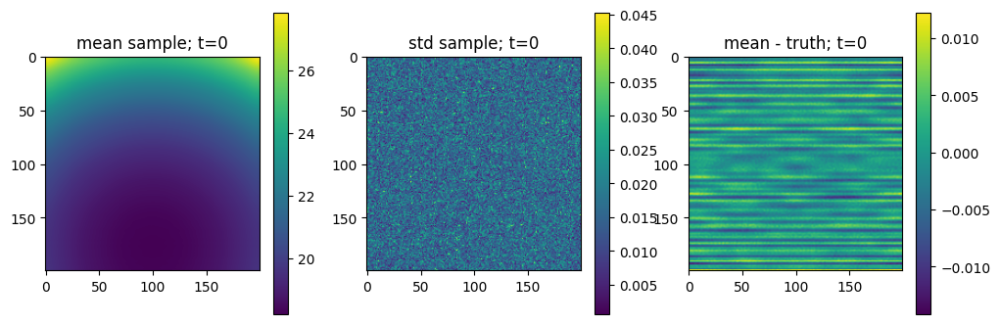

OPTIMIZE_KL: Starting 0084
SL: Iteration 0 ⛰:+1.0465e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+5.0888e+11 Δ⛰:1.0414e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.5504e+11 Δ⛰:1.5384e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.3808e+11 Δ⛰:1.6956e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.3506e+11 Δ⛰:3.0284e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.1849e+11 Δ⛰:1.6566e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.0548e+11 Δ⛰:1.3013e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.9717e+11 Δ⛰:8.3034e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.9717e+11 Δ⛰:4.9052e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.9669e+11 Δ⛰:4.8104e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.8718e+11 Δ⛰:9.5051e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.7802e+11 Δ⛰:9.1592e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.7802e+11 Δ⛰:6.5491e+06 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.6965e+11 Δ⛰:8.3678e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.6894e+11 Δ⛰:7.0507e+08 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.6831e+11 Δ⛰:6.3719e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.6831e+11 Δ⛰:6.2843e+05 ➽:1.2000e+02
SL: 

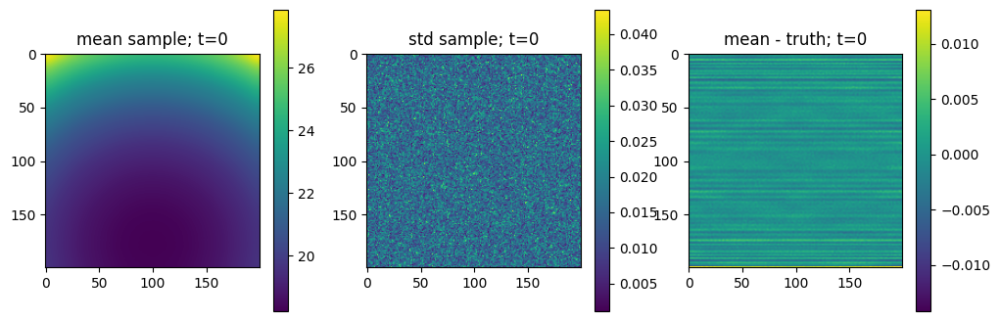

OPTIMIZE_KL: Starting 0085
SL: Iteration 0 ⛰:+2.0814e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+8.5524e+11 Δ⛰:2.0729e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.4972e+11 Δ⛰:5.0552e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.3445e+11 Δ⛰:1.5271e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.3264e+11 Δ⛰:1.8111e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.1748e+11 Δ⛰:1.5153e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.0617e+11 Δ⛰:1.1318e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.9661e+11 Δ⛰:9.5526e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.9661e+11 Δ⛰:7.9851e+04 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.9660e+11 Δ⛰:8.4919e+06 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.8461e+11 Δ⛰:1.1991e+10 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.7590e+11 Δ⛰:8.7115e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.7590e+11 Δ⛰:2.9095e+04 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.6744e+11 Δ⛰:8.4572e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.6619e+11 Δ⛰:1.2497e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.6619e+11 Δ⛰:9.8839e+06 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.6619e+11 Δ⛰:1.1299e+04 ➽:1.2000e+02
SL: 

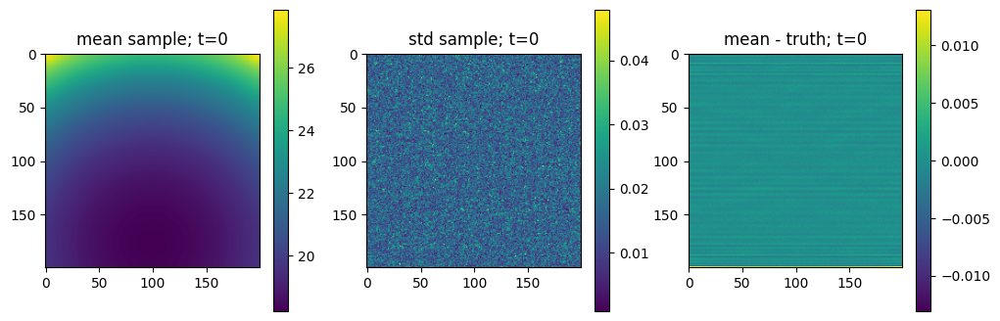

OPTIMIZE_KL: Starting 0086
SL: Iteration 0 ⛰:+1.2769e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+4.4130e+12 Δ⛰:1.2724e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.4686e+11 Δ⛰:4.0661e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.3636e+11 Δ⛰:1.0501e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.3605e+11 Δ⛰:3.1071e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.1625e+11 Δ⛰:1.9801e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+3.0178e+11 Δ⛰:1.4468e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.9907e+11 Δ⛰:2.7152e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.9905e+11 Δ⛰:1.7053e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.9365e+11 Δ⛰:5.4027e+09 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.8606e+11 Δ⛰:7.5846e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.7607e+11 Δ⛰:9.9960e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.7515e+11 Δ⛰:9.1358e+08 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.6666e+11 Δ⛰:8.4947e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.6661e+11 Δ⛰:4.8099e+07 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.6644e+11 Δ⛰:1.7292e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.6080e+11 Δ⛰:5.6390e+09 ➽:1.2000e+02
SL: 

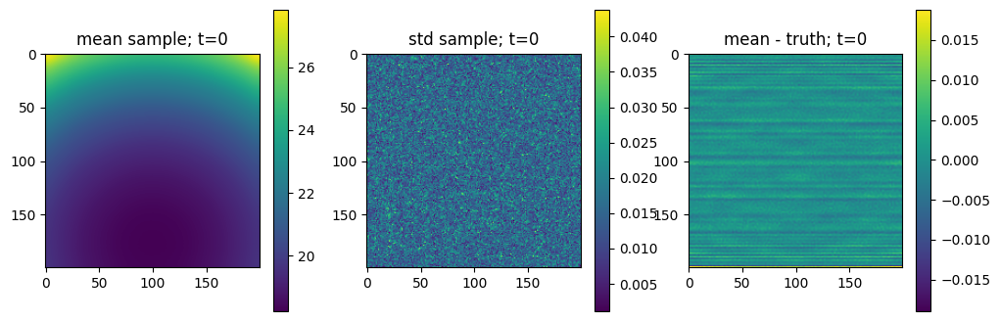

OPTIMIZE_KL: Starting 0087
SL: Iteration 0 ⛰:+3.5074e+12 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.3387e+12 Δ⛰:2.1686e+12 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.2815e+11 Δ⛰:1.0106e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.1844e+11 Δ⛰:9.7077e+09 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.0372e+11 Δ⛰:1.4725e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.0193e+11 Δ⛰:1.7818e+09 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.9136e+11 Δ⛰:1.0573e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.8102e+11 Δ⛰:1.0340e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.8094e+11 Δ⛰:8.1877e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.8086e+11 Δ⛰:7.6609e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.7185e+11 Δ⛰:9.0119e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.6181e+11 Δ⛰:1.0045e+10 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.6181e+11 Δ⛰:6.1098e+03 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.5366e+11 Δ⛰:8.1474e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.5276e+11 Δ⛰:8.9967e+08 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.5252e+11 Δ⛰:2.3812e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.5252e+11 Δ⛰:7.0088e+04 ➽:1.2000e+02
SL: 

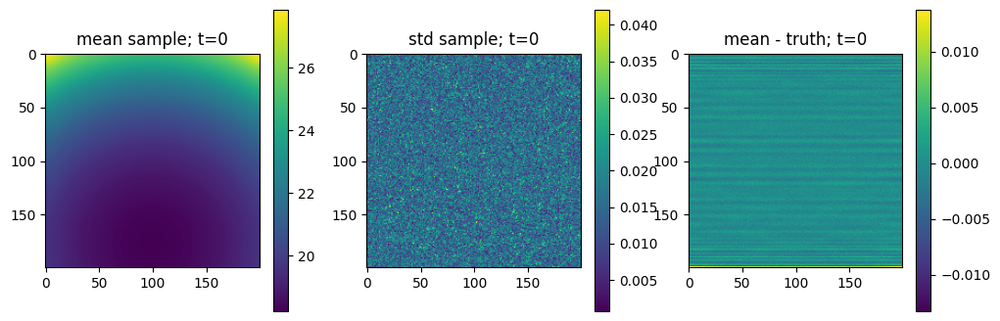

OPTIMIZE_KL: Starting 0088
SL: Iteration 0 ⛰:+2.1670e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+9.7925e+11 Δ⛰:2.1660e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.5236e+11 Δ⛰:6.2689e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.2156e+11 Δ⛰:3.0797e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.2153e+11 Δ⛰:3.1084e+07 ➽:1.2000e+02
SL: Iteration 5 ⛰:+3.0288e+11 Δ⛰:1.8651e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.9075e+11 Δ⛰:1.2131e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.8067e+11 Δ⛰:1.0078e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.8066e+11 Δ⛰:1.6638e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.8036e+11 Δ⛰:2.9971e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.7050e+11 Δ⛰:9.8572e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.6153e+11 Δ⛰:8.9709e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.6151e+11 Δ⛰:2.2345e+07 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.5385e+11 Δ⛰:7.6569e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.5244e+11 Δ⛰:1.4088e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.5240e+11 Δ⛰:4.2756e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.5240e+11 Δ⛰:9.3778e+05 ➽:1.2000e+02
SL: 

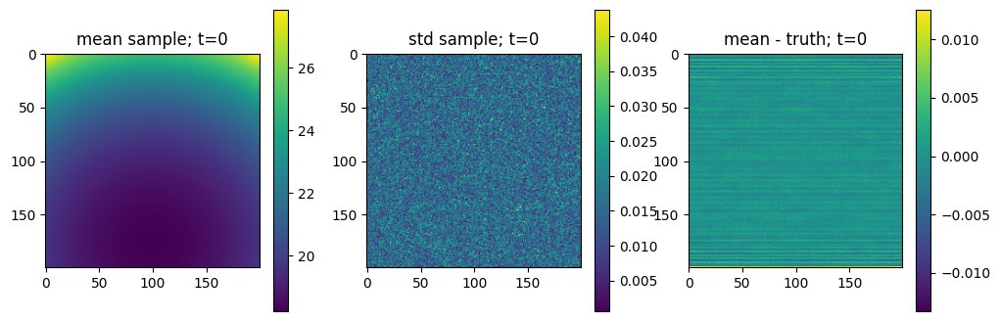

OPTIMIZE_KL: Starting 0089
SL: Iteration 0 ⛰:+1.1964e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.4456e+12 Δ⛰:1.1949e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.2456e+11 Δ⛰:1.1211e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.1293e+11 Δ⛰:1.1635e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.1264e+11 Δ⛰:2.9149e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.9413e+11 Δ⛰:1.8507e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.8374e+11 Δ⛰:1.0395e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.7472e+11 Δ⛰:9.0193e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.7471e+11 Δ⛰:3.1352e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.7449e+11 Δ⛰:2.2541e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.6499e+11 Δ⛰:9.4960e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.5610e+11 Δ⛰:8.8959e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.5610e+11 Δ⛰:1.1152e+05 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.4822e+11 Δ⛰:7.8794e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.4720e+11 Δ⛰:1.0193e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.4717e+11 Δ⛰:3.2129e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.4717e+11 Δ⛰:5.3314e+03 ➽:1.2000e+02
SL: 

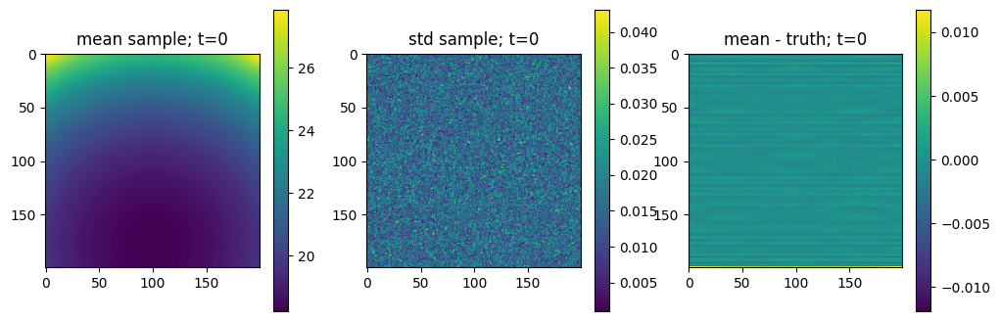

OPTIMIZE_KL: Starting 0090
SL: Iteration 0 ⛰:+4.4068e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+3.4828e+11 Δ⛰:4.4065e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.4126e+11 Δ⛰:7.0220e+09 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.1306e+11 Δ⛰:2.8190e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+3.1304e+11 Δ⛰:2.8678e+07 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.9435e+11 Δ⛰:1.8686e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.8295e+11 Δ⛰:1.1402e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.7296e+11 Δ⛰:9.9863e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.7296e+11 Δ⛰:2.3196e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.7292e+11 Δ⛰:3.5227e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.6479e+11 Δ⛰:8.1310e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.5644e+11 Δ⛰:8.3568e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.5643e+11 Δ⛰:6.6802e+06 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.4812e+11 Δ⛰:8.3056e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.4718e+11 Δ⛰:9.4500e+08 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.4710e+11 Δ⛰:7.5408e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.4710e+11 Δ⛰:9.6883e+05 ➽:1.2000e+02
SL: 

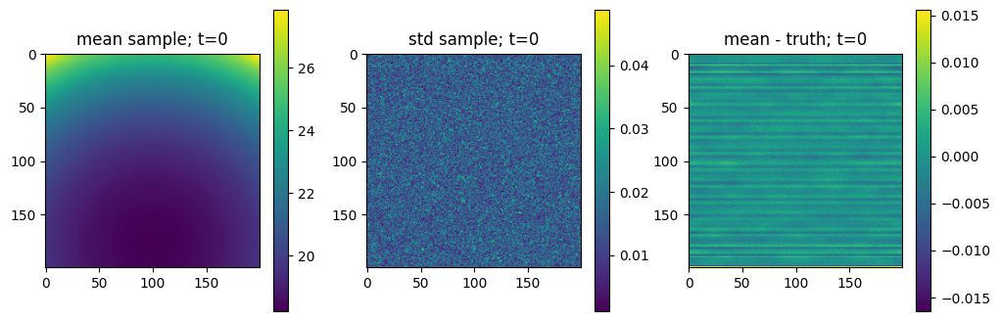

OPTIMIZE_KL: Starting 0091
SL: Iteration 0 ⛰:+8.9605e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+8.1977e+11 Δ⛰:8.9523e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.2375e+11 Δ⛰:4.9602e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.9806e+11 Δ⛰:2.5688e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.9791e+11 Δ⛰:1.5258e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.8239e+11 Δ⛰:1.5522e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.7210e+11 Δ⛰:1.0292e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.6209e+11 Δ⛰:1.0010e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.6209e+11 Δ⛰:8.1691e+05 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.6205e+11 Δ⛰:4.0284e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.5265e+11 Δ⛰:9.3989e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.4414e+11 Δ⛰:8.5109e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.4413e+11 Δ⛰:2.5015e+06 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.3693e+11 Δ⛰:7.2014e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.3588e+11 Δ⛰:1.0525e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.3583e+11 Δ⛰:4.9210e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.3583e+11 Δ⛰:9.7211e+05 ➽:1.2000e+02
SL: 

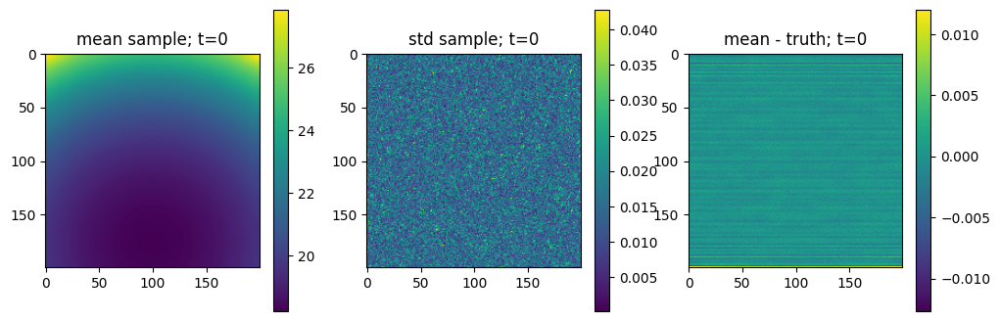

OPTIMIZE_KL: Starting 0092
SL: Iteration 0 ⛰:+9.3220e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.6754e+13 Δ⛰:9.1544e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.2598e+11 Δ⛰:1.6428e+13 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.0096e+11 Δ⛰:2.5022e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.9470e+11 Δ⛰:6.2599e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.8582e+11 Δ⛰:8.8768e+09 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.7313e+11 Δ⛰:1.2693e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.7092e+11 Δ⛰:2.2081e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.6466e+11 Δ⛰:6.2560e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.6266e+11 Δ⛰:2.0026e+09 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.5366e+11 Δ⛰:8.9996e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.4505e+11 Δ⛰:8.6134e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.4505e+11 Δ⛰:1.6037e+05 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.3665e+11 Δ⛰:8.3931e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.3665e+11 Δ⛰:1.8188e+06 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.3400e+11 Δ⛰:2.6564e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.3399e+11 Δ⛰:1.3190e+06 ➽:1.2000e+02
SL: 

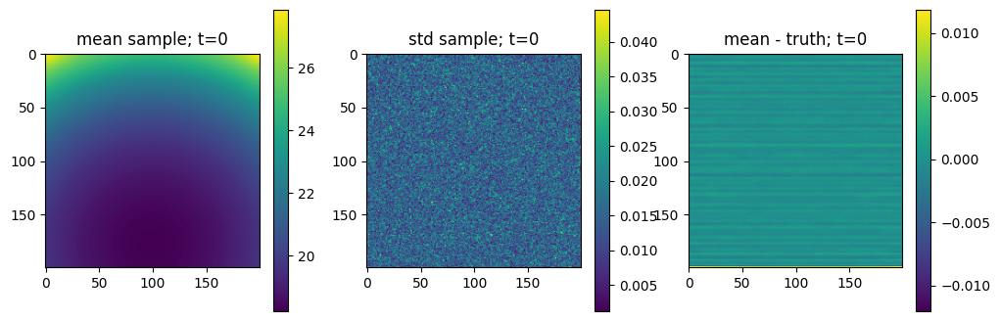

OPTIMIZE_KL: Starting 0093
SL: Iteration 0 ⛰:+6.8402e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+5.2484e+12 Δ⛰:6.3153e+13 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.1735e+11 Δ⛰:4.9310e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+3.0014e+11 Δ⛰:1.7201e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.9715e+11 Δ⛰:2.9952e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.8520e+11 Δ⛰:1.1948e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.7266e+11 Δ⛰:1.2543e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.6161e+11 Δ⛰:1.1043e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.6153e+11 Δ⛰:8.4135e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.6075e+11 Δ⛰:7.7983e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.5286e+11 Δ⛰:7.8923e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.4484e+11 Δ⛰:8.0215e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.4484e+11 Δ⛰:4.1720e+05 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.3675e+11 Δ⛰:8.0852e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.3651e+11 Δ⛰:2.4543e+08 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.3538e+11 Δ⛰:1.1244e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.3538e+11 Δ⛰:2.3225e+04 ➽:1.2000e+02
SL: 

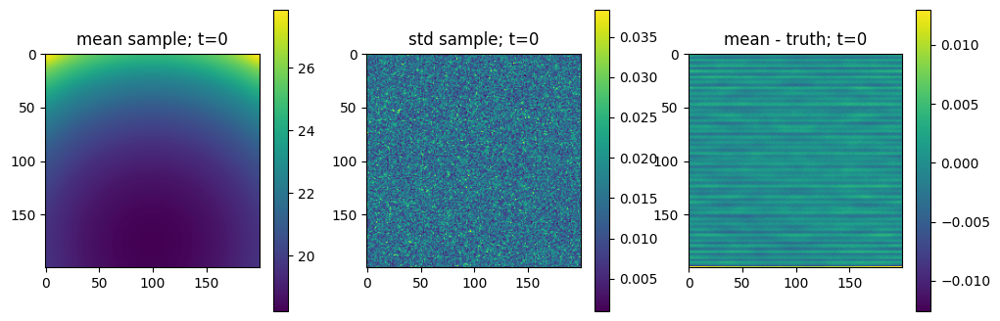

OPTIMIZE_KL: Starting 0094
SL: Iteration 0 ⛰:+2.4994e+13 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.2269e+13 Δ⛰:2.7257e+12 ➽:1.2000e+02
SL: Iteration 2 ⛰:+3.1971e+11 Δ⛰:2.1949e+13 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.9358e+11 Δ⛰:2.6125e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.7974e+11 Δ⛰:1.3844e+10 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.7663e+11 Δ⛰:3.1114e+09 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.6469e+11 Δ⛰:1.1937e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.5676e+11 Δ⛰:7.9282e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.5486e+11 Δ⛰:1.9039e+09 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.5459e+11 Δ⛰:2.7064e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.4559e+11 Δ⛰:8.9922e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.3699e+11 Δ⛰:8.6011e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.3699e+11 Δ⛰:3.4052e+04 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.3044e+11 Δ⛰:6.5560e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.2933e+11 Δ⛰:1.1107e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.2906e+11 Δ⛰:2.6151e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.2906e+11 Δ⛰:4.3102e+03 ➽:1.2000e+02
SL: 

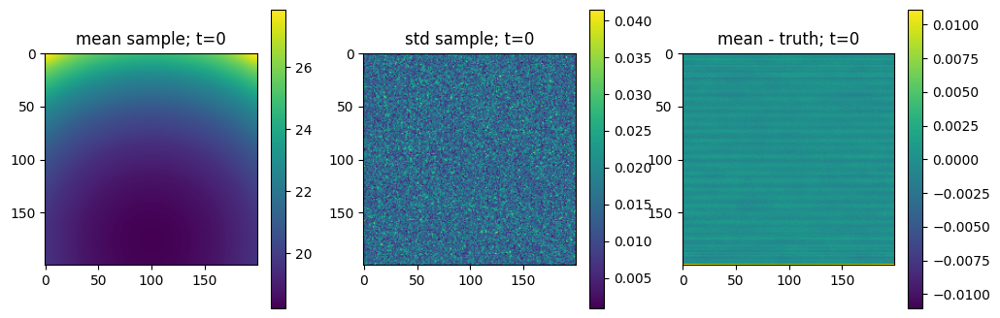

OPTIMIZE_KL: Starting 0095
SL: Iteration 0 ⛰:+2.6530e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+4.7371e+11 Δ⛰:2.6525e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+2.9904e+11 Δ⛰:1.7468e+11 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.8711e+11 Δ⛰:1.1928e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.8683e+11 Δ⛰:2.7440e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.7526e+11 Δ⛰:1.1575e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.6387e+11 Δ⛰:1.1389e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.5399e+11 Δ⛰:9.8744e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.5399e+11 Δ⛰:5.7267e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.5382e+11 Δ⛰:1.6400e+08 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.4433e+11 Δ⛰:9.4898e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.3689e+11 Δ⛰:7.4411e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.3670e+11 Δ⛰:1.9248e+08 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.2960e+11 Δ⛰:7.0977e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.2493e+11 Δ⛰:4.6744e+09 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.2493e+11 Δ⛰:8.3902e+04 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.2492e+11 Δ⛰:6.1821e+06 ➽:1.2000e+02
SL: 

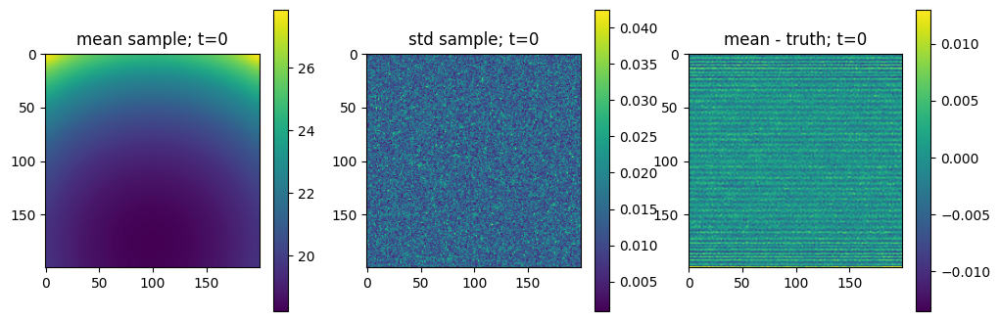

OPTIMIZE_KL: Starting 0096
SL: Iteration 0 ⛰:+4.5466e+15 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.4639e+13 Δ⛰:4.5320e+15 ➽:1.2000e+02
SL: Iteration 2 ⛰:+2.8465e+11 Δ⛰:1.4354e+13 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.6943e+11 Δ⛰:1.5219e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.6941e+11 Δ⛰:2.1162e+07 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.5491e+11 Δ⛰:1.4505e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.4531e+11 Δ⛰:9.5919e+09 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.4381e+11 Δ⛰:1.5027e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.4287e+11 Δ⛰:9.4234e+08 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.3697e+11 Δ⛰:5.9030e+09 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.2697e+11 Δ⛰:9.9991e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.1910e+11 Δ⛰:7.8698e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.1910e+11 Δ⛰:1.4365e+04 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.1258e+11 Δ⛰:6.5220e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.1256e+11 Δ⛰:1.0501e+07 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.1097e+11 Δ⛰:1.5987e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.1097e+11 Δ⛰:2.7545e+03 ➽:1.2000e+02
SL: 

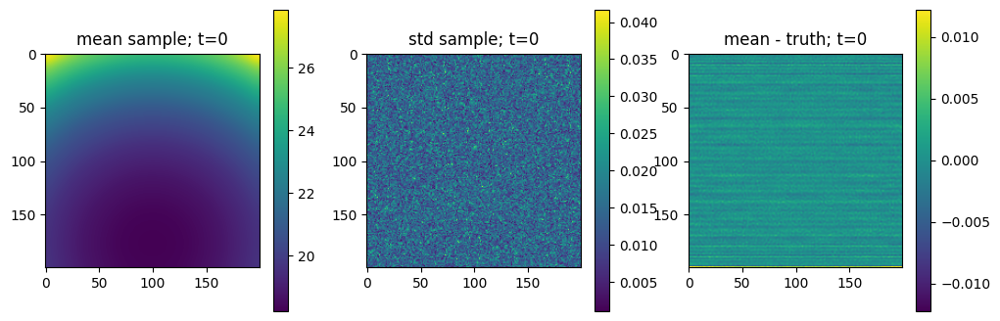

OPTIMIZE_KL: Starting 0097
SL: Iteration 0 ⛰:+8.5510e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+1.3504e+12 Δ⛰:8.5375e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+2.7801e+11 Δ⛰:1.0724e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.6830e+11 Δ⛰:9.7070e+09 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.6826e+11 Δ⛰:4.6151e+07 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.5504e+11 Δ⛰:1.3218e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.4475e+11 Δ⛰:1.0289e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.3885e+11 Δ⛰:5.8951e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.3883e+11 Δ⛰:2.0294e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.3578e+11 Δ⛰:3.0506e+09 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.2729e+11 Δ⛰:8.4908e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.1922e+11 Δ⛰:8.0707e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.1921e+11 Δ⛰:9.7784e+06 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.1263e+11 Δ⛰:6.5790e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.1262e+11 Δ⛰:9.5377e+06 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.1160e+11 Δ⛰:1.0246e+09 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.1160e+11 Δ⛰:8.6086e+03 ➽:1.2000e+02
SL: 

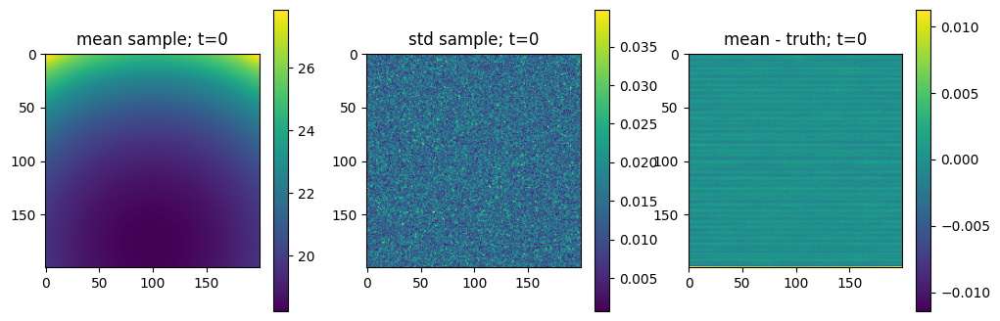

OPTIMIZE_KL: Starting 0098
SL: Iteration 0 ⛰:+3.0179e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+2.8002e+11 Δ⛰:3.0151e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+2.7472e+11 Δ⛰:5.2997e+09 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.6575e+11 Δ⛰:8.9710e+09 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.6564e+11 Δ⛰:1.1326e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.5241e+11 Δ⛰:1.3233e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.4143e+11 Δ⛰:1.0976e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.3324e+11 Δ⛰:8.1941e+09 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.3323e+11 Δ⛰:3.4277e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.3323e+11 Δ⛰:4.4530e+06 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.2542e+11 Δ⛰:7.8105e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.1776e+11 Δ⛰:7.6553e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.1776e+11 Δ⛰:1.2358e+06 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.1184e+11 Δ⛰:5.9226e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.1088e+11 Δ⛰:9.5547e+08 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.1088e+11 Δ⛰:2.4876e+06 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.1088e+11 Δ⛰:4.8502e+05 ➽:1.2000e+02
SL: 

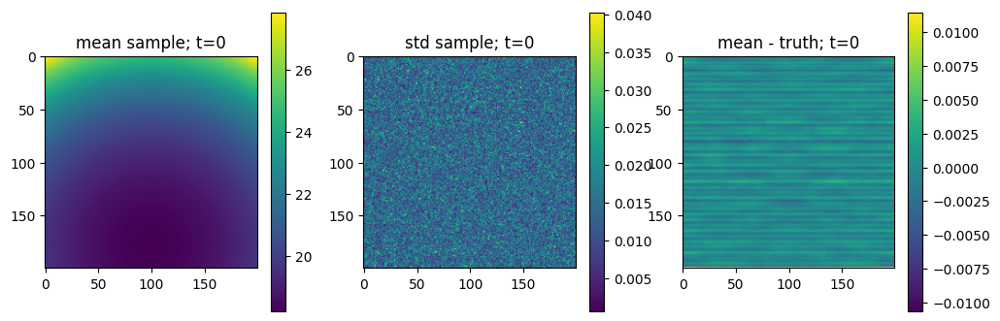

OPTIMIZE_KL: Starting 0099
SL: Iteration 0 ⛰:+2.6112e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+9.2830e+12 Δ⛰:2.5184e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+2.7322e+11 Δ⛰:9.0098e+12 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.6380e+11 Δ⛰:9.4227e+09 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.6356e+11 Δ⛰:2.3438e+08 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.4805e+11 Δ⛰:1.5511e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.3827e+11 Δ⛰:9.7833e+09 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.3746e+11 Δ⛰:8.0774e+08 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.3739e+11 Δ⛰:6.7814e+07 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.2998e+11 Δ⛰:7.4081e+09 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.2279e+11 Δ⛰:7.1949e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.1494e+11 Δ⛰:7.8532e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.1493e+11 Δ⛰:1.0393e+07 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.0760e+11 Δ⛰:7.3294e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.0716e+11 Δ⛰:4.3988e+08 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.0665e+11 Δ⛰:5.0906e+08 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.0665e+11 Δ⛰:1.5798e+06 ➽:1.2000e+02
SL: 

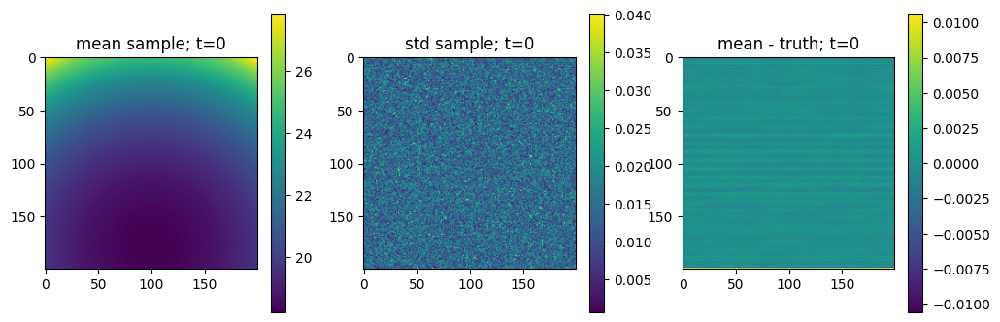

OPTIMIZE_KL: Starting 0100
SL: Iteration 0 ⛰:+6.3651e+14 Δ⛰:inf ➽:1.2000e+02
SL: Iteration 1 ⛰:+3.0880e+11 Δ⛰:6.3621e+14 ➽:1.2000e+02
SL: Iteration 2 ⛰:+2.8411e+11 Δ⛰:2.4687e+10 ➽:1.2000e+02
SL: Iteration 3 ⛰:+2.6803e+11 Δ⛰:1.6081e+10 ➽:1.2000e+02
SL: Iteration 4 ⛰:+2.6702e+11 Δ⛰:1.0138e+09 ➽:1.2000e+02
SL: Iteration 5 ⛰:+2.5312e+11 Δ⛰:1.3902e+10 ➽:1.2000e+02
SL: Iteration 6 ⛰:+2.4197e+11 Δ⛰:1.1147e+10 ➽:1.2000e+02
SL: Iteration 7 ⛰:+2.3126e+11 Δ⛰:1.0704e+10 ➽:1.2000e+02
SL: Iteration 8 ⛰:+2.3126e+11 Δ⛰:1.4623e+06 ➽:1.2000e+02
SL: Iteration 9 ⛰:+2.3124e+11 Δ⛰:2.3907e+07 ➽:1.2000e+02
SL: Iteration 10 ⛰:+2.2314e+11 Δ⛰:8.0992e+09 ➽:1.2000e+02
SL: Iteration 11 ⛰:+2.1566e+11 Δ⛰:7.4816e+09 ➽:1.2000e+02
SL: Iteration 12 ⛰:+2.1563e+11 Δ⛰:2.4961e+07 ➽:1.2000e+02
SL: Iteration 13 ⛰:+2.0824e+11 Δ⛰:7.3971e+09 ➽:1.2000e+02
SL: Iteration 14 ⛰:+2.0738e+11 Δ⛰:8.5534e+08 ➽:1.2000e+02
SL: Iteration 15 ⛰:+2.0729e+11 Δ⛰:9.5825e+07 ➽:1.2000e+02
SL: Iteration 16 ⛰:+2.0728e+11 Δ⛰:5.4973e+06 ➽:1.2000e+02
SL: 

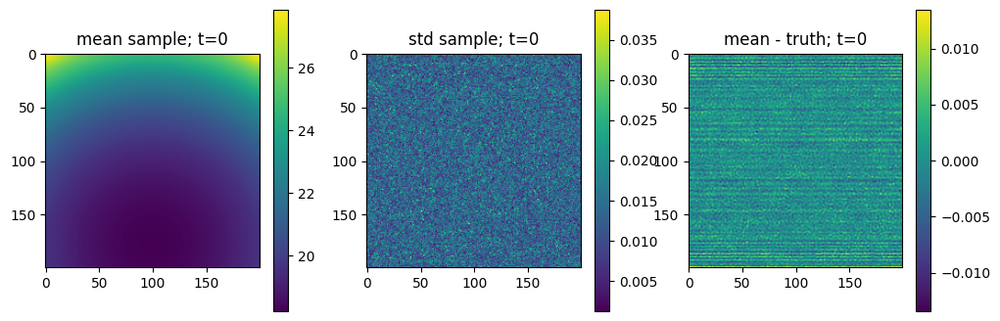

In [15]:
# n_it = 4
# n_it = 20
n_it = 100
delta = 1e-4 # default
n_samples = 4 # no samples -> maximum aposteriory posterior

key, k_i, k_o = random.split(key, 3)

# callback fn for plotting during optimisation:
def callback(samples, opt_state):
    mean, std = jft.mean_and_std(tuple(gp_atmos(s) for s in samples))
    
    fig, axes = plt.subplots(1, 3, figsize=(12, 4))

    im0 = axes[0].imshow(mean[:,:,0])
    axes[0].title.set_text('mean sample; t=0')
    fig.colorbar(im0)

    im1 = axes[1].imshow(std[:,:,0])
    axes[1].title.set_text('std sample; t=0')
    fig.colorbar(im1)
    
    im2 = axes[2].imshow(mean[:,:,0] - indata[:,:,0])
    axes[2].title.set_text('mean - truth; t=0')
    fig.colorbar(im2)
    
    plt.show()

samples, state = jft.optimize_kl(
    lh, # likelihood
    jft.Vector(lh.init(k_i)), # initial position in model space (initialisation)
    n_total_iterations=n_it, # no of optimisation steps (global)
    n_samples=n_samples, # draw samples
    key=k_o, # random jax init
    draw_linear_kwargs=dict( # sampling parameters
        cg_name="SL",
        cg_kwargs=dict(absdelta=delta * jft.size(lh.domain) / 10.0, maxiter=60),
        # cg_kwargs=dict(absdelta=delta * jft.size(lh.domain) / 10.0, maxiter=20),
    ),
    nonlinearly_update_kwargs=dict( # map from multivariate gaussian to more compl. distribution (coordinate transformations)
        minimize_kwargs=dict(
            name="SN",
            xtol=delta,
            cg_kwargs=dict(name=None),
            maxiter=5,
        )
    ),
    kl_kwargs=dict( # shift transformed multivar gauss to best match true posterior
        minimize_kwargs=dict(
            name="M", xtol=delta, cg_kwargs=dict(name=None), maxiter=60
            # name="M", xtol=delta, cg_kwargs=dict(name=None), maxiter=20
        )
    ),
    sample_mode="nonlinear_resample", # how steps are combined (samples + nonlin + KL)
    callback=callback,
)

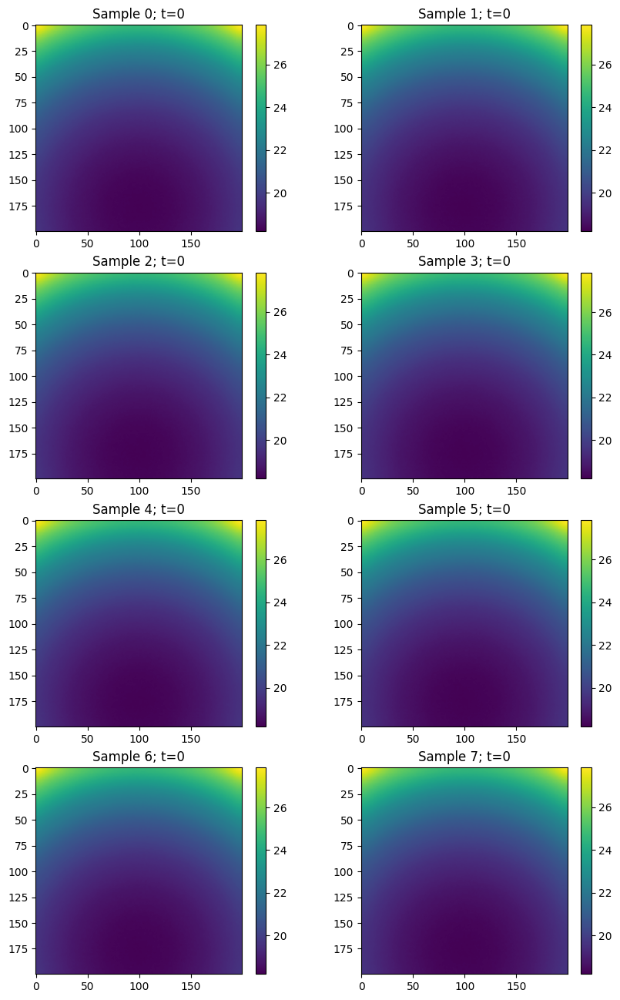

In [16]:
# plot all samples
fig, axes = plt.subplots(4, 2, figsize=(10, 16))

i = 0
for s in samples:
    # print(i//4, i%4)
    # im = axes[i//4][i%4].imshow(signal_response(s))
    im = axes[i//2][i%2].imshow(gp_atmos(s)[:,:,0])
    axes[i//2][i%2].title.set_text(f"Sample {i}; t=0")
    fig.colorbar(im)
    
    i += 1

plt.show()

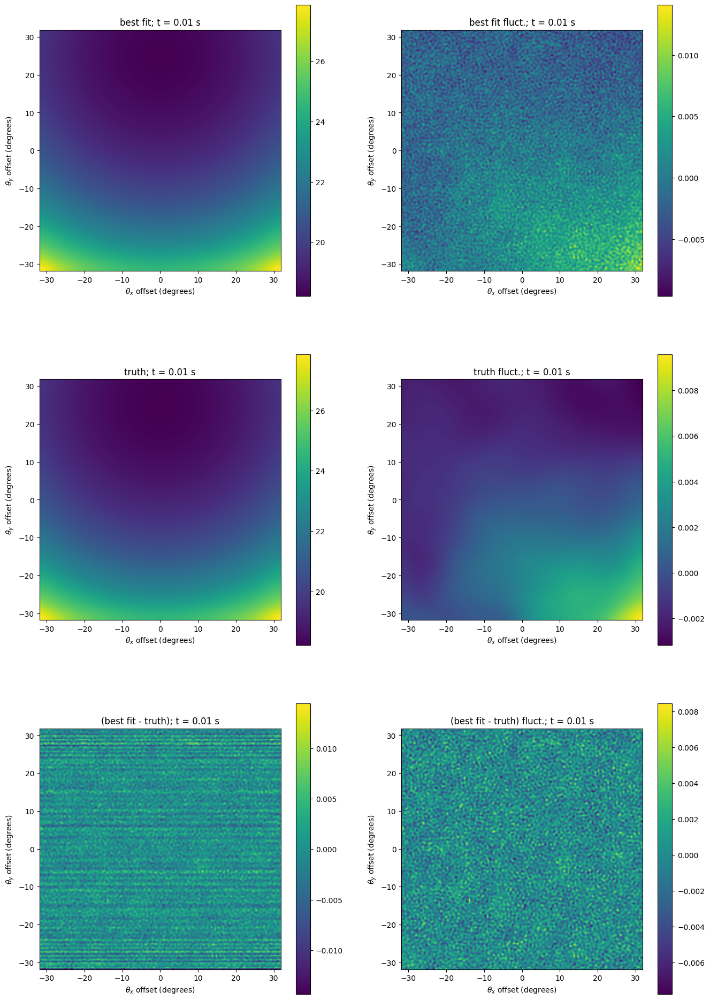

In [17]:
sig_map = gp_atmos(samples.pos) # when splitting up in different field models
mean, std = jft.mean_and_std(tuple(gp_atmos(s) for s in samples))

def plotgp(fig, axes, timestep):
    
    im0, im1 = plot_time(axes[0], sig_map, addtext='best fit', timestep=timestep)
    fig.colorbar(im0)
    fig.colorbar(im1)
    
    im2, im3 = plot_time(axes[1], indata, addtext='truth', timestep=timestep)
    fig.colorbar(im2)
    fig.colorbar(im3)
    
    # im4, im5 = plot_time(axes[2], (sig_map - indata)/std, addtext='(best fit - truth)/stdev', timestep=timestep)
    im4, im5 = plot_time(axes[2], (sig_map - indata), addtext='(best fit - truth)', timestep=timestep)
    fig.colorbar(im4)
    fig.colorbar(im5)
    
    return fig

fig, axes = plt.subplots(3, 2, figsize=(2*8, 3*8))    
plotgp(fig, axes, 1)
plt.show()

In [18]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
import io

# Generate and capture individual frames
# num_frames = data.shape[0]
# num_frames = 1000
# nskip = 10
num_frames = numsteps
nskip = 1

print("num_frames", num_frames)

def makegif_nifty():
    # Create a list to hold the frames
    frames = []

    for i in range(0, num_frames, nskip):
        print(f"Making plot for timestep: {i} out of {num_frames} ({i/num_frames*100:.2f} %)")
        
        fig, axes = plt.subplots(3, 2, figsize=(2*8, 3*8))    
        plotgp(fig, axes, timestep=i)
        
        # Capture the plot as an image in memory
        buf = io.BytesIO()
        plt.savefig(buf, format='png')
        plt.close(fig)
        
        # Create an image from the buffer
        buf.seek(0)
        img = Image.open(buf)
        frames.append(img)

    # Save the frames as a GIF
    # frames[0].save('testgif_atmosphere.gif', save_all=True, append_images=frames[1:], duration=1, loop=0)
    frames[0].save(f'atmosphere_nifty.gif', save_all=True, append_images=frames[1:], duration=1, loop=0, dpi="figure")
    
makegif_nifty()
plt.close()

num_frames 300
Making plot for timestep: 0 out of 300 (0.00 %)
Making plot for timestep: 1 out of 300 (0.33 %)
Making plot for timestep: 2 out of 300 (0.67 %)
Making plot for timestep: 3 out of 300 (1.00 %)
Making plot for timestep: 4 out of 300 (1.33 %)
Making plot for timestep: 5 out of 300 (1.67 %)
Making plot for timestep: 6 out of 300 (2.00 %)
Making plot for timestep: 7 out of 300 (2.33 %)
Making plot for timestep: 8 out of 300 (2.67 %)
Making plot for timestep: 9 out of 300 (3.00 %)
Making plot for timestep: 10 out of 300 (3.33 %)
Making plot for timestep: 11 out of 300 (3.67 %)
Making plot for timestep: 12 out of 300 (4.00 %)
Making plot for timestep: 13 out of 300 (4.33 %)
Making plot for timestep: 14 out of 300 (4.67 %)
Making plot for timestep: 15 out of 300 (5.00 %)
Making plot for timestep: 16 out of 300 (5.33 %)
Making plot for timestep: 17 out of 300 (5.67 %)
Making plot for timestep: 18 out of 300 (6.00 %)
Making plot for timestep: 19 out of 300 (6.33 %)
Making plot for

In [19]:
# from IPython.display import Image as IPImage, display

# display(IPImage(open('atmosphere_nifty.gif', 'rb').read()))